In [1]:
import numpy as np
import pandas as pd
import os
import sklearn
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
from sklearn.pipeline import make_pipeline
from sklearn.preprocessing import StandardScaler
from sklearn.ensemble import RandomForestRegressor

In [2]:
import torch

In [29]:
from  dilate.loss.dilate_loss import dilate_loss  

In [45]:
x = torch.rand((2,100))
y = torch.rand((2,100))
alpha=.5
gamma=.001
dilate_loss(inputs,target,alpha,gamma,'cpu')

(tensor(2.9654), tensor(2.6205), tensor(3.3103))

In [40]:
#x = next(iter(trainloader))
for i, data in enumerate(trainloader, 0):
    inputs, target, _ = data

In [43]:
target.shape

torch.Size([100, 20, 1])

In [7]:
import numpy as np
import torch
from dilate.data.synthetic_dataset import create_synthetic_dataset, SyntheticDataset
from dilate.models.seq2seq import EncoderRNN, DecoderRNN, Net_GRU
from dilate.loss.dilate_loss import dilate_loss
from torch.utils.data import DataLoader
import random
from tslearn.metrics import dtw, dtw_path
import matplotlib.pyplot as plt
import warnings
import warnings; warnings.simplefilter('ignore')

device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
random.seed(0)

# parameters
batch_size = 100
N = 500
N_input = 20
N_output = 20  
sigma = 0.01
gamma = 0.01

# Load synthetic dataset
X_train_input,X_train_target,X_test_input,X_test_target,train_bkp,test_bkp = create_synthetic_dataset(N,N_input,N_output,sigma)
dataset_train = SyntheticDataset(X_train_input,X_train_target, train_bkp)
dataset_test  = SyntheticDataset(X_test_input,X_test_target, test_bkp)
trainloader = DataLoader(dataset_train, batch_size=batch_size,shuffle=True, num_workers=0)
testloader  = DataLoader(dataset_test, batch_size=batch_size,shuffle=False, num_workers=0)


def train_model(net,loss_type, learning_rate, epochs=1000, gamma = 0.001,
                print_every=50,eval_every=50, verbose=1, Lambda=1, alpha=0.5):
    
    optimizer = torch.optim.Adam(net.parameters(),lr=learning_rate)
    criterion = torch.nn.MSELoss()
    
    for epoch in range(epochs): 
        for i, data in enumerate(trainloader, 0):
            inputs, target, _ = data
            inputs = torch.tensor(inputs, dtype=torch.float32).to(device)
            target = torch.tensor(target, dtype=torch.float32).to(device)
            batch_size, N_output = target.shape[0:2]                     

            # forward + backward + optimize
            outputs = net(inputs)
            loss_mse,loss_shape,loss_temporal = torch.tensor(0),torch.tensor(0),torch.tensor(0)
            
            if (loss_type=='mse'):
                loss_mse = criterion(target,outputs)
                loss = loss_mse                   
 
            if (loss_type=='dilate'):    
                loss, loss_shape, loss_temporal = dilate_loss(target,outputs,alpha, gamma, device)             
                  
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()          
        
        if(verbose):
            if (epoch % print_every == 0):
                print('epoch ', epoch, ' loss ',loss.item(),' loss shape ',loss_shape.item(),' loss temporal ',loss_temporal.item())
                eval_model(net,testloader, gamma,verbose=1)
  

def eval_model(net,loader, gamma,verbose=1):   
    criterion = torch.nn.MSELoss()
    losses_mse = []
    losses_dtw = []
    losses_tdi = []   

    for i, data in enumerate(loader, 0):
        loss_mse, loss_dtw, loss_tdi = torch.tensor(0),torch.tensor(0),torch.tensor(0)
        # get the inputs
        inputs, target, breakpoints = data
        inputs = torch.tensor(inputs, dtype=torch.float32).to(device)
        target = torch.tensor(target, dtype=torch.float32).to(device)
        batch_size, N_output = target.shape[0:2]
        outputs = net(inputs)
         
        # MSE    
        loss_mse = criterion(target,outputs)    
        loss_dtw, loss_tdi = 0,0
        # DTW and TDI
        for k in range(batch_size):         
            target_k_cpu = target[k,:,0:1].view(-1).detach().cpu().numpy()
            output_k_cpu = outputs[k,:,0:1].view(-1).detach().cpu().numpy()

            path, sim = dtw_path(target_k_cpu, output_k_cpu)   
            loss_dtw += sim
                       
            Dist = 0
            for i,j in path:
                    Dist += (i-j)*(i-j)
            loss_tdi += Dist / (N_output*N_output)            
                        
        loss_dtw = loss_dtw /batch_size
        loss_tdi = loss_tdi / batch_size

        # print statistics
        losses_mse.append( loss_mse.item() )
        losses_dtw.append( loss_dtw )
        losses_tdi.append( loss_tdi )

    print( ' Eval mse= ', np.array(losses_mse).mean() ,' dtw= ',np.array(losses_dtw).mean() ,' tdi= ', np.array(losses_tdi).mean()) 


encoder = EncoderRNN(input_size=1, hidden_size=128, num_grulstm_layers=1, batch_size=batch_size).to(device)
decoder = DecoderRNN(input_size=1, hidden_size=128, num_grulstm_layers=1,fc_units=16, output_size=1).to(device)
net_gru_dilate = Net_GRU(encoder,decoder, N_output, device).to(device)
train_model(net_gru_dilate,loss_type='dilate',learning_rate=0.001, epochs=500, gamma=gamma, print_every=50, eval_every=50,verbose=1)

encoder = EncoderRNN(input_size=1, hidden_size=128, num_grulstm_layers=1, batch_size=batch_size).to(device)
decoder = DecoderRNN(input_size=1, hidden_size=128, num_grulstm_layers=1,fc_units=16, output_size=1).to(device)
net_gru_mse = Net_GRU(encoder,decoder, N_output, device).to(device)
train_model(net_gru_mse,loss_type='mse',learning_rate=0.001, epochs=500, gamma=gamma, print_every=50, eval_every=50,verbose=1)

# Visualize results
gen_test = iter(testloader)
test_inputs, test_targets, breaks = next(gen_test)

test_inputs  = torch.tensor(test_inputs, dtype=torch.float32).to(device)
test_targets = torch.tensor(test_targets, dtype=torch.float32).to(device)
criterion = torch.nn.MSELoss()

nets = [net_gru_dilate]

for ind in range(1,51):
    plt.figure()
    plt.rcParams['figure.figsize'] = (17.0,5.0)  
    k = 1
    for net in nets:
        pred = net(test_inputs).to(device)

        input = test_inputs.detach().cpu().numpy()[ind,:,:]
        target = test_targets.detach().cpu().numpy()[ind,:,:]
        preds = pred.detach().cpu().numpy()[ind,:,:]

        plt.subplot(1,3,k)
        plt.plot(range(0,N_input) ,input,label='input',linewidth=3)
        plt.plot(range(N_input-1,N_input+N_output), np.concatenate([ input[N_input-1:N_input], target ]) ,label='target',linewidth=3)   
        plt.plot(range(N_input-1,N_input+N_output),  np.concatenate([ input[N_input-1:N_input], preds ])  ,label='prediction',linewidth=3)       
        plt.xticks(range(0,40,2))
        plt.legend()
        k = k+1

    plt.show()

epoch  0  loss  1.8527476787567139  loss shape  3.5726025104522705  loss temporal  0.13289274275302887
 Eval mse=  0.15936728417873383  dtw=  1.4821840964125608  tdi=  0.073795
epoch  50  loss  0.6560350656509399  loss shape  0.9695259928703308  loss temporal  0.3425441384315491
 Eval mse=  0.042363525927066804  dtw=  0.7200913318577269  tdi=  0.6668750000000001
epoch  100  loss  0.4346442222595215  loss shape  0.5625482201576233  loss temporal  0.3067402243614197
 Eval mse=  0.03311353921890259  dtw=  0.6094418397576478  tdi=  0.67309


KeyboardInterrupt: 

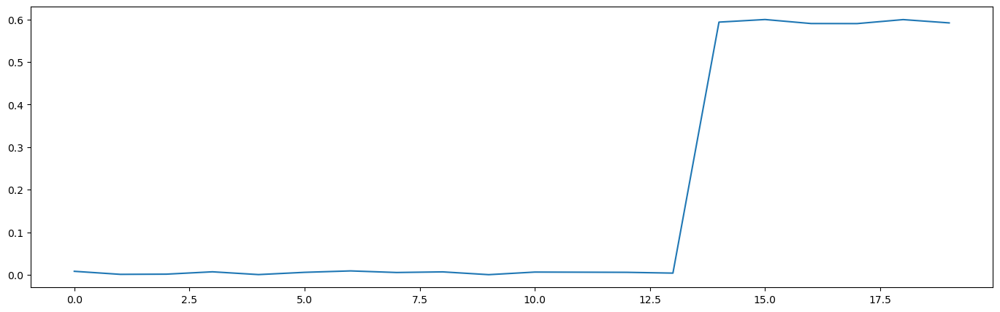

In [28]:
plt.plot(X_train_target[2,:])


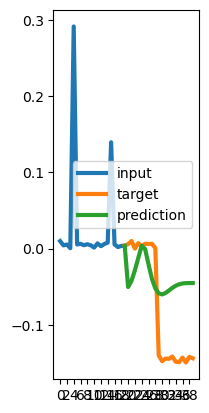

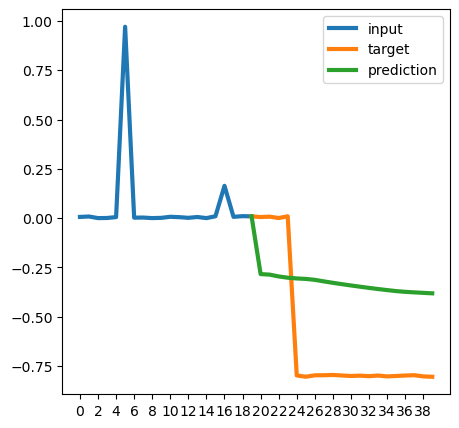

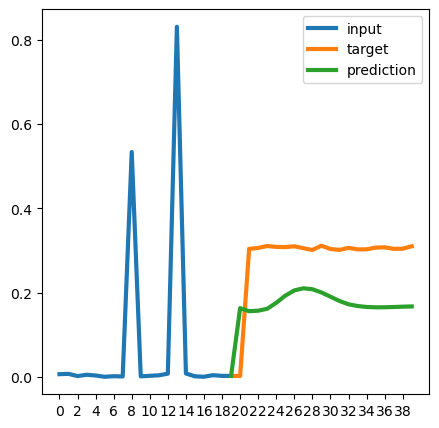

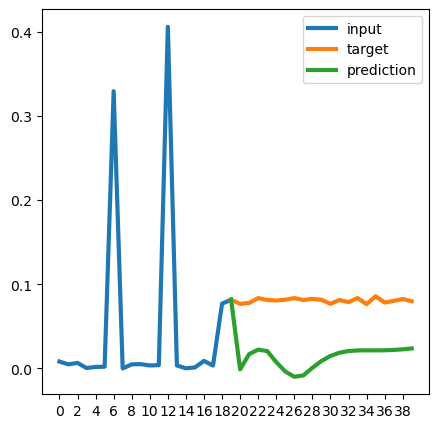

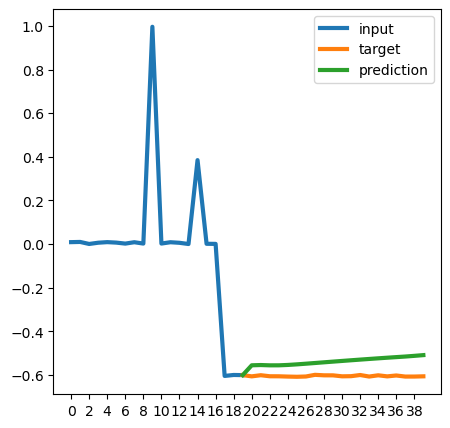

...

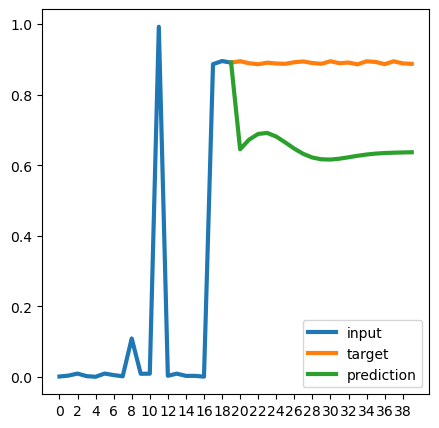

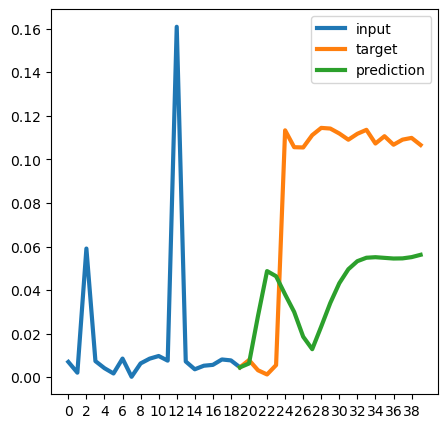

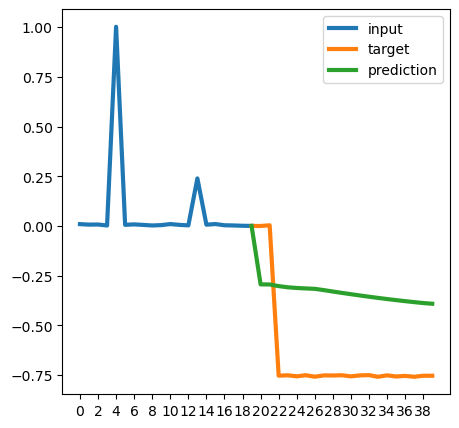

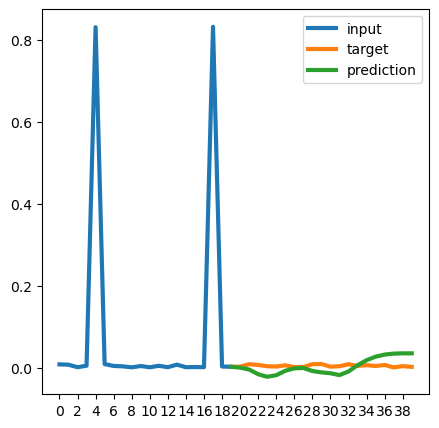

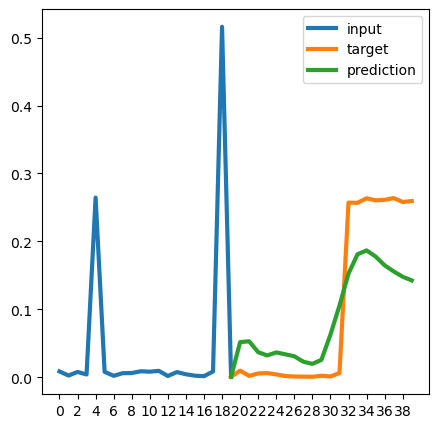

In [8]:
gen_test = iter(testloader)
test_inputs, test_targets, breaks = next(gen_test)

test_inputs  = torch.tensor(test_inputs, dtype=torch.float32).to(device)
test_targets = torch.tensor(test_targets, dtype=torch.float32).to(device)
criterion = torch.nn.MSELoss()

nets = [net_gru_dilate]

for ind in range(1,51):
    plt.figure()
    plt.rcParams['figure.figsize'] = (17.0,5.0)  
    k = 1
    for net in nets:
        pred = net(test_inputs).to(device)

        input = test_inputs.detach().cpu().numpy()[ind,:,:]
        target = test_targets.detach().cpu().numpy()[ind,:,:]
        preds = pred.detach().cpu().numpy()[ind,:,:]

        plt.subplot(1,3,k)
        plt.plot(range(0,N_input) ,input,label='input',linewidth=3)
        plt.plot(range(N_input-1,N_input+N_output), np.concatenate([ input[N_input-1:N_input], target ]) ,label='target',linewidth=3)   
        plt.plot(range(N_input-1,N_input+N_output),  np.concatenate([ input[N_input-1:N_input], preds ])  ,label='prediction',linewidth=3)       
        plt.xticks(range(0,40,2))
        plt.legend()
        k = k+1

    plt.show()

## Import Fluxes

## Upscaling of Biomass Growth Time-Series

In [25]:
target.shape

(20, 1)

In [2]:
hdf5_file = h5py.File(h5_files[10], 'r')
# Fetching the first five time steps
time_n = list(hdf5_file.keys())[2:]
time_steps = np.linspace(0,len(time_n),len(time_n)+1)
time_steps

NameError: name 'h5py' is not defined

In [3]:
import re

# List of strings
time_strings = time_n

# Function to extract the numerical value from the string
def extract_numeric_value(s):
    # Find the pattern in the string
    match = re.search(r'\d+\.\d+E\+\d+', s)
    # Convert to float and return
    return float(match.group()) if match else 0

# Sort the list based on the extracted numeric value
sorted_time_strings = sorted(time_strings, key=extract_numeric_value)

# Display the first few sorted items as a sample
sorted_time_strings[:10]  # Displaying only the first 10 items for brevity

sorted_time_strings[-95:-20]

NameError: name 'time_n' is not defined

## Get Scales

In [2]:
import h5py
import cv2
import torch

base_dir = '/home/mbadhan/Desktop/mberghouse/PFLOTRAN/one_deeper/input_files/'
f_dir = os.listdir(base_dir)
h5_files = []
h5_files_train = []
h5_files_train_1x = []

# Iterate over all files in the directory
for filename in f_dir:
    if (filename.endswith(".h5")) & ((("1x" in filename))):
        h5_files_train_1x.append(base_dir+filename)
    if (filename.endswith(".h5")) & ((("2x" in filename))):
        h5_files_train.append(base_dir+filename)
#     if (filename.endswith(".h5")) & (("8x" in filename)):
#         if (("10_5" not in filename) & ("20_20" not in filename)):
#             h5_files_train.append(base_dir+filename)
    if (filename.endswith(".h5")) & ((("10x" in filename))):
#         if (("10_5" in filename) | ("20_20" in filename)):
        h5_files.append(base_dir+filename)
h5_files

['/home/mbadhan/Desktop/mberghouse/PFLOTRAN/one_deeper/input_files/gaining_17_22_10xscale.h5',
 '/home/mbadhan/Desktop/mberghouse/PFLOTRAN/one_deeper/input_files/high_gaining_14_10_10xscale.h5']

In [7]:
h5_files[0:2]

array(['/home/mbadhan/Desktop/mberghouse/PFLOTRAN/one_deeper/input_files/gaining_17_22_10xscale.h5',
       '/home/mbadhan/Desktop/mberghouse/PFLOTRAN/one_deeper/input_files/high_gaining_14_10_10xscale.h5'],
      dtype='<U95')

In [2]:
import h5py
#import cv2
import torch
import numpy as np
import pandas as pd
import os
import sklearn
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
from sklearn.pipeline import make_pipeline
from sklearn.preprocessing import StandardScaler
from sklearn.ensemble import RandomForestRegressor

base_dir = 'C:/Users/marcb/OneDrive/Desktop/mberghouse/PFLOTRAN/one_deeper/input_files/'
f_dir = os.listdir(base_dir)
h5_files = []
h5_files_train = []
h5_files_train_1x = []

# Iterate over all files in the directory
for filename in f_dir:
    if (filename.endswith(".h5")) & ((("1x" in filename))):
        h5_files_train_1x.append(base_dir+filename)
    if (filename.endswith(".h5")) & ((("2x" in filename))):
        h5_files_train.append(base_dir+filename)
    if (filename.endswith(".h5")) & ((("10x" in filename))):
        h5_files.append(base_dir+filename)
h5_files

def get_modified_time(filename):
    return os.path.getmtime(filename)

# Sorting the list of filenames based on the last modified time
h5_files = np.sort(h5_files)#sorted(h5_files, key=get_modified_time)#[0:-1]
h5_files_train = np.sort(h5_files_train)#sorted(h5_files_train, key=get_modified_time)
h5_files_train_1x = np.sort(h5_files_train_1x)
hdf5_file = h5py.File(h5_files[0], 'r')
# Fetching the first five time steps
time_n = list(hdf5_file.keys())[2:]
time_steps = np.linspace(0,len(time_n),len(time_n)+1)
import re

# List of strings
time_strings = time_n

# Function to extract the numerical value from the string
def extract_numeric_value(s):
    # Find the pattern in the string
    match = re.search(r'\d+\.\d+E\+\d+', s)
    # Convert to float and return
    return float(match.group()) if match else 0

# Sort the list based on the extracted numeric value
sorted_time_strings = sorted(time_strings, key=extract_numeric_value)

# Inspecting the features present in each of these time steps
#features_per_time_step = {time_step: list(hdf5_file[time_step].keys()) for time_step in time_steps}


features=[#'Chubbite_Rate [mol_m^3_sec]',
  #'Chubbite_VF [m^3 mnrl_m^3 bulk]',
#   'Liquid X-Velocity [m_per_h]',
#   'Liquid Y-Velocity [m_per_h]',
#   #'Liquid Z-Velocity [m_per_h]',
#   'Liquid_Pressure [Pa]',
#   #'Liquid_Saturation',
#   #'Material_ID',
#   'Permeability_X [m^2]',
#   'Porosity',
#   'Temperature [C]',
#   #'Total_CO2 [M]',
#  'Total_Cr(VI) [M]',
  #'Total_O2 [M]',
  #'Total_biocide [M]',
  #'Total_ethanol [M]',
#'Total_molasses [M]',
  'biomass [mol_m^3]',
  #'molasses_im [mol_m^3]',
]
num_time_steps = len(sorted_time_strings)
num_features = len(features)  # As observed from the dataset

# Initialize the final array with the desired shape [5, 100, 200, 19]


# Extracting and reshaping data from the first five time steps
perm_covar=[]
max_l=[]
growth_rates=[]
rate_c=[]
rate_d=[]
exp_b = []
scales = np.zeros([len(h5_files), len(features),4])
scale_t=np.zeros([num_time_steps,4])

for i in range(len(h5_files)):
    print (h5_files[i], h5_files_train_1x[i])
    #hdf5_file = h5py.File(h5_files[i], 'r')
    hdf5_file_train = h5py.File(h5_files_train_1x[i], 'r')
    for f_idx, feature in enumerate(features):
        for t_idx, time_step in enumerate(sorted_time_strings):  # Skipping the first two non-time-step groups
            dataset = hdf5_file_train[time_step][feature]
            #datay = hdf5_file[time_step][feature]
            #dataset = np.log(dataset[:,:,0]+1e-30)
            #datay = np.log(datay[:,:,0]+1e-30)

            scale_t[t_idx,0]=np.min(dataset)
            scale_t[t_idx,1]=np.max(dataset)
            scale_t[t_idx,2]=np.mean(dataset)
            scale_t[t_idx,3]=np.std(dataset)
                

        scales[i,f_idx,0] = np.min(scale_t[:,0])
        scales[i,f_idx,1] = np.max(scale_t[:,1])
        scales[i,f_idx,2] = np.mean(scale_t[:,2])
        scales[i,f_idx,3] = np.mean(scale_t[:,3])
        
#max_scales = np.max(scales[:,:,0])
#min_scales = np.min(scales[:,:,0])

#max_scales

C:/Users/marcb/OneDrive/Desktop/mberghouse/PFLOTRAN/one_deeper/input_files/gaining_17_22_10xscale.h5 C:/Users/marcb/OneDrive/Desktop/mberghouse/PFLOTRAN/one_deeper/input_files/gaining_17_22_1xscale.h5
C:/Users/marcb/OneDrive/Desktop/mberghouse/PFLOTRAN/one_deeper/input_files/gaining_22_16_10xscale.h5 C:/Users/marcb/OneDrive/Desktop/mberghouse/PFLOTRAN/one_deeper/input_files/gaining_22_16_1xscale.h5
C:/Users/marcb/OneDrive/Desktop/mberghouse/PFLOTRAN/one_deeper/input_files/gaining_25_15_10xscale.h5 C:/Users/marcb/OneDrive/Desktop/mberghouse/PFLOTRAN/one_deeper/input_files/gaining_25_15_1xscale.h5
C:/Users/marcb/OneDrive/Desktop/mberghouse/PFLOTRAN/one_deeper/input_files/gaining_27_7_10xscale.h5 C:/Users/marcb/OneDrive/Desktop/mberghouse/PFLOTRAN/one_deeper/input_files/gaining_27_7_1xscale.h5
C:/Users/marcb/OneDrive/Desktop/mberghouse/PFLOTRAN/one_deeper/input_files/gaining_30_15_10xscale.h5 C:/Users/marcb/OneDrive/Desktop/mberghouse/PFLOTRAN/one_deeper/input_files/gaining_30_15_1xscale.

C:/Users/marcb/OneDrive/Desktop/mberghouse/PFLOTRAN/one_deeper/input_files/high_gaining_14_10_10xscale.h5 C:/Users/marcb/OneDrive/Desktop/mberghouse/PFLOTRAN/one_deeper/input_files/high_gaining_14_10_1xscale.h5
C:/Users/marcb/OneDrive/Desktop/mberghouse/PFLOTRAN/one_deeper/input_files/high_gaining_18_19_10xscale.h5 C:/Users/marcb/OneDrive/Desktop/mberghouse/PFLOTRAN/one_deeper/input_files/high_gaining_18_19_1xscale.h5
C:/Users/marcb/OneDrive/Desktop/mberghouse/PFLOTRAN/one_deeper/input_files/high_gaining_24_17_10xscale.h5 C:/Users/marcb/OneDrive/Desktop/mberghouse/PFLOTRAN/one_deeper/input_files/high_gaining_24_17_1xscale.h5
C:/Users/marcb/OneDrive/Desktop/mberghouse/PFLOTRAN/one_deeper/input_files/high_gaining_27_14_10xscale.h5 C:/Users/marcb/OneDrive/Desktop/mberghouse/PFLOTRAN/one_deeper/input_files/high_gaining_27_14_1xscale.h5
C:/Users/marcb/OneDrive/Desktop/mberghouse/PFLOTRAN/one_deeper/input_files/high_gaining_29_9_10xscale.h5 C:/Users/marcb/OneDrive/Desktop/mberghouse/PFLOTRAN

C:/Users/marcb/OneDrive/Desktop/mberghouse/PFLOTRAN/one_deeper/input_files/high_losing_18_10_10xscale.h5 C:/Users/marcb/OneDrive/Desktop/mberghouse/PFLOTRAN/one_deeper/input_files/high_losing_18_10_1xscale.h5
C:/Users/marcb/OneDrive/Desktop/mberghouse/PFLOTRAN/one_deeper/input_files/high_losing_22_16_10xscale.h5 C:/Users/marcb/OneDrive/Desktop/mberghouse/PFLOTRAN/one_deeper/input_files/high_losing_22_16_1xscale.h5
C:/Users/marcb/OneDrive/Desktop/mberghouse/PFLOTRAN/one_deeper/input_files/high_losing_22_21_10xscale.h5 C:/Users/marcb/OneDrive/Desktop/mberghouse/PFLOTRAN/one_deeper/input_files/high_losing_22_21_1xscale.h5
C:/Users/marcb/OneDrive/Desktop/mberghouse/PFLOTRAN/one_deeper/input_files/high_losing_26_16_10xscale.h5 C:/Users/marcb/OneDrive/Desktop/mberghouse/PFLOTRAN/one_deeper/input_files/high_losing_26_16_1xscale.h5
C:/Users/marcb/OneDrive/Desktop/mberghouse/PFLOTRAN/one_deeper/input_files/high_losing_27_8_10xscale.h5 C:/Users/marcb/OneDrive/Desktop/mberghouse/PFLOTRAN/one_deep

In [3]:
len(h5_files)

106

In [6]:
h5_files_train

array(['/home/mbadhan/Desktop/mberghouse/PFLOTRAN/one_deeper/input_files/gaining_17_22_2xscale.h5',
       '/home/mbadhan/Desktop/mberghouse/PFLOTRAN/one_deeper/input_files/gaining_22_16_2xscale.h5',
       '/home/mbadhan/Desktop/mberghouse/PFLOTRAN/one_deeper/input_files/gaining_25_15_2xscale.h5',
       '/home/mbadhan/Desktop/mberghouse/PFLOTRAN/one_deeper/input_files/gaining_27_7_2xscale.h5',
       '/home/mbadhan/Desktop/mberghouse/PFLOTRAN/one_deeper/input_files/gaining_30_15_2xscale.h5',
       '/home/mbadhan/Desktop/mberghouse/PFLOTRAN/one_deeper/input_files/gaining_33_24_2xscale.h5',
       '/home/mbadhan/Desktop/mberghouse/PFLOTRAN/one_deeper/input_files/gaining_34_6_2xscale.h5',
       '/home/mbadhan/Desktop/mberghouse/PFLOTRAN/one_deeper/input_files/gaining_36_11_2xscale.h5',
       '/home/mbadhan/Desktop/mberghouse/PFLOTRAN/one_deeper/input_files/gaining_38_16_2xscale.h5',
       '/home/mbadhan/Desktop/mberghouse/PFLOTRAN/one_deeper/input_files/gaining_40_17_2xscale.h5',
  

In [7]:
# porosity scales: std = .15631, mean = 
#molasses scales: std = [5.19328108e-06]), mean = [6.03500946e-06])
# crv scales: std =[5.45655487e-06]), mean = [1.40889402e-05])
# temp scales: std =[0.45617214]), mean = [11.88387432])
# press scales: std =[606.59248829]), mean = [734.73107022])

106

In [3]:
max_scales = np.zeros(len(features))
min_scales = np.zeros(len(features))
mean_scales = np.zeros(len(features))
std_scales = np.zeros(len(features))

for i in range(scales.shape[1]):
    min_scales[i] = np.min(scales[:,i,0])
    max_scales[i] = np.max(scales[:,i,1])
    mean_scales[i] = np.mean(scales[:,i,2])
    std_scales[i] = np.mean(scales[:,i,3])
std_scales

array([42.15564908])

In [4]:
mean_scales


array([45.0590049])

In [4]:
h5_files_train

array(['C:/Users/marcb/OneDrive/Desktop/mberghouse/PFLOTRAN/one_deeper/input_files/gaining_17_22_2xscale.h5',
       'C:/Users/marcb/OneDrive/Desktop/mberghouse/PFLOTRAN/one_deeper/input_files/gaining_22_16_2xscale.h5',
       'C:/Users/marcb/OneDrive/Desktop/mberghouse/PFLOTRAN/one_deeper/input_files/gaining_25_15_2xscale.h5',
       'C:/Users/marcb/OneDrive/Desktop/mberghouse/PFLOTRAN/one_deeper/input_files/gaining_27_7_2xscale.h5',
       'C:/Users/marcb/OneDrive/Desktop/mberghouse/PFLOTRAN/one_deeper/input_files/gaining_30_15_2xscale.h5',
       'C:/Users/marcb/OneDrive/Desktop/mberghouse/PFLOTRAN/one_deeper/input_files/gaining_33_24_2xscale.h5',
       'C:/Users/marcb/OneDrive/Desktop/mberghouse/PFLOTRAN/one_deeper/input_files/gaining_34_6_2xscale.h5',
       'C:/Users/marcb/OneDrive/Desktop/mberghouse/PFLOTRAN/one_deeper/input_files/gaining_36_11_2xscale.h5',
       'C:/Users/marcb/OneDrive/Desktop/mberghouse/PFLOTRAN/one_deeper/input_files/gaining_38_16_2xscale.h5',
       'C:/U

## Save as .pt for quick loading during training

In [5]:
#For bio, use min-max 
#For molasses, use min-max with MSLE loss

In [5]:
# Number of time steps and features to extract
#file_path = '/mnt/data/high_losing_42_11_1xscale.h5'
import h5py
import cv2
import torch

#h5_files_train = h5_files_train[0:5]
hdf5_file = h5py.File(h5_files[0], 'r')
# Fetching the first five time steps
time_n = list(hdf5_file.keys())[2:]
time_steps = np.linspace(0,len(time_n),len(time_n)+1)
import re

# List of strings
time_strings = time_n

# Function to extract the numerical value from the string
def extract_numeric_value(s):
    # Find the pattern in the string
    match = re.search(r'\d+\.\d+E\+\d+', s)
    # Convert to float and return
    return float(match.group()) if match else 0

# Sort the list based on the extracted numeric value
sorted_time_strings = sorted(time_strings, key=extract_numeric_value)

# Inspecting the features present in each of these time steps
#features_per_time_step = {time_step: list(hdf5_file[time_step].keys()) for time_step in time_steps}


num_time_steps = len(sorted_time_strings)
num_features = len(features)  # As observed from the dataset

# Initialize the final array with the desired shape [5, 100, 200, 19]


# Extracting and reshaping data from the first five time steps
perm_covar=[]
max_l=[]
growth_rates=[]
rate_c=[]
rate_d=[]
exp_b = []
tag_scales = []
for i in range(0,len(h5_files)):
    hdf5_file = h5py.File(h5_files[i], 'r')
    hdf5_file_train = h5py.File(h5_files_train[i], 'r')
    hdf5_file_train_1x = h5py.File(h5_files_train_1x[i], 'r')
    y = np.zeros((num_time_steps, 100, 2000, num_features))
    x = np.zeros((num_time_steps, 100, 400, num_features))
    x1 = np.zeros((num_time_steps, 100, 200, num_features))
    for t_idx, time_step in enumerate(sorted_time_strings):  # Skipping the first two non-time-step groups
        count=0
        for f_idx, feature in enumerate(features):
            #if ('molass' not in feature)&('O2' not in feature)& ('Perm' not in feature)& ('Material' not in feature)& ('Sat' not in feature)& ('Z' not in feature)& ('biocide' not in feature)& ('ethanol' not in feature)& ('Chubbite' not in feature):
            dataset = hdf5_file[time_step][feature]
            y[t_idx, :, :, count] = dataset[:, :, 0]#cv2.resize(dataset[:, :, 0], [200,40])  # Reshape and assign
            
            dataset = hdf5_file_train[time_step][feature]
            x[ t_idx, :, :, count] = dataset[:, :, 0]#cv2.resize(dataset[:, :, 0], [200,40])

            dataset = hdf5_file_train_1x[time_step][feature]
            x1[ t_idx, :, :, count] = dataset[:, :, 0]#cv2.resize(dataset[:, :, 0], [200,40])
            count = count+1


    #x = np.log(x+1e-30)
    #y = np.log(y+1e-30)
    for j in range(x.shape[3]):
        xmean = mean_scales[j]
        xstd = std_scales[j]
        x[:,:,:,j] = (x[:,:,:,j] - xmean)/(xstd)
        y[:,:,:,j] = (y[:,:,:,j] - xmean)/(xstd)
        x1[:,:,:,j] = (x1[:,:,:,j] - xmean)/(xstd)
        #xmin = min_scales[j]
        #xmax = max_scales[j]
        #x[:,:,:,j] = (x[:,:,:,j] - xmin)/(xmax-xmin)
        #x[:,:,:,j] = (x[:,:,:,j]*.99)+.01
        #y[:,:,:,j] = (y[:,:,:,j] - xmin)/(xmax-xmin)
        #y[:,:,:,j] = (y[:,:,:,j]*.99)+.01
        
    #if 'high_gaining' in h5_files[i]:
    #    perm_covar=int(h5_files[i].split('_')[5])/int(h5_files[i].split('_')[6])
    #else:
     #   perm_covar=int(h5_files[i].split('_')[4])/int(h5_files[i].split('_')[5])
  
    
    #if 'high_gaining' in h5_files[i]:
    #    max_l=np.max([int(h5_files[i].split('_')[5]),int(h5_files[i].split('_')[6])])
    #else:
    #    max_l=np.max([int(h5_files[i].split('_')[4]),int(h5_files[i].split('_')[5])])
    #max_l
    
    file_path = h5_files[i][:-3]+'.in'
    print (file_path)
    x1 = torch.tensor(x1)
    #x1 = x1.repeat_interleave(2, dim=2)
    #with open(file_path, 'r') as file:
    #    lines = file.readlines()
    #gr = float(lines[79].split()[1].replace('d', 'e'))
    #c = float(lines[81].split()[1].replace('d', 'e'))
    #d = float(lines[94].split()[1].replace('d', 'e'))
    #b = float(lines[65].split()[1])

    #c = c*1e10
    #b = b/2.5
    #max_l = max_l/10
    #gr = gr*1e5


    #tags =[c, d, b, max_l, perm_covar, gr]
    #count=0
    
    #tags_small = np.zeros([100,100,400,1])
    #tags_small[:,0:16, :, :] = torch.full((114,16,400,1),tags[0])
    #tags_small[:,16:32, :, :] = torch.full((114,16,400,1),tags[1])
    #tags_small[:,32:48, :, :] = torch.full((114,16,400,1),tags[2])
    #tags_small[:,48:64, :, :] = torch.full((114,16,400,1),tags[3])
    ##tags_small[:,64:80, :, :] = torch.full((114,16,400,1),tags[4])
    #tags_small[:,80:, :, :] = torch.full((114,20,400,1),tags[5])

    #tags_big = np.zeros([100,100,2000,1])
    #tags_big[:,0:16, :, :] = torch.full((114,16,2000,1),tags[0])
    #tags_big[:,16:32, :, :] = torch.full((114,16,2000,1),tags[1])
    #tags_big[:,32:48, :, :] = torch.full((114,16,2000,1),tags[2])
    #tags_big[:,48:64, :, :] = torch.full((114,16,2000,1),tags[3])
    #tags_big[:,64:80, :, :] = torch.full((114,16,2000,1),tags[4])
    #tags_big[:,80:, :, :] = torch.full((114,20,2000,1),tags[5])

    x = torch.tensor(x)
   
    y = torch.tensor(y)
    #tags_small = torch.tensor(tags_small)
    #x = torch.cat((x,tags_small),dim=3)
    #y = torch.cat((y,torch.tensor(tags_big)),dim=3)
    
    torch.save(x1,'C:/Users/marcb/OneDrive/Desktop/mberghouse/PFLOTRAN/code/pt_files_bio/'+h5_files_train_1x[i].split('/')[-1][:-3]+'.pt')
    torch.save(x,'C:/Users/marcb/OneDrive/Desktop/mberghouse/PFLOTRAN/code/pt_files_bio/'+h5_files_train[i].split('/')[-1][:-3]+'.pt') 
    torch.save(y,'C:/Users/marcb/OneDrive/Desktop/mberghouse/PFLOTRAN/code/pt_files_bio/'+h5_files[i].split('/')[-1][:-3]+'.pt') 
    del y,hdf5_file,hdf5_file_train

# Checking the shape of the extracted data array
#y.shape




# Open the HDF5 file and extract data to fit the specified shape [5, 100, 200, n]
#extracted_data_array[0]

C:/Users/marcb/OneDrive/Desktop/mberghouse/PFLOTRAN/one_deeper/input_files/gaining_17_22_10xscale.in
C:/Users/marcb/OneDrive/Desktop/mberghouse/PFLOTRAN/one_deeper/input_files/gaining_22_16_10xscale.in
C:/Users/marcb/OneDrive/Desktop/mberghouse/PFLOTRAN/one_deeper/input_files/gaining_25_15_10xscale.in
C:/Users/marcb/OneDrive/Desktop/mberghouse/PFLOTRAN/one_deeper/input_files/gaining_27_7_10xscale.in
C:/Users/marcb/OneDrive/Desktop/mberghouse/PFLOTRAN/one_deeper/input_files/gaining_30_15_10xscale.in
C:/Users/marcb/OneDrive/Desktop/mberghouse/PFLOTRAN/one_deeper/input_files/gaining_33_24_10xscale.in
C:/Users/marcb/OneDrive/Desktop/mberghouse/PFLOTRAN/one_deeper/input_files/gaining_34_6_10xscale.in
C:/Users/marcb/OneDrive/Desktop/mberghouse/PFLOTRAN/one_deeper/input_files/gaining_36_11_10xscale.in
C:/Users/marcb/OneDrive/Desktop/mberghouse/PFLOTRAN/one_deeper/input_files/gaining_38_16_10xscale.in
C:/Users/marcb/OneDrive/Desktop/mberghouse/PFLOTRAN/one_deeper/input_files/gaining_40_17_10xs

C:/Users/marcb/OneDrive/Desktop/mberghouse/PFLOTRAN/one_deeper/input_files/high_hanford_gain_38_16_10xscale.in
C:/Users/marcb/OneDrive/Desktop/mberghouse/PFLOTRAN/one_deeper/input_files/high_hanford_gain_45_19_10xscale.in
C:/Users/marcb/OneDrive/Desktop/mberghouse/PFLOTRAN/one_deeper/input_files/high_hanford_gain_50_25_10xscale.in
C:/Users/marcb/OneDrive/Desktop/mberghouse/PFLOTRAN/one_deeper/input_files/high_losing_14_10_10xscale.in
C:/Users/marcb/OneDrive/Desktop/mberghouse/PFLOTRAN/one_deeper/input_files/high_losing_18_10_10xscale.in
C:/Users/marcb/OneDrive/Desktop/mberghouse/PFLOTRAN/one_deeper/input_files/high_losing_22_16_10xscale.in
C:/Users/marcb/OneDrive/Desktop/mberghouse/PFLOTRAN/one_deeper/input_files/high_losing_22_21_10xscale.in
C:/Users/marcb/OneDrive/Desktop/mberghouse/PFLOTRAN/one_deeper/input_files/high_losing_26_16_10xscale.in
C:/Users/marcb/OneDrive/Desktop/mberghouse/PFLOTRAN/one_deeper/input_files/high_losing_27_8_10xscale.in
C:/Users/marcb/OneDrive/Desktop/mbergh

In [8]:
h5_files[80:]

array(['/home/mbadhan/Desktop/mberghouse/PFLOTRAN/one_deeper/input_files/high_hanford_gain_57_8_10xscale.h5',
       '/home/mbadhan/Desktop/mberghouse/PFLOTRAN/one_deeper/input_files/high_losing_14_10_10xscale.h5',
       '/home/mbadhan/Desktop/mberghouse/PFLOTRAN/one_deeper/input_files/high_losing_18_10_10xscale.h5',
       '/home/mbadhan/Desktop/mberghouse/PFLOTRAN/one_deeper/input_files/high_losing_22_16_10xscale.h5',
       '/home/mbadhan/Desktop/mberghouse/PFLOTRAN/one_deeper/input_files/high_losing_22_21_10xscale.h5',
       '/home/mbadhan/Desktop/mberghouse/PFLOTRAN/one_deeper/input_files/high_losing_26_16_10xscale.h5',
       '/home/mbadhan/Desktop/mberghouse/PFLOTRAN/one_deeper/input_files/high_losing_27_8_10xscale.h5',
       '/home/mbadhan/Desktop/mberghouse/PFLOTRAN/one_deeper/input_files/high_losing_30_15_10xscale.h5',
       '/home/mbadhan/Desktop/mberghouse/PFLOTRAN/one_deeper/input_files/high_losing_31_7_10xscale.h5',
       '/home/mbadhan/Desktop/mberghouse/PFLOTRAN/on

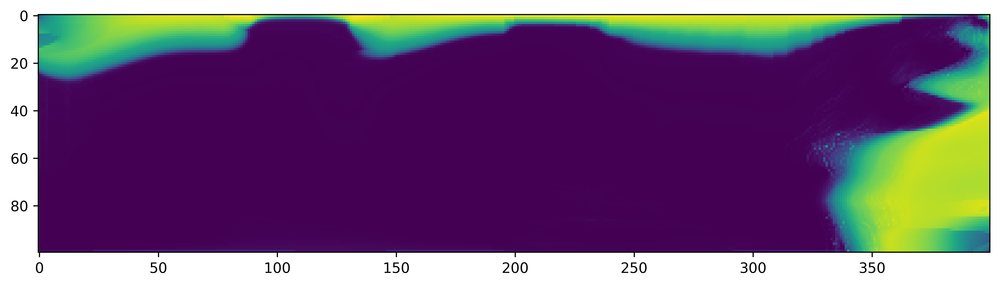

In [12]:
n=0
out = x[100,:,:,n]#.cpu().detach().numpy()
#out[out<=0] = np.min(out[out>0])
import matplotlib.pyplot as plt
from matplotlib.colors import LogNorm
fig = plt.figure(figsize=(12,12), dpi=600)
plt.imshow(out)
#plt.imshow(inputs[0,100,:,:,n].cpu().detach().numpy())
#fig.savefig('label.png')  # Replace 'output.png' with your desired file path and format

#field_names[n]
#plt.colorbar()



In [5]:
len(h5_files)

58

In [12]:
torch.max(x)

tensor(0.5282, dtype=torch.float64)

In [ ]:
tags =[rate_c, rate_d, exp_b, max_l, perm_covar, growth_rates]
tags
torch.tensor(tags_small)

In [8]:
field_names = [
   # "Liquid X-Velocity [m_per_h]",
   # "Liquid Y-Velocity [m_per_h]",
    "Liquid_Pressure [Pa]",
    #"Permeability_X [m^2]",
    "Porosity",
    #"Temperature [C]",
    #"Total_CO2 [M]",
    #"Total_Cr(VI) [M]",
    #"Total_O2 [M]",
    #"Total_molasses [M]",
    "biomass [mol_m^3]",
    #"molasses_im [mol_m^3]"
]

In [3]:
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import DataLoader
import torch.nn.functional as F
from torch.utils.data import Dataset, DataLoader
import numpy as np

In [11]:
x = torch.rand(3,114,100,400)
m = nn.Conv2d(114, 20, (5, 5), stride=(2, 2), padding=(2, 2), dilation=(1, 1))
x = m(x)
x.shape

torch.Size([3, 20, 50, 200])

## Make dataaet/model to train on both 1x and 2x

In [1]:
import h5py
#import cv2
import os 
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import DataLoader
import torch.nn.functional as F
from torch.utils.data import Dataset, DataLoader
import numpy as np

base_dir = 'C:/Users/marcb/OneDrive/Desktop/mberghouse/PFLOTRAN/code/pt_files_bio/'
f_dir = os.listdir(base_dir)
h5_files = []
h5_files_train = []
h5_files_train_1x = []
# Iterate over all files in the directory
for filename in f_dir:
    if (filename.endswith(".pt")) & ((("2x" in filename))):
        h5_files_train.append(base_dir+filename)
    if (filename.endswith(".pt")) & ((("1x" in filename))):
        h5_files_train_1x.append(base_dir+filename)
#     if (filename.endswith(".h5")) & (("8x" in filename)):
#         if (("10_5" not in filename) & ("20_20" not in filename)):
#             h5_files_train.append(base_dir+filename)
    if (filename.endswith(".pt")) & ((("10x" in filename))):
#         if (("10_5" in filename) | ("20_20" in filename)):
        h5_files.append(base_dir+filename)
# Run the processing in parallel


#h5_files = h5_files[0:6]
#h5_files_train = h5_files_train[0:6]
from torch.utils.data import Dataset

h5_files = np.sort(h5_files)
h5_files_train=np.sort(h5_files_train)
h5_files_train_1x=np.sort(h5_files_train_1x)

arr = h5_files
contains_hanford = np.array(['hanford' in item for item in arr])

# Alphabetical sorting key
alphabetical_order = np.argsort(arr)

# Prioritize "hanford" and then sort alphabetically within each group
sorted_indices = np.lexsort((alphabetical_order, ~contains_hanford))

# Use sorted indices to reorder the array
sorted_arr = arr[sorted_indices]
sorted_arr

sorted_arr2 = h5_files_train[sorted_indices]
xtest = sorted_arr2[0:33]
xtrain = sorted_arr2[33:]#np.concatenate([sorted_arr2[33:50:3], sorted_arr2[50:]])
xtrain

ytest = sorted_arr[0:33]
ytrain = sorted_arr[33:]#np.concatenate([sorted_arr[33:50:3], sorted_arr[50:]])
ytest
num_time_steps = 80
num_features = 6  # As observed from the dataset

class CustomDataset(Dataset):
    def __init__(self, x_fname, target_fname):
        self.x_fname = x_fname
        self.target_fname = target_fname

    def __len__(self):
        return len(self.x_fname)

    def __getitem__(self, idx):
        file1 = self.x_fname[idx]
        file2 = self.target_fname[idx]
        low_scale = torch.load(file1)
        high_scale = torch.load(file2)
        
        return low_scale, high_scale

from torch.utils.data import Dataset
import torch

class FullDataset_old(Dataset):
    def __init__(self, x_fname, x_fname2x, target_fname):
        # Load the data once here
        self.low_scale_data = torch.load(x_fname).float()
        self.twoX_scale_data = torch.load(x_fname2x).float()
        self.high_scale_data = [torch.load(f)[:,:,:,0].float() for f in target_fname]

    def __len__(self):
        return len(self.high_scale_data)

    def __getitem__(self, idx):
        low_scale = self.low_scale_data[idx]
        twoX_scale = self.twoX_scale_data[idx]
        high_scale = self.high_scale_data[idx]
        
        return low_scale, twoX_scale, high_scale

class FullDataset(Dataset):
    def __init__(self, x_fname,x_full, target_fname):
        self.x_fname = x_fname
        self.x_full = x_full
        self.target_fname = target_fname

    def __len__(self):
        return len(self.x_fname)

    def __getitem__(self, idx):
        file1 = self.x_fname[idx]
        file2 = self.target_fname[idx]
        x_full = self.x_full
        low_scale = torch.load(file1)[:,:,:,0].float()
        high_scale = torch.load(file2)[:,:,:,0].float()
        low_scale2 = torch.tensor(x_full[idx*114:(idx+1)*114]).float()
        return low_scale, low_scale2, high_scale

class VelDataset(Dataset):
    def __init__(self, x_fname, target_fname):
        self.x_fname = x_fname
        self.target_fname = target_fname

    def __len__(self):
        return len(self.x_fname)

    def __getitem__(self, idx):
        file1 = self.x_fname[idx]
        file2 = self.target_fname[idx]
        low_scale = torch.load(file1)[:,:,:,0].float()
        high_scale = torch.load(file2)[:,:,:,0].float()
        
        return low_scale, high_scale
    


In [2]:
base_dir = 'C:/Users/marcb/OneDrive/Desktop/mberghouse/PFLOTRAN/code/pt_files_full/'
f_dir = os.listdir(base_dir)
full_files = []
full_files_train = []
#h5_files_train_1x = []
# h5_train_full = np.concatenate([h5_files_train_1x, h5_files_train])
# h5_test_full = np.concatenate([h5_files, h5_files])
for filename in f_dir:
    if (filename.endswith(".pt")) & ((("2x" in filename))):
        full_files_train.append(base_dir+filename)
   # if (filename.endswith(".pt")) & ((("1x" in filename))):
   #     h5_files_train_1x.append(base_dir+filename)
#     if (filename.endswith(".h5")) & (("8x" in filename)):
#         if (("10_5" not in filename) & ("20_20" not in filename)):
#             h5_files_train.append(base_dir+filename)
    if (filename.endswith(".pt")) & ((("10x" in filename))):
#         if (("10_5" in filename) | ("20_20" in filename)):
        full_files.append(base_dir+filename)
# Run the processing in parallel


#h5_files = h5_files[0:6]
#h5_files_train = h5_files_train[0:6]
from torch.utils.data import Dataset

full_files = np.sort(full_files)
full_files_train=np.sort(full_files_train)
#h5_files_train_1x=np.sort(h5_files_train_1x)

arr = full_files
contains_hanford = np.array(['hanford' in item for item in arr])

# Alphabetical sorting key
alphabetical_order = np.argsort(arr)

# Prioritize "hanford" and then sort alphabetically within each group
sorted_indices = np.lexsort((alphabetical_order, ~contains_hanford))

# Use sorted indices to reorder the array
sorted_arr = arr[sorted_indices]
sorted_arr

sorted_arr2 = full_files_train[sorted_indices]
xtest_full = sorted_arr2[0:33]
xtrain_full = sorted_arr2[33:]#np.concatenate([sorted_arr2[33:50:3], sorted_arr2[50:]])


ytest_full = sorted_arr[0:33]
ytrain_full = sorted_arr[33:]#np.concatenate([sorted_arr[33:50:3], sorted_arr[50:]])


from sklearn.preprocessing import StandardScaler, MinMaxScaler
import cv2
def scale_pca(ytest,k, fit=0, num_time_steps=114, num_features=9):
    y = np.zeros((len(ytest), num_time_steps,  num_features))

    for i in range(len(ytest)):
        print (i)
        hdf5_file = torch.load(ytest[i])

        y[ i, :,  :] = torch.mean(hdf5_file, dim=(1,2))
#                 y[ i, t_idx,  f_idx+num_features] = np.std(fill)

    y = y.reshape(-1, y.shape[-1])
    if fit==1:
        y = scaler.fit_transform(y)
    else:
        y = scaler.transform(y)
    #y = pca.transform(y)
    return y
scaler = MinMaxScaler()
x_train = scale_pca(xtrain_full,100,1)
y_train = scale_pca(ytrain_full,100,0)

0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59
60
61
62
63
64
65
66
67
68
69
70
71
0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59
60
61
62
63
64
65
66
67
68
69
70
71


In [11]:
x_train.shape[0]//len(xtrain_full)

114

In [149]:
arr = h5_files
contains_hanford = np.array(['hanford' in item for item in arr])

# Alphabetical sorting key
alphabetical_order = np.argsort(arr)

# Prioritize "hanford" and then sort alphabetically within each group
sorted_indices = np.lexsort((alphabetical_order, ~contains_hanford))

# Use sorted indices to reorder the array
sorted_arr = arr[sorted_indices]
sorted_arr



array(['C:/Users/marcb/OneDrive/Desktop/mberghouse/PFLOTRAN/code/pt_files_bio/hanford_diff_lose_14_10_10xscale.pt',
       'C:/Users/marcb/OneDrive/Desktop/mberghouse/PFLOTRAN/code/pt_files_bio/hanford_diff_lose_18_10_10xscale.pt',
       'C:/Users/marcb/OneDrive/Desktop/mberghouse/PFLOTRAN/code/pt_files_bio/hanford_diff_lose_24_17_10xscale.pt',
       'C:/Users/marcb/OneDrive/Desktop/mberghouse/PFLOTRAN/code/pt_files_bio/hanford_diff_lose_31_7_10xscale.pt',
       'C:/Users/marcb/OneDrive/Desktop/mberghouse/PFLOTRAN/code/pt_files_bio/hanford_diff_lose_34_15_10xscale.pt',
       'C:/Users/marcb/OneDrive/Desktop/mberghouse/PFLOTRAN/code/pt_files_bio/hanford_diff_lose_41_12_10xscale.pt',
       'C:/Users/marcb/OneDrive/Desktop/mberghouse/PFLOTRAN/code/pt_files_bio/hanford_gain_14_10_10xscale.pt',
       'C:/Users/marcb/OneDrive/Desktop/mberghouse/PFLOTRAN/code/pt_files_bio/hanford_gain_24_17_10xscale.pt',
       'C:/Users/marcb/OneDrive/Desktop/mberghouse/PFLOTRAN/code/pt_files_bio/hanfo

In [150]:
sorted_arr2 = h5_files_train[sorted_indices]
xtest = sorted_arr2[0:33]
xtrain = sorted_arr2[33:]#np.concatenate([sorted_arr2[33:50:3], sorted_arr2[50:]])
xtrain


array(['C:/Users/marcb/OneDrive/Desktop/mberghouse/PFLOTRAN/code/pt_files_bio/gaining_17_22_2xscale.pt',
       'C:/Users/marcb/OneDrive/Desktop/mberghouse/PFLOTRAN/code/pt_files_bio/gaining_22_16_2xscale.pt',
       'C:/Users/marcb/OneDrive/Desktop/mberghouse/PFLOTRAN/code/pt_files_bio/gaining_25_15_2xscale.pt',
       'C:/Users/marcb/OneDrive/Desktop/mberghouse/PFLOTRAN/code/pt_files_bio/gaining_27_7_2xscale.pt',
       'C:/Users/marcb/OneDrive/Desktop/mberghouse/PFLOTRAN/code/pt_files_bio/gaining_30_15_2xscale.pt',
       'C:/Users/marcb/OneDrive/Desktop/mberghouse/PFLOTRAN/code/pt_files_bio/gaining_33_24_2xscale.pt',
       'C:/Users/marcb/OneDrive/Desktop/mberghouse/PFLOTRAN/code/pt_files_bio/gaining_34_6_2xscale.pt',
       'C:/Users/marcb/OneDrive/Desktop/mberghouse/PFLOTRAN/code/pt_files_bio/gaining_36_11_2xscale.pt',
       'C:/Users/marcb/OneDrive/Desktop/mberghouse/PFLOTRAN/code/pt_files_bio/gaining_38_16_2xscale.pt',
       'C:/Users/marcb/OneDrive/Desktop/mberghouse/PFLOTR

In [152]:
ytest = sorted_arr[0:33]
ytrain = sorted_arr[33:]#np.concatenate([sorted_arr[33:50:3], sorted_arr[50:]])
ytest

array(['C:/Users/marcb/OneDrive/Desktop/mberghouse/PFLOTRAN/code/pt_files_bio/hanford_diff_lose_14_10_10xscale.pt',
       'C:/Users/marcb/OneDrive/Desktop/mberghouse/PFLOTRAN/code/pt_files_bio/hanford_diff_lose_18_10_10xscale.pt',
       'C:/Users/marcb/OneDrive/Desktop/mberghouse/PFLOTRAN/code/pt_files_bio/hanford_diff_lose_24_17_10xscale.pt',
       'C:/Users/marcb/OneDrive/Desktop/mberghouse/PFLOTRAN/code/pt_files_bio/hanford_diff_lose_31_7_10xscale.pt',
       'C:/Users/marcb/OneDrive/Desktop/mberghouse/PFLOTRAN/code/pt_files_bio/hanford_diff_lose_34_15_10xscale.pt',
       'C:/Users/marcb/OneDrive/Desktop/mberghouse/PFLOTRAN/code/pt_files_bio/hanford_diff_lose_41_12_10xscale.pt',
       'C:/Users/marcb/OneDrive/Desktop/mberghouse/PFLOTRAN/code/pt_files_bio/hanford_gain_14_10_10xscale.pt',
       'C:/Users/marcb/OneDrive/Desktop/mberghouse/PFLOTRAN/code/pt_files_bio/hanford_gain_24_17_10xscale.pt',
       'C:/Users/marcb/OneDrive/Desktop/mberghouse/PFLOTRAN/code/pt_files_bio/hanfo

In [132]:
hdf5_file.shape

torch.Size([114, 100, 400, 1])

In [133]:
import cv2
# x = np.zeros((len(xtrain), 105, 40, 200, 9))
# k=70
# for i in range(len(xtrain)):
#     print (i)
#     hdf5_file = torch.load(xtrain[i])#h5py.File(xtrain[i], 'r')
#     x[ i, :, :, :, :] = hdf5_file[5:110,:,:,:]#cv2.resize(fill,[200, 50])

    
xtst = np.zeros((len(xtest), 105, 40, 200, 9))
k=70
for i in range(len(xtest)):
    print (i)
    hdf5_file = torch.load(xtest[i])#h5py.File(xtrain[i], 'r')
    xtst[ i, :, :, :, :] = hdf5_file[5:110,:,:,:]#cv2.resize(fill,[200, 50])

0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32


In [22]:
x.shape

(72, 105, 40, 200, 9)

In [23]:
y = np.zeros((len(xtrain), 105, 40, 200, 9))
for i in range(len(xtrain)):
    hdf5_file = torch.load(ytrain[i])
    y[ i, :, :, :, :] = hdf5_file[5:110,:,:,:]

In [24]:
x = x.reshape(-1, x.shape[-1])
from sklearn.decomposition import IncrementalPCA
from sklearn.preprocessing import StandardScaler
n_components = 3
#scaler = StandardScaler()
#x = scaler.fit_transform(x)
ipca = IncrementalPCA(n_components=n_components, batch_size=20000)
Xipca = ipca.fit_transform(x)

Xipca

array([[  0.15030657,  -2.3950906 ,  -2.40161884],
       [ -0.18140698,  -2.45992208,  -2.48396443],
       [ -0.27672307,  -2.46901027,  -2.49666691],
       ...,
       [-12.03684103,  -1.8447499 ,  -0.91245332],
       [-12.05587867,  -1.81355608,  -1.33823115],
       [-12.38670463,  -1.81771651,  -1.50058956]])

In [135]:
xtst = xtst.reshape(-1, x.shape[-1])

n_components = 3
#scaler = StandardScaler()
#x = scaler.fit_transform(x)
Xipca_test = ipca.transform(xtst)
torch.save(torch.tensor(Xipca_test), 'Xipca_test')
Xipca_test.shape

(27720000, 3)

In [26]:
y = y.reshape(-1, y.shape[-1])
Yipca = ipca.transform(y)
Yipca

array([[ -0.29160742,  -2.46846621,  -2.52863004],
       [ -0.34349521,  -2.48091886,  -2.47553727],
       [ -0.30657953,  -2.4925554 ,  -2.36513884],
       ...,
       [ -4.28712314,  -2.60286386,  -1.4262997 ],
       [ -4.51509397,  -2.69228968,  -1.23061895],
       [-11.48537401,  -1.62104955,  -0.11653563]])

Text(0, 0.5, 'Cumulative Explained Variance')

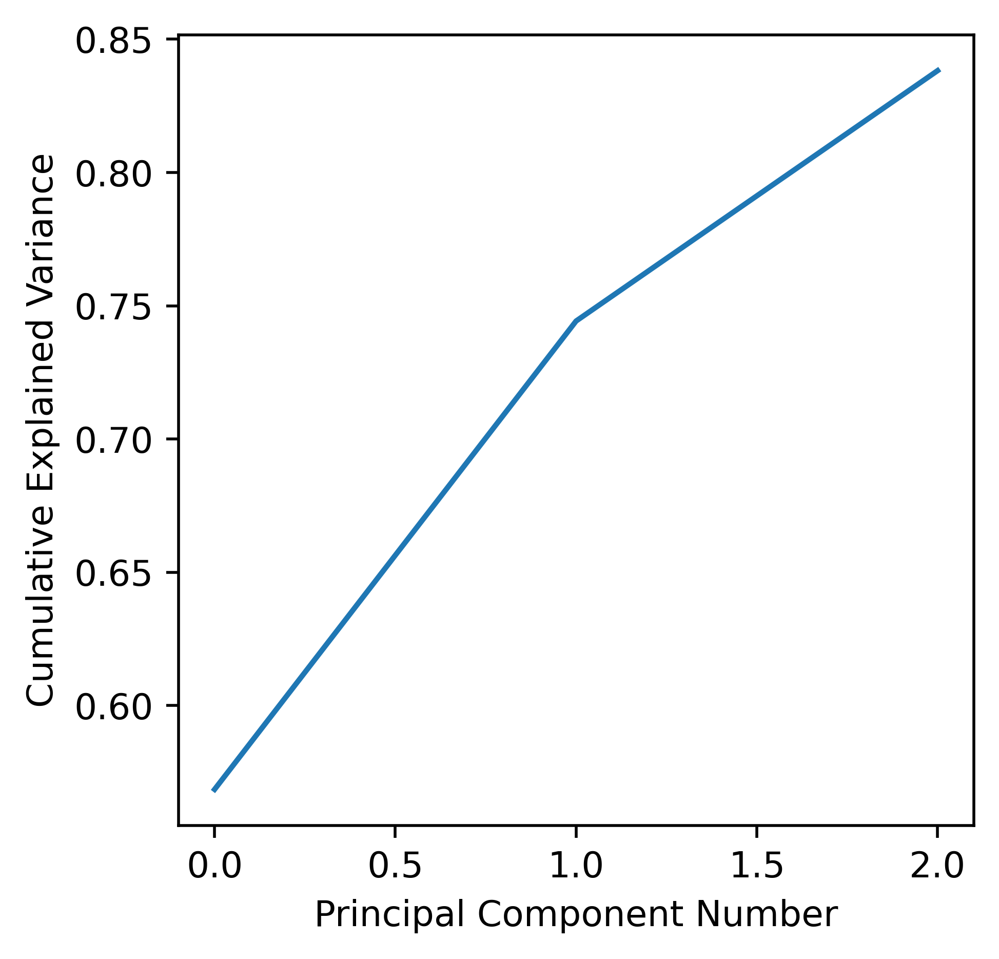

In [136]:
plt.figure(figsize=(4,4), dpi=500)
plt.plot(np.cumsum(ipca.explained_variance_ratio_))
plt.xlabel('Principal Component Number')
plt.ylabel('Cumulative Explained Variance')

In [32]:
Yipca.shape[0]//len(xtrain)

840000

In [33]:
105*40*200

840000

In [30]:
torch.save(torch.tensor(Xipca), 'Xipca')
#torch.save(torch.tensor(Yipca), 'Yipca')

In [5]:
class VelDataset2(Dataset):
    def __init__(self, x_fname, x_fnames, target_fname):
        self.x_fname = x_fname
        self.x_fnames = x_fnames
        self.target_fname = target_fname

    def __len__(self):
        return len(self.x_fname)

    def __getitem__(self, idx):
        file1 = self.x_fname
        file1_full = self.x_fnames[idx]
        file2 = self.target_fname[idx]
        low_scale = torch.load(file1)[0+840000*idx:840000+840000*idx].float()
        low_scale_full = torch.load(file1_full)[5:110,:,:,0].float()
        high_scale = torch.load(file2)[5:110,:,:,0].float()
        
        return low_scale, low_scale_full, high_scale

In [3]:
import h5py
#import cv2
import torch
import numpy as np
import pandas as pd
import os
import sklearn
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
from sklearn.pipeline import make_pipeline
from sklearn.preprocessing import StandardScaler
from sklearn.ensemble import RandomForestRegressor

base_dir = 'C:/Users/marcb/OneDrive/Desktop/mberghouse/PFLOTRAN/code/pt_files_bio/'
f_dir = os.listdir(base_dir)
h5_files = []
h5_files_train = []
h5_files_train_1x = []
# Iterate over all files in the directory
for filename in f_dir:
    if (filename.endswith(".pt")) & ((("2x" in filename))):
        h5_files_train.append(base_dir+filename)
    if (filename.endswith(".pt")) & ((("1x" in filename))):
        h5_files_train_1x.append(base_dir+filename)
#     if (filename.endswith(".h5")) & (("8x" in filename)):
#         if (("10_5" not in filename) & ("20_20" not in filename)):
#             h5_files_train.append(base_dir+filename)
    if (filename.endswith(".pt")) & ((("10x" in filename))):
#         if (("10_5" in filename) | ("20_20" in filename)):
        h5_files.append(base_dir+filename)
# Run the processing in parallel


#h5_files = h5_files[0:6]
#h5_files_train = h5_files_train[0:6]
from torch.utils.data import Dataset

h5_files = np.sort(h5_files)
h5_files_train=np.sort(h5_files_train)
h5_files_train_1x=np.sort(h5_files_train_1x)

arr = h5_files
contains_hanford = np.array(['hanford' in item for item in arr])

# Alphabetical sorting key
alphabetical_order = np.argsort(arr)

# Prioritize "hanford" and then sort alphabetically within each group
sorted_indices = np.lexsort((alphabetical_order, ~contains_hanford))

# Use sorted indices to reorder the array
sorted_arr = arr[sorted_indices]
sorted_arr

sorted_arr2 = h5_files_train[sorted_indices]
xtest = sorted_arr2[0:33]
xtrain = sorted_arr2[33:]#np.concatenate([sorted_arr2[33:50:3], sorted_arr2[50:]])
xtrain

ytest = sorted_arr[0:33]
ytrain = sorted_arr[33:]#np.concatenate([sorted_arr[33:50:3], sorted_arr[50:]])
ytest

array(['C:/Users/marcb/OneDrive/Desktop/mberghouse/PFLOTRAN/code/pt_files_bio/hanford_diff_lose_14_10_10xscale.pt',
       'C:/Users/marcb/OneDrive/Desktop/mberghouse/PFLOTRAN/code/pt_files_bio/hanford_diff_lose_18_10_10xscale.pt',
       'C:/Users/marcb/OneDrive/Desktop/mberghouse/PFLOTRAN/code/pt_files_bio/hanford_diff_lose_24_17_10xscale.pt',
       'C:/Users/marcb/OneDrive/Desktop/mberghouse/PFLOTRAN/code/pt_files_bio/hanford_diff_lose_31_7_10xscale.pt',
       'C:/Users/marcb/OneDrive/Desktop/mberghouse/PFLOTRAN/code/pt_files_bio/hanford_diff_lose_34_15_10xscale.pt',
       'C:/Users/marcb/OneDrive/Desktop/mberghouse/PFLOTRAN/code/pt_files_bio/hanford_diff_lose_41_12_10xscale.pt',
       'C:/Users/marcb/OneDrive/Desktop/mberghouse/PFLOTRAN/code/pt_files_bio/hanford_gain_14_10_10xscale.pt',
       'C:/Users/marcb/OneDrive/Desktop/mberghouse/PFLOTRAN/code/pt_files_bio/hanford_gain_24_17_10xscale.pt',
       'C:/Users/marcb/OneDrive/Desktop/mberghouse/PFLOTRAN/code/pt_files_bio/hanfo

In [9]:
dataset = VelDataset2('Xipca_test',xtest, ytest)
test_dataloader = DataLoader(dataset, batch_size=6, shuffle=False,  num_workers=0, drop_last=True)

In [7]:
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import DataLoader
import torch.nn.functional as F
from torch.utils.data import Dataset, DataLoader
import numpy



import random

ytrain
dataset = FullDataset(xtrain,x_train, ytrain)
dataloader = DataLoader(dataset, batch_size=6, shuffle=True,  num_workers=0, drop_last=False)
xbatch,xbatch2, ybatch = next(iter(dataloader))
xbatch.shape

torch.Size([6, 114, 100, 400])

In [19]:
xbatch2.shape

torch.Size([4, 114, 9])

In [20]:
ybatch.shape

torch.Size([4, 114, 100, 2000])

### Convert .pt file to TFrecords file

In [10]:
# def parse_single_image(image, label):
  
#   #define the dictionary -- the structure -- of our single example
#   data = {
#         't_steps' : _int64_feature(image.shape[0]),
#         'height' : _int64_feature(image.shape[1]),
#         'width' : _int64_feature(image.shape[2]),
#         'raw_image' : _bytes_feature(serialize_array(image)),
#         'label_t_steps' : _int64_feature(label.shape[0]),
#         'label_height' : _int64_feature(label.shape[1]),
#         'label_width' : _int64_feature(label.shape[2]),
#         'raw_label' : _bytes_feature(serialize_array(label)),
#     }
#   #create an Example, wrapping the single features
#   out = tf.train.Example(features=tf.train.Features(feature=data))

#   return out

In [11]:
# def write_images_to_tfr_short(images, labels, filename:str="pflotran"):
#   filename= filename+".tfrecords"
#   writer = tf.io.TFRecordWriter(filename) #create a writer that'll store our data to disk
#   count = 0

#   for index in range(len(images)):

#     #get the data we want to write
#     current_image = torch.load(images[index]) 
#     current_label = torch.load(labels[index])

#     out = parse_single_image(image=current_image, label=current_label)
#     writer.write(out.SerializeToString())
#     count += 1

#   writer.close()
#   print(f"Wrote {count} elements to TFRecord")
#   return count

In [12]:
# def _bytes_feature(value):
#     """Returns a bytes_list from a string / byte."""
#     if isinstance(value, type(tf.constant(0))): # if value ist tensor
#         value = value.numpy() # get value of tensor
#     return tf.train.Feature(bytes_list=tf.train.BytesList(value=[value]))

# def _float_feature(value):
#   """Returns a floast_list from a float / double."""
#   return tf.train.Feature(float_list=tf.train.FloatList(value=[value]))

# def _int64_feature(value):
#   """Returns an int64_list from a bool / enum / int / uint."""
#   return tf.train.Feature(int64_list=tf.train.Int64List(value=[value]))

# def serialize_array(array):
#   array = tf.io.serialize_tensor(array)
#   return array

In [14]:
# !pip install tensorflow

  Obtaining dependency information for tensorflow from https://files.pythonhosted.org/packages/93/21/9b035a4f823d6aee2917c75415be9a95861ff3d73a0a65e48edbf210cec1/tensorflow-2.15.0-cp311-cp311-win_amd64.whl.metadata
  Obtaining dependency information for tensorflow-intel==2.15.0 from https://files.pythonhosted.org/packages/4c/48/1a5a15517f18eaa4ff8d598b1c000300b20c1bb0e624539d702117a0c369/tensorflow_intel-2.15.0-cp311-cp311-win_amd64.whl.metadata
  Obtaining dependency information for flatbuffers>=23.5.26 from https://files.pythonhosted.org/packages/6f/12/d5c79ee252793ffe845d58a913197bfa02ae9a0b5c9bc3dc4b58d477b9e7/flatbuffers-23.5.26-py2.py3-none-any.whl.metadata
  Obtaining dependency information for gast!=0.5.0,!=0.5.1,!=0.5.2,>=0.2.1 from https://files.pythonhosted.org/packages/fa/39/5aae571e5a5f4de9c3445dae08a530498e5c53b0e74410eeeb0991c79047/gast-0.5.4-py3-none-any.whl.metadata
     ---------------------------------------- 0.0/57.5 kB ? eta -:--:--
     ---------------------------

In [15]:
# import tensorflow as tf
# count = write_images_to_tfr_short(xtrain, ytrain, filename="pflotran_train")



Wrote 69 elements to TFRecord


In [26]:


# def parse_tfr_element(element):
#   #use the same structure as above; it's kinda an outline of the structure we now want to create
#   data = {
#       't_steps': tf.io.FixedLenFeature([], tf.int64),
#       'height': tf.io.FixedLenFeature([], tf.int64),
#       'width':tf.io.FixedLenFeature([], tf.int64),
#       'raw_image' : tf.io.FixedLenFeature([], tf.string),
#       'label_t_steps': tf.io.FixedLenFeature([], tf.int64),
#       'label_height': tf.io.FixedLenFeature([], tf.int64),
#       'label_width':tf.io.FixedLenFeature([], tf.int64),
#       'raw_label' : tf.io.FixedLenFeature([], tf.string),
#     }

    
#   content = tf.io.parse_single_example(element, data)
  
#   t_steps = content['t_steps']
#   height = content['height']
#   width = content['width']
#   raw_image = content['raw_image']
#   label_t_steps = content['label_t_steps']
#   label_height = content['label_height']
#   label_width = content['label_width']
#   raw_label = content['raw_label']
  
  
  
#   #get our 'feature'-- our image -- and reshape it appropriately
#   feature = tf.io.parse_tensor(raw_image, out_type=tf.double)
#   feature = tf.reshape(feature, shape=[t_steps,height,width])
#   label = tf.io.parse_tensor(raw_label, out_type=tf.double)
#   label = tf.reshape(label, shape=[label_t_steps,label_height,label_width])
#   return (feature, label)

In [27]:

# def get_dataset_small(filename):
#   #create the dataset
#   dataset = tf.data.TFRecordDataset(filename)

#   #pass every single feature through our mapping function
#   dataset = dataset.map(
#       parse_tfr_element
#   )
    
#   return dataset

In [28]:

# dataset_small = get_dataset_small("pflotran_train.tfrecords")

# for sample in dataset_small.take(1):
#   print(sample[0].shape)
#   print(sample[1].shape)

(114, 100, 400)
(114, 100, 2000)


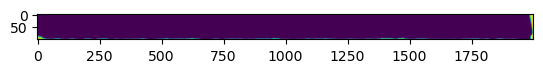

In [30]:
# import matplotlib.pyplot as plt
# plt.imshow(sample[1][113,:,:])

In [88]:
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import DataLoader
import torch.nn.functional as F
from torch.utils.data import Dataset, DataLoader
import numpy
#xtrain = ([h5_files_train[i] for i in range(len(h5_files_train)) if i%5])
#ytrain = ([h5_files[i] for i in range(len(h5_files)) if  i%5])

import random
#indices = list(range(len(h5_files)))

# Shuffle the indices
#random.shuffle(indices)

# Reorder both lists according to the shuffled indices
#h5_files = [h5_files[i] for i in indices]
#h5_files_train = [h5_files_train[i] for i in indices]
#xtest = np.concatenate([h5_files_train[43:47], h5_files_train[16:26]])
#xtest2 = np.concatenate([h5_files_train_1x[43:47], h5_files_train_1x[16:26]])
#ytest = np.concatenate([h5_files[43:47], h5_files[16:26]])

#xtrain = np.concatenate([h5_files_train[0:16], h5_files_train[26:43],h5_files_train[47:]])
#xtrain2 = np.concatenate([h5_files_train_1x[0:16], h5_files_train_1x[26:43],h5_files_train_1x[47:]])
#ytrain = np.concatenate([h5_files[0:16], h5_files[26:43],h5_files[47:]])
ytrain
dataset = VelDataset(xtrain,ytrain)
dataloader = DataLoader(dataset, batch_size=4, shuffle=True,  num_workers=0, drop_last=False)
x,y = next(iter(dataloader))
x.shape


torch.Size([4, 114, 100, 400])

In [36]:
x2=x.flatten()
len(x2)//4

4560000

In [9]:
device='cuda'
from earthformer.cuboid_transformer.cuboid_transformer import (
    CuboidTransformerModel,
)
model = CuboidTransformerModel([ 12, 100,  400,1], [ 6, 100,  400,1], enc_depth=[1], dec_depth=[1])
#model = model.to(device)
#F.interpolate(x, scale_factor=.5)
for i in range(20):
    x,y = next(iter(dataloader))

    model.train()
    x2=x[:,0::10,:,:,:]
    out2 = model(x2)
    out2

C:\Users\marcb\anaconda3\Lib\site-packages\torch\functional.py:507: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at C:\cb\pytorch_1000000000000\work\aten\src\ATen\native\TensorShape.cpp:3550.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]
C:\Users\marcb\anaconda3\Lib\site-packages\torch\utils\checkpoint.py:460: UserWarning: torch.utils.checkpoint: please pass in use_reentrant=True or use_reentrant=False explicitly. The default value of use_reentrant will be updated to be False in the future. To maintain current behavior, pass use_reentrant=True. It is recommended that you use use_reentrant=False. Refer to docs for more details on the differences between the two variants.
  warnings.warn(


In [9]:
class Upsample_small(nn.Module):
    def __init__(self, inc, outc):
        super(Upsample_small, self).__init__()
        
        
        
        self.fc1 = nn.Linear(9,2000)
        self.fc2 = nn.Linear(2000,1)

        #self.fc2 = nn.Conv2d(6, 114, kernel_size=(1,1))
        #self.fc3 = nn.Linear(400,2000)
        #self.fc4 = nn.Linear(20,100)
        #self.fc5 = nn.Conv2d(105, 114, kernel_size=(1,1))
        #self.fc6 = nn.Linear(2000,2000)
        
        self.fc7 = nn.Linear(8000,4000)
        self.fc8 = nn.Linear(4000,3000)
        self.fc9 = nn.Linear(3000,2000)
        #self.fc10 = nn.Linear(2000,2000)
        self.fc11 = nn.Linear(2000,2000)
        self.fc12 = nn.Linear(2000,2000)
        
    def forward(self, x, x1):
        #mult_dim = 4000//x.shape[3]
        x1 = F.gelu(self.fc1(x1))
        x1 = F.gelu(self.fc2(x1))
        x1 = x1.unsqueeze(dim=3)
        #x = x.view(4,105,20,400)
        
       # x = F.gelu(self.fc3(x))
       # x = x.permute(0,1,3,2)
       # x = F.gelu(self.fc4(x))
       # x = x.permute(0,1,3,2)
       # x = self.fc6(x)
        
        x = x.repeat_interleave(20, dim=3)
        x = F.gelu(self.fc7(x))

        #x = F.gelu(self.fc3(x))
        x = F.gelu(self.fc8(x))
        x = F.gelu(self.fc9(x))
        #x = F.gelu(self.fc10(x))
       # print (x.shape, x1.shape)
        
        x = x*x1
        x = F.gelu(self.fc11(x))
        x = self.fc12(x)
        
        return x
    


In [10]:
mod = Upsample_small(200, 2000)
mod

Upsample_small(
  (fc1): Linear(in_features=9, out_features=2000, bias=True)
  (fc2): Linear(in_features=2000, out_features=1, bias=True)
  (fc7): Linear(in_features=8000, out_features=4000, bias=True)
  (fc8): Linear(in_features=4000, out_features=3000, bias=True)
  (fc9): Linear(in_features=3000, out_features=2000, bias=True)
  (fc11): Linear(in_features=2000, out_features=2000, bias=True)
  (fc12): Linear(in_features=2000, out_features=2000, bias=True)
)

In [33]:
mod(xbatch, xbatch2.float()).shape

torch.Size([4, 114, 100, 2000]) torch.Size([4, 114, 1, 1])


torch.Size([4, 114, 100, 2000])

In [4]:
x_test = scale_pca(xtest_full,100,0)

0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32


In [5]:
test_dataset = FullDataset(xtest,x_test, ytest)
test_dataloader = DataLoader(test_dataset, batch_size=4, shuffle=False,  num_workers=0, drop_last=False)
xbatch,xbatch2, ybatch = next(iter(test_dataloader))
xbatch.shape

torch.Size([4, 114, 100, 400])

In [11]:
import torch
from torch.utils.data import Dataset, DataLoader
from torch.optim.lr_scheduler import ExponentialLR

device='cuda'

# model0 = Upsample_small(200, 2000).to(device)
mod = Upsample_small(200, 2000).to(device)

# Model, loss, and optimizer
# device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
#criterion1 = DivLoss()
criterion2 = nn.MSELoss()
criterion3 = nn.HuberLoss()
criterion4 = nn.KLDivLoss()

optimizer1 = optim.Adam(mod.parameters(), lr=0.0004)
gamma = .999# The exponential decay factor (adjust as needed)
scheduler1 = ExponentialLR(optimizer1, gamma=gamma)

#import gc
mod.train()
num_epochs = 5000
for epoch in range(num_epochs):

    count=1
    running_loss=0
    for batch in dataloader:
        inputs = batch[0].to(device)
        inputs2 = batch[1].to(device)
        labels = batch[2].to(device)
        optimizer1.zero_grad()
        #outputs = model0(inputs[:,:,:,:,0])
        #inputs=batch[0][:,0::10,:,:,:].to('cpu')
#         out2 = model(inputs)       
#         inputs=out2.squeeze()
        outputs = mod(inputs, inputs2)
        
        loss = criterion2(outputs, labels)
        loss.backward()
        optimizer1.step()
        scheduler1.step()

        count=count+1
        running_loss = running_loss+loss.item()
        #print(count)
        #print (loss.item())
    # Model testing
    nn_errors=[]
    orig_errors=[]
    with torch.no_grad():
        for inp, inp2, lab in test_dataloader:
            inp = inp.to(device)
            inp2 = inp2.to(device)
            lab= lab.to(device)
            
            outp = mod(inp, inp2)
            inp = inp.repeat_interleave(5, dim=3)
            nn_error = criterion2(outp, lab)
            orig_error = criterion2(lab, inp)
            nn_errors.append(nn_error.cpu().detach().numpy())
            orig_errors.append(orig_error.cpu().detach().numpy())
    print (np.mean(orig_errors), np.mean(nn_errors))
    current_lr = optimizer1.param_groups[0]['lr']
    print(f"Epoch {epoch+1}/{num_epochs}, Loss: {running_loss/count}, Learning Rate: {current_lr:.8f}")


1.2392824 1.2440791
Epoch 1/5000, Loss: 2.572533139815697, Learning Rate: 0.00039523
1.2392824 0.6661705
Epoch 2/5000, Loss: 2.159799580390637, Learning Rate: 0.00039051
1.2392824 0.4360625
Epoch 3/5000, Loss: 1.6119189995985765, Learning Rate: 0.00038585
1.2392824 0.44376194
Epoch 4/5000, Loss: 0.9770448528803312, Learning Rate: 0.00038124
1.2392824 0.422146
Epoch 5/5000, Loss: 1.554608248747312, Learning Rate: 0.00037669
1.2392824 0.40491712
Epoch 6/5000, Loss: 0.9965250125298133, Learning Rate: 0.00037220
1.2392824 0.40584412
Epoch 7/5000, Loss: 0.8211117340968206, Learning Rate: 0.00036776
1.2392824 0.4517426
Epoch 8/5000, Loss: 0.8616201487871317, Learning Rate: 0.00036337
1.2392824 0.4020811
Epoch 9/5000, Loss: 0.8945686828631622, Learning Rate: 0.00035903
1.2392824 0.378245
Epoch 10/5000, Loss: 0.8603429381663983, Learning Rate: 0.00035475
1.2392824 0.37741464
Epoch 11/5000, Loss: 0.8007164872609652, Learning Rate: 0.00035051
1.2392824 0.35852444
Epoch 12/5000, Loss: 0.754897524

1.2392824 0.35280365
Epoch 95/5000, Loss: 0.282672922198589, Learning Rate: 0.00012785
1.2392824 0.39166334
Epoch 96/5000, Loss: 0.2855643028250107, Learning Rate: 0.00012633
1.2392824 0.3689617
Epoch 97/5000, Loss: 0.2811263088996594, Learning Rate: 0.00012482
1.2392824 0.36378285
Epoch 98/5000, Loss: 0.2721825832357773, Learning Rate: 0.00012333
1.2392824 0.3811534
Epoch 99/5000, Loss: 0.27921138818447405, Learning Rate: 0.00012186
1.2392824 0.3791405
Epoch 100/5000, Loss: 0.2730759405172788, Learning Rate: 0.00012041
1.2392824 0.37524515
Epoch 101/5000, Loss: 0.27330709248781204, Learning Rate: 0.00011897
1.2392824 0.37869704
Epoch 102/5000, Loss: 0.28184374651083577, Learning Rate: 0.00011755
1.2392824 0.3582341
Epoch 103/5000, Loss: 0.2596673019803487, Learning Rate: 0.00011615
1.2392824 0.37938976
Epoch 104/5000, Loss: 0.2787801520182536, Learning Rate: 0.00011476
1.2392824 0.37693962
Epoch 105/5000, Loss: 0.27086382645827073, Learning Rate: 0.00011339
1.2392824 0.37199295
Epoch 

1.2392824 0.3472341
Epoch 187/5000, Loss: 0.13444637793761033, Learning Rate: 0.00004237
1.2392824 0.3512786
Epoch 188/5000, Loss: 0.13193090775838265, Learning Rate: 0.00004186
1.2392824 0.35103616
Epoch 189/5000, Loss: 0.1322303626399774, Learning Rate: 0.00004136
1.2392824 0.34838954
Epoch 190/5000, Loss: 0.1276120116504339, Learning Rate: 0.00004087
1.2392824 0.34873992
Epoch 191/5000, Loss: 0.12838216183277276, Learning Rate: 0.00004038
1.2392824 0.35007626
Epoch 192/5000, Loss: 0.1261354131767383, Learning Rate: 0.00003990
1.2392824 0.35056087
Epoch 193/5000, Loss: 0.1266808624450977, Learning Rate: 0.00003942
1.2392824 0.34408045
Epoch 194/5000, Loss: 0.12207407418351907, Learning Rate: 0.00003895
1.2392824 0.34727103
Epoch 195/5000, Loss: 0.12327739166525695, Learning Rate: 0.00003849
1.2392824 0.3517729
Epoch 196/5000, Loss: 0.12359877389210921, Learning Rate: 0.00003803
1.2392824 0.34861943
Epoch 197/5000, Loss: 0.12787013959426147, Learning Rate: 0.00003757
1.2392824 0.34648

KeyboardInterrupt: 

In [45]:
inp2.shape

torch.Size([4, 114, 9])

In [147]:
labels.shape

torch.Size([4, 105, 40, 200])

In [7]:


class Upsample_small(nn.Module):
    def __init__(self, inc, outc):
        super(Upsample_small, self).__init__()
        
        
        
        self.fc1 = nn.Linear(8000,4000)

        #self.fc2 = nn.Conv2d(6, 114, kernel_size=(1,1))
        self.fc2 = CuboidSelfAttentionLayer(4000, 20)
        #self.fc3 = nn.Linear(4000,4000)
        self.fc4 = nn.Linear(4000,3000)
        self.fc5 = nn.Linear(3000,2000)
        self.fc6 = nn.Linear(2000,2000)
        
    def forward(self, x):
        #mult_dim = 4000//x.shape[3]
        x = x.repeat_interleave(20, dim=3)
        x = F.gelu(self.fc1(x))
        x2 = x.unsqueeze(dim=0)
        x2 = F.sigmoid(self.fc2(x2))
        x = x*x2.squeeze()
        #x = F.gelu(self.fc3(x))
        x = F.gelu(self.fc4(x))
        x = F.gelu(self.fc5(x))
        x = self.fc6(x)
        return x
		
class CuboidSelfAttentionLayer(nn.Module):
    """Implements the cuboid self attention.

    The idea of Cuboid Self Attention is to divide the input tensor (T, H, W) into several non-overlapping cuboids.
    We apply self-attention inside each cuboid and all cuboid-level self attentions are executed in parallel.

    We adopt two mechanisms for decomposing the input tensor into cuboids:

    1) local:
        We group the tensors within a local window, e.g., X[t:(t+b_t), h:(h+b_h), w:(w+b_w)]. We can also apply the
        shifted window strategy proposed in "[ICCV2021] Swin Transformer: Hierarchical Vision Transformer using Shifted Windows".
    2) dilated:
        Inspired by the success of dilated convolution "[ICLR2016] Multi-Scale Context Aggregation by Dilated Convolutions",
         we split the tensor with dilation factors that are tied to the size of the cuboid. For example, for a cuboid that has width `b_w`,
         we sample the elements starting from 0 as 0, w / b_w, 2 * w / b_w, ..., (b_w - 1) * w / b_w.

    The cuboid attention can be viewed as a generalization of the attention mechanism proposed in Video Swin Transformer, https://arxiv.org/abs/2106.13230.
    The computational complexity of CuboidAttention can be simply calculated as O(T H W * b_t b_h b_w). To cover multiple correlation patterns,
    we are able to combine multiple CuboidAttention layers with different configurations such as cuboid size, shift size, and local / global decomposing strategy.

    In addition, it is straight-forward to extend the cuboid attention to other types of spatiotemporal data that are not described
    as regular tensors. We need to define alternative approaches to partition the data into "cuboids".

    In addition, inspired by "[NeurIPS2021] Do Transformers Really Perform Badly for Graph Representation?",
     "[NeurIPS2020] Big Bird: Transformers for Longer Sequences", "[EMNLP2021] Longformer: The Long-Document Transformer", we keep
     $K$ global vectors to record the global status of the spatiotemporal system. These global vectors will attend to the whole tensor and
     the vectors inside each individual cuboids will also attend to the global vectors so that they can peep into the global status of the system.

    """
    def __init__(self,
                 dim,
                 num_heads,
                 cuboid_size=(2, 7, 7),
                 shift_size=(0, 0, 0),
                 strategy=('l', 'l', 'l'),
                 padding_type='ignore',
                 qkv_bias=False,
                 qk_scale=None,
                 attn_drop=0.2,
                 proj_drop=0.2,
                 use_final_proj=True,
                 norm_layer='layer_norm',
                 use_global_vector=False,
                 use_global_self_attn=False,
                 separate_global_qkv=False,
                 global_dim_ratio=1,
                 checkpoint_level=True,
                 use_relative_pos=True,
                 attn_linear_init_mode="0",
                 ffn_linear_init_mode="0",
                 norm_init_mode="0",
                 ):
        """

        Parameters
        ----------
        dim
            The dimension of the input tensor
        num_heads
            The number of heads
        cuboid_size
            The size of each cuboid
        shift_size
            The size for shifting the windows.
        strategy
            The decomposition strategy of the tensor. 'l' stands for local and 'd' stands for dilated.
        padding_type
            The type of padding.
        qkv_bias
            Whether to enable bias in calculating qkv attention
        qk_scale
            Whether to enable scale factor when calculating the attention.
        attn_drop
            The attention dropout
        proj_drop
            The projection dropout
        use_final_proj
            Whether to use the final projection or not
        norm_layer
            The normalization layer
        use_global_vector
            Whether to use the global vector or not.
        use_global_self_attn
            Whether to do self attention among global vectors
        separate_global_qkv
            Whether to different network to calc q_global, k_global, v_global
        global_dim_ratio
            The dim (channels) of global vectors is `global_dim_ratio*dim`.
        checkpoint_level
            Whether to enable gradient checkpointing.
        """
        super(CuboidSelfAttentionLayer, self).__init__()
        # initialization
        self.attn_linear_init_mode = attn_linear_init_mode
        self.ffn_linear_init_mode = ffn_linear_init_mode
        self.norm_init_mode = norm_init_mode

        assert dim % num_heads == 0
        self.num_heads = num_heads
        self.dim = dim
        self.cuboid_size = cuboid_size
        self.shift_size = shift_size
        self.strategy = strategy
        self.padding_type = padding_type
        self.use_final_proj = use_final_proj
        self.use_relative_pos = use_relative_pos
        # global vectors
        self.use_global_vector = use_global_vector
        self.use_global_self_attn = use_global_self_attn
        self.separate_global_qkv = separate_global_qkv
        if global_dim_ratio != 1:
            assert separate_global_qkv == True, \
                f"Setting global_dim_ratio != 1 requires separate_global_qkv == True."
        self.global_dim_ratio = global_dim_ratio

        assert self.padding_type in ['ignore', 'zeros', 'nearest']
        head_dim = dim // num_heads
        self.scale = qk_scale or head_dim ** -0.5

        if use_relative_pos:
            self.relative_position_bias_table = nn.Parameter(
                torch.zeros((2 * cuboid_size[0] - 1) * (2 * cuboid_size[1] - 1) * (2 * cuboid_size[2] - 1), num_heads))
            nn.init.trunc_normal_(self.relative_position_bias_table, std=.02)

            coords_t = torch.arange(self.cuboid_size[0])
            coords_h = torch.arange(self.cuboid_size[1])
            coords_w = torch.arange(self.cuboid_size[2])
            coords = torch.stack(torch.meshgrid(coords_t, coords_h, coords_w))  # 3, Bt, Bh, Bw

            coords_flatten = torch.flatten(coords, 1)  # 3, Bt*Bh*Bw
            relative_coords = coords_flatten[:, :, None] - coords_flatten[:, None, :]  # 3, Bt*Bh*Bw, Bt*Bh*Bw
            relative_coords = relative_coords.permute(1, 2, 0).contiguous()  # Bt*Bh*Bw, Bt*Bh*Bw, 3
            relative_coords[:, :, 0] += self.cuboid_size[0] - 1  # shift to start from 0
            relative_coords[:, :, 1] += self.cuboid_size[1] - 1
            relative_coords[:, :, 2] += self.cuboid_size[2] - 1

            relative_coords[:, :, 0] *= (2 * self.cuboid_size[1] - 1) * (2 * self.cuboid_size[2] - 1)
            relative_coords[:, :, 1] *= (2 * self.cuboid_size[2] - 1)
            relative_position_index = relative_coords.sum(-1)  # shape is (cuboid_volume, cuboid_volume)
            self.register_buffer("relative_position_index", relative_position_index)
        self.qkv = nn.Linear(dim, dim * 3, bias=qkv_bias)
        self.attn_drop = nn.Dropout(attn_drop)

        if self.use_global_vector:
            if self.separate_global_qkv:
                self.l2g_q_net = nn.Linear(dim, dim, bias=qkv_bias)
                self.l2g_global_kv_net = nn.Linear(
                    in_features=global_dim_ratio * dim,
                    out_features=dim * 2,
                    bias=qkv_bias)
                self.g2l_global_q_net = nn.Linear(
                    in_features=global_dim_ratio * dim,
                    out_features=dim,
                    bias=qkv_bias)
                self.g2l_k_net = nn.Linear(
                    in_features=dim,
                    out_features=dim,
                    bias=qkv_bias)
                self.g2l_v_net = nn.Linear(
                    in_features=dim,
                    out_features=global_dim_ratio * dim,
                    bias=qkv_bias)
                if self.use_global_self_attn:
                    self.g2g_global_qkv_net = nn.Linear(
                        in_features=global_dim_ratio * dim,
                        out_features=global_dim_ratio * dim * 3,
                        bias=qkv_bias)
            else:
                self.global_qkv = nn.Linear(dim, dim * 3, bias=qkv_bias)
            self.global_attn_drop = nn.Dropout(attn_drop)

        if use_final_proj:
            self.proj = nn.Linear(dim, dim)
            self.proj_drop = nn.Dropout(proj_drop)

            if self.use_global_vector:
                self.global_proj = nn.Linear(
                    in_features=global_dim_ratio * dim,
                    out_features=global_dim_ratio * dim)

        self.norm = get_norm_layer(norm_layer, in_channels=dim)
        if self.use_global_vector:
            self.global_vec_norm = get_norm_layer(norm_layer,
                                                  in_channels=global_dim_ratio*dim)

        self.checkpoint_level = checkpoint_level
        self.reset_parameters()

    def reset_parameters(self):
        apply_initialization(self.qkv,
                             linear_mode=self.attn_linear_init_mode)
        if self.use_final_proj:
            apply_initialization(self.proj,
                                 linear_mode=self.ffn_linear_init_mode)
        apply_initialization(self.norm,
                             norm_mode=self.norm_init_mode)
        if self.use_global_vector:
            if self.separate_global_qkv:
                apply_initialization(self.l2g_q_net,
                                     linear_mode=self.attn_linear_init_mode)
                apply_initialization(self.l2g_global_kv_net,
                                     linear_mode=self.attn_linear_init_mode)
                apply_initialization(self.g2l_global_q_net,
                                     linear_mode=self.attn_linear_init_mode)
                apply_initialization(self.g2l_k_net,
                                     linear_mode=self.attn_linear_init_mode)
                apply_initialization(self.g2l_v_net,
                                     linear_mode=self.attn_linear_init_mode)
                if self.use_global_self_attn:
                    apply_initialization(self.g2g_global_qkv_net,
                                         linear_mode=self.attn_linear_init_mode)
            else:
                apply_initialization(self.global_qkv,
                                     linear_mode=self.attn_linear_init_mode)
            apply_initialization(self.global_vec_norm,
                                 norm_mode=self.norm_init_mode)

    def forward(self, x, global_vectors=None):
        x = self.norm(x)

        B, T, H, W, C_in = x.shape
        assert C_in == self.dim
        if self.use_global_vector:
            _, num_global, _ = global_vectors.shape
            global_vectors = self.global_vec_norm(global_vectors)

        cuboid_size, shift_size = update_cuboid_size_shift_size((T, H, W), self.cuboid_size,
                                                                self.shift_size, self.strategy)
        # Step-1: Pad the input
        pad_t = (cuboid_size[0] - T % cuboid_size[0]) % cuboid_size[0]
        pad_h = (cuboid_size[1] - H % cuboid_size[1]) % cuboid_size[1]
        pad_w = (cuboid_size[2] - W % cuboid_size[2]) % cuboid_size[2]

        # We use generalized padding
        x = _generalize_padding(x, pad_t, pad_h, pad_w, self.padding_type)

        # Step-2: Shift the tensor based on shift window attention.

        if any(i > 0 for i in shift_size):
            shifted_x = torch.roll(x, shifts=(-shift_size[0], -shift_size[1], -shift_size[2]), dims=(1, 2, 3))
        else:
            shifted_x = x
        # Step-3: Reorder the tensor
        # (B, num_cuboids, cuboid_volume, C)
        reordered_x = cuboid_reorder(shifted_x, cuboid_size=cuboid_size, strategy=self.strategy)
        _, num_cuboids, cuboid_volume, _ = reordered_x.shape
        # Step-4: Perform self-attention
        # (num_cuboids, cuboid_volume, cuboid_volume)
        attn_mask = compute_cuboid_self_attention_mask((T, H, W), cuboid_size,
                                                       shift_size=shift_size,
                                                       strategy=self.strategy,
                                                       padding_type=self.padding_type,
                                                       device=x.device)
        head_C = C_in // self.num_heads
        qkv = self.qkv(reordered_x).reshape(B, num_cuboids, cuboid_volume, 3, self.num_heads, head_C)\
            .permute(3, 0, 4, 1, 2, 5)  # (3, B, num_heads, num_cuboids, cuboid_volume, head_C)
        q, k, v = qkv[0], qkv[1], qkv[2]  # Each has shape (B, num_heads, num_cuboids, cuboid_volume, head_C)
        q = q * self.scale
        attn_score = q @ k.transpose(-2, -1)  # Shape (B, num_heads, num_cuboids, cuboid_volume, cuboid_volume)

        if self.use_relative_pos:
            relative_position_bias = self.relative_position_bias_table[
                self.relative_position_index[:cuboid_volume, :cuboid_volume].reshape(-1)]\
                .reshape(cuboid_volume, cuboid_volume, -1)  # (cuboid_volume, cuboid_volume, num_head)
            relative_position_bias = relative_position_bias.permute(2, 0, 1)\
                .contiguous().unsqueeze(1)  # num_heads, 1, cuboid_volume, cuboid_volume
            attn_score = attn_score + relative_position_bias  # Shape (B, num_heads, num_cuboids, cuboid_volume, cuboid_volume)

        # Calculate the local to global attention
        if self.use_global_vector:
            global_head_C = self.global_dim_ratio * head_C # take effect only separate_global_qkv = True
            if self.separate_global_qkv:
                l2g_q = self.l2g_q_net(reordered_x)\
                    .reshape(B, num_cuboids, cuboid_volume, self.num_heads, head_C)\
                    .permute(0, 3, 1, 2, 4)  # (B, num_heads, num_cuboids, cuboid_volume, head_C)
                l2g_q = l2g_q * self.scale
                l2g_global_kv = self.l2g_global_kv_net(global_vectors)\
                    .reshape(B, 1, num_global, 2, self.num_heads, head_C)\
                    .permute(3, 0, 4, 1, 2, 5)  # Shape (2, B, num_heads, 1, N, head_C)
                l2g_global_k, l2g_global_v = l2g_global_kv[0], l2g_global_kv[1]
                g2l_global_q = self.g2l_global_q_net(global_vectors)\
                    .reshape(B, num_global, self.num_heads, head_C)\
                    .permute(0, 2, 1, 3)  # Shape (B, num_heads, N, head_C)
                g2l_global_q = g2l_global_q * self.scale
                # g2l_kv = self.g2l_kv_net(reordered_x)\
                #     .reshape(B, num_cuboids, cuboid_volume, 2, self.num_heads, global_head_C)\
                #     .permute(3, 0, 4, 1, 2, 5)  # (2, B, num_heads, num_cuboids, cuboid_volume, head_C)
                # g2l_k, g2l_v = g2l_kv[0], g2l_kv[1]
                g2l_k = self.g2l_k_net(reordered_x)\
                    .reshape(B, num_cuboids, cuboid_volume, self.num_heads, head_C)\
                    .permute(0, 3, 1, 2, 4)  # (B, num_heads, num_cuboids, cuboid_volume, head_C)
                g2l_v = self.g2l_v_net(reordered_x) \
                    .reshape(B, num_cuboids, cuboid_volume, self.num_heads, global_head_C) \
                    .permute(0, 3, 1, 2, 4)  # (B, num_heads, num_cuboids, cuboid_volume, global_head_C)
                if self.use_global_self_attn:
                    g2g_global_qkv = self.g2g_global_qkv_net(global_vectors)\
                    .reshape(B, 1, num_global, 3, self.num_heads, global_head_C)\
                    .permute(3, 0, 4, 1, 2, 5)  # Shape (2, B, num_heads, 1, N, head_C)
                    g2g_global_q, g2g_global_k, g2g_global_v = g2g_global_qkv[0], g2g_global_qkv[1], g2g_global_qkv[2]
                    g2g_global_q = g2g_global_q.squeeze(2) * self.scale
            else:
                q_global, k_global, v_global = self.global_qkv(global_vectors)\
                    .reshape(B, 1, num_global, 3, self.num_heads, head_C)\
                    .permute(3, 0, 4, 1, 2, 5)  # Shape (3, B, num_heads, 1, N, head_C)
                q_global = q_global.squeeze(2) * self.scale
                l2g_q, g2l_k, g2l_v = q, k, v
                g2l_global_q, l2g_global_k, l2g_global_v = q_global, k_global, v_global
                if self.use_global_self_attn:
                    g2g_global_q, g2g_global_k, g2g_global_v = q_global, k_global, v_global
            l2g_attn_score = l2g_q @ l2g_global_k.transpose(-2, -1)  # Shape (B, num_heads, num_cuboids, cuboid_volume, N)
            attn_score_l2l_l2g = torch.cat((attn_score, l2g_attn_score),
                                           dim=-1)  # Shape (B, num_heads, num_cuboids, cuboid_volume, cuboid_volume + N)
            attn_mask_l2l_l2g = F.pad(attn_mask, (0, num_global), "constant", 1)
            v_l_g = torch.cat((v, l2g_global_v.expand(B, self.num_heads, num_cuboids, num_global, head_C)),
                            dim=3)
            # local to local and global attention
            attn_score_l2l_l2g = masked_softmax(attn_score_l2l_l2g, mask=attn_mask_l2l_l2g)
            attn_score_l2l_l2g = self.attn_drop(attn_score_l2l_l2g)  # Shape (B, num_heads, num_cuboids, x_cuboid_volume, mem_cuboid_volume + K))
            reordered_x = (attn_score_l2l_l2g @ v_l_g).permute(0, 2, 3, 1, 4) \
                .reshape(B, num_cuboids, cuboid_volume, self.dim)
            # update global vectors
            if self.padding_type == 'ignore':
                g2l_attn_mask = torch.ones((1, T, H, W, 1), device=x.device)
                if pad_t > 0 or pad_h > 0 or pad_w > 0:
                    g2l_attn_mask = F.pad(g2l_attn_mask, (0, 0, 0, pad_w, 0, pad_h, 0, pad_t))
                if any(i > 0 for i in shift_size):
                    g2l_attn_mask = torch.roll(g2l_attn_mask, shifts=(-shift_size[0], -shift_size[1], -shift_size[2]),
                                               dims=(1, 2, 3))
                g2l_attn_mask = g2l_attn_mask.reshape((-1,))
            else:
                g2l_attn_mask = None
            g2l_attn_score = g2l_global_q @ g2l_k.reshape(B, self.num_heads, num_cuboids * cuboid_volume, head_C).transpose(-2, -1)  # Shape (B, num_heads, N, num_cuboids * cuboid_volume)
            if self.use_global_self_attn:
                g2g_attn_score = g2g_global_q @ g2g_global_k.squeeze(2).transpose(-2, -1)
                g2all_attn_score = torch.cat((g2l_attn_score, g2g_attn_score),
                                             dim=-1)  # Shape (B, num_heads, N, num_cuboids * cuboid_volume + N)
                if g2l_attn_mask is not None:
                    g2all_attn_mask = F.pad(g2l_attn_mask, (0, num_global), "constant", 1)
                else:
                    g2all_attn_mask = None
                new_v = torch.cat((g2l_v.reshape(B, self.num_heads, num_cuboids * cuboid_volume, global_head_C),
                                   g2g_global_v.reshape(B, self.num_heads, num_global, global_head_C)),
                                  dim=2)
            else:
                g2all_attn_score = g2l_attn_score
                g2all_attn_mask = g2l_attn_mask
                new_v = g2l_v.reshape(B, self.num_heads, num_cuboids * cuboid_volume, global_head_C)
            g2all_attn_score = masked_softmax(g2all_attn_score, mask=g2all_attn_mask)
            g2all_attn_score = self.global_attn_drop(g2all_attn_score)
            new_global_vector = (g2all_attn_score @ new_v).permute(0, 2, 1, 3).\
                reshape(B, num_global, self.global_dim_ratio*self.dim)
        else:
            attn_score = masked_softmax(attn_score, mask=attn_mask)
            attn_score = self.attn_drop(attn_score)  # Shape (B, num_heads, num_cuboids, cuboid_volume, cuboid_volume (+ K))
            reordered_x = (attn_score @ v).permute(0, 2, 3, 1, 4).reshape(B, num_cuboids, cuboid_volume, self.dim)

        if self.use_final_proj:
            reordered_x = self.proj_drop(self.proj(reordered_x))
            if self.use_global_vector:
                new_global_vector = self.proj_drop(self.global_proj(new_global_vector))
        # Step-5: Shift back and slice
        shifted_x = cuboid_reorder_reverse(reordered_x, cuboid_size=cuboid_size, strategy=self.strategy,
                                           orig_data_shape=(T + pad_t, H + pad_h, W + pad_w))
        if any(i > 0 for i in shift_size):
            x = torch.roll(shifted_x, shifts=(shift_size[0], shift_size[1], shift_size[2]), dims=(1, 2, 3))
        else:
            x = shifted_x
        x = _generalize_unpadding(x, pad_t=pad_t, pad_h=pad_h, pad_w=pad_w, padding_type=self.padding_type)
        if self.use_global_vector:
            return x, new_global_vector
        else:
            return x
			
from typing import Sequence, Union
import warnings
from functools import lru_cache
from collections import OrderedDict
import torch
from torch import nn
import torch.nn.functional as F
import torch.utils.checkpoint as checkpoint
from einops import rearrange
from earthformer.cuboid_transformer.cuboid_transformer_patterns import CuboidSelfAttentionPatterns, CuboidCrossAttentionPatterns
from earthformer.cuboid_transformer.utils import (
    get_activation, get_norm_layer,
    _generalize_padding, _generalize_unpadding,
    apply_initialization, round_to)
	
class PositionwiseFFN(nn.Module):
    """The Position-wise FFN layer used in Transformer-like architectures

    If pre_norm is True:
        norm(data) -> fc1 -> act -> act_dropout -> fc2 -> dropout -> res(+data)
    Else:
        data -> fc1 -> act -> act_dropout -> fc2 -> dropout -> norm(res(+data))
    Also, if we use gated projection. We will use
        fc1_1 * act(fc1_2(data)) to map the data
    """
    def __init__(self,
                 units: int = 512,
                 hidden_size: int = 2048,
                 activation_dropout: float = 0.0,
                 dropout: float = 0.1,
                 gated_proj: bool = False,
                 activation='relu',
                 normalization: str = 'layer_norm',
                 layer_norm_eps: float = 1E-5,
                 pre_norm: bool = False,
                 linear_init_mode="0",
                 norm_init_mode="0",
                 ):
        """
        Parameters
        ----------
        units
        hidden_size
        activation_dropout
        dropout
        activation
        normalization
            layer_norm or no_norm
        layer_norm_eps
        pre_norm
            Pre-layer normalization as proposed in the paper:
            "[ACL2018] The Best of Both Worlds: Combining Recent Advances in
             Neural Machine Translation"
            This will stabilize the training of Transformers.
            You may also refer to
            "[Arxiv2020] Understanding the Difficulty of Training Transformers"
        """
        super().__init__()
        # initialization
        self.linear_init_mode = linear_init_mode
        self.norm_init_mode = norm_init_mode

        self._pre_norm = pre_norm
        self._gated_proj = gated_proj
        self._kwargs = OrderedDict([
            ('units', units),
            ('hidden_size', hidden_size),
            ('activation_dropout', activation_dropout),
            ('activation', activation),
            ('dropout', dropout),
            ('normalization', normalization),
            ('layer_norm_eps', layer_norm_eps),
            ('gated_proj', gated_proj),
            ('pre_norm', pre_norm)
        ])
        self.dropout_layer = nn.Dropout(dropout)
        self.activation_dropout_layer = nn.Dropout(activation_dropout)
        self.ffn_1 = nn.Linear(in_features=units, out_features=hidden_size,
                               bias=True)
        if self._gated_proj:
            self.ffn_1_gate = nn.Linear(in_features=units,
                                        out_features=hidden_size,
                                        bias=True)
        self.activation = get_activation(activation)
        self.ffn_2 = nn.Linear(in_features=hidden_size, out_features=units,
                               bias=True)
        self.layer_norm = get_norm_layer(normalization=normalization,
                                         in_channels=units,
                                         epsilon=layer_norm_eps)
        self.reset_parameters()

    def reset_parameters(self):
        apply_initialization(self.ffn_1,
                             linear_mode=self.linear_init_mode)
        if self._gated_proj:
            apply_initialization(self.ffn_1_gate,
                                 linear_mode=self.linear_init_mode)
        apply_initialization(self.ffn_2,
                             linear_mode=self.linear_init_mode)
        apply_initialization(self.layer_norm,
                             norm_mode=self.norm_init_mode)

    def forward(self, data):
        """

        Parameters
        ----------
        data :
            Shape (B, seq_length, C_in)

        Returns
        -------
        out :
            Shape (B, seq_length, C_out)
        """
        residual = data
        if self._pre_norm:
            data = self.layer_norm(data)
        if self._gated_proj:
            out = self.activation(self.ffn_1_gate(data)) * self.ffn_1(data)
        else:
            out = self.activation(self.ffn_1(data))
        out = self.activation_dropout_layer(out)
        out = self.ffn_2(out)
        out = self.dropout_layer(out)
        out = out + residual
        if not self._pre_norm:
            out = self.layer_norm(out)
        return out

class PatchMerging3D(nn.Module):
    """ Patch Merging Layer"""
    def __init__(self,
                 dim,
                 out_dim=None,
                 downsample=(1, 2, 2),
                 norm_layer='layer_norm',
                 padding_type='nearest',
                 linear_init_mode="0",
                 norm_init_mode="0",
                 ):
        """

        Parameters
        ----------
        dim
            Number of input channels.
        downsample
            downsample factor
        norm_layer
            The normalization layer
        """
        super().__init__()
        self.linear_init_mode = linear_init_mode
        self.norm_init_mode = norm_init_mode
        self.dim = dim
        if out_dim is None:
            out_dim = max(downsample) * dim
        self.out_dim = out_dim
        self.downsample = downsample
        self.padding_type = padding_type
        self.reduction = nn.Linear(downsample[0] * downsample[1] * downsample[2] * dim,
                                   out_dim, bias=False)
        self.norm = get_norm_layer(norm_layer, in_channels=downsample[0] * downsample[1] * downsample[2] * dim)
        self.reset_parameters()

    def reset_parameters(self):
        for m in self.children():
            apply_initialization(m,
                                 linear_mode=self.linear_init_mode,
                                 norm_mode=self.norm_init_mode)

    def get_out_shape(self, data_shape):
        T, H, W, C_in = data_shape
        pad_t = (self.downsample[0] - T % self.downsample[0]) % self.downsample[0]
        pad_h = (self.downsample[1] - H % self.downsample[1]) % self.downsample[1]
        pad_w = (self.downsample[2] - W % self.downsample[2]) % self.downsample[2]
        return (T + pad_t) // self.downsample[0], (H + pad_h) // self.downsample[1], (W + pad_w) // self.downsample[2],\
               self.out_dim

    def forward(self, x):
        """

        Parameters
        ----------
        x
            Input feature, tensor size (B, T, H, W, C).

        Returns
        -------
        out
            Shape (B, T // downsample[0], H // downsample[1], W // downsample[2], out_dim)
        """
        B, T, H, W, C = x.shape

        # padding
        pad_t = (self.downsample[0] - T % self.downsample[0]) % self.downsample[0]
        pad_h = (self.downsample[1] - H % self.downsample[1]) % self.downsample[1]
        pad_w = (self.downsample[2] - W % self.downsample[2]) % self.downsample[2]
        if pad_h or pad_h or pad_w:
            T += pad_t
            H += pad_h
            W += pad_w
            x = _generalize_padding(x, pad_t, pad_h, pad_w, padding_type=self.padding_type)

        x = x.reshape((B,
                       T // self.downsample[0], self.downsample[0],
                       H // self.downsample[1], self.downsample[1],
                       W // self.downsample[2], self.downsample[2], C)) \
             .permute(0, 1, 3, 5, 2, 4, 6, 7) \
             .reshape(B, T // self.downsample[0], H // self.downsample[1], W // self.downsample[2],
                      self.downsample[0] * self.downsample[1] * self.downsample[2] * C)
        x = self.norm(x)
        x = self.reduction(x)

        return x

class Upsample3DLayer(nn.Module):
    """Upsampling based on nn.UpSampling and Conv3x3.

    If the temporal dimension remains the same:
        x --> interpolation-2d (nearest) --> conv3x3(dim, out_dim)
    Else:
        x --> interpolation-3d (nearest) --> conv3x3x3(dim, out_dim)

    """
    def __init__(self,
                 dim,
                 out_dim,
                 target_size,
                 temporal_upsample=False,
                 kernel_size=3,
                 layout='THWC',
                 conv_init_mode="0",
                 ):
        """

        Parameters
        ----------
        dim
        out_dim
        target_size
            Size of the output tensor. Will be a tuple/list that contains T_new, H_new, W_new
        temporal_upsample
            Whether the temporal axis will go through upsampling.
        kernel_size
            The kernel size of the Conv2D layer
        layout
            The layout of the inputs
        """
        super(Upsample3DLayer, self).__init__()
        self.conv_init_mode = conv_init_mode
        self.target_size = target_size
        self.out_dim = out_dim
        self.temporal_upsample = temporal_upsample
        if temporal_upsample:
            self.up = nn.Upsample(size=target_size, mode='nearest')  # 3D upsampling
        else:
            self.up = nn.Upsample(size=(target_size[1], target_size[2]), mode='nearest')  # 2D upsampling
        self.conv = nn.Conv2d(in_channels=dim, out_channels=out_dim, kernel_size=(kernel_size, kernel_size),
                              padding=(kernel_size // 2, kernel_size // 2))
        assert layout in ['THWC', 'CTHW']
        self.layout = layout

        self.reset_parameters()

    def reset_parameters(self):
        for m in self.children():
            apply_initialization(m,
                                 conv_mode=self.conv_init_mode)

    def forward(self, x):
        """

        Parameters
        ----------
        x
            Shape (B, T, H, W, C) or (B, C, T, H, W)

        Returns
        -------
        out
            Shape (B, T, H_new, W_out, C_out) or (B, C, T, H_out, W_out)
        """
        if self.layout == 'THWC':
            B, T, H, W, C = x.shape
            if self.temporal_upsample:
                x = x.permute(0, 4, 1, 2, 3)  # (B, C, T, H, W)
                return self.conv(self.up(x)).permute(0, 2, 3, 4, 1)
            else:
                assert self.target_size[0] == T
                x = x.reshape(B * T, H, W, C).permute(0, 3, 1, 2)  # (B * T, C, H, W)
                x = self.up(x)
                return self.conv(x).permute(0, 2, 3, 1).reshape((B,) + self.target_size + (self.out_dim,))
        elif self.layout == 'CTHW':
            B, C, T, H, W = x.shape
            if self.temporal_upsample:
                return self.conv(self.up(x))
            else:
                assert self.output_size[0] == T
                x = x.permute(0, 2, 1, 3, 4)  # (B, T, C, H, W)
                x = x.reshape(B * T, C, H, W)
                return self.conv(self.up(x)).reshape(B, self.target_size[0], self.out_dim, self.target_size[1],
                                                     self.target_size[2]).permute(0, 2, 1, 3, 4)

def cuboid_reorder(data, cuboid_size, strategy):
    """Reorder the tensor into (B, num_cuboids, bT * bH * bW, C)

    We assume that the tensor shapes are divisible to the cuboid sizes.

    Parameters
    ----------
    data
        The input data
    cuboid_size
        The size of the cuboid
    strategy
        The cuboid strategy

    Returns
    -------
    reordered_data
        Shape will be (B, num_cuboids, bT * bH * bW, C)
        num_cuboids = T / bT * H / bH * W / bW
    """
    B, T, H, W, C = data.shape
    num_cuboids = T // cuboid_size[0] * H // cuboid_size[1] * W // cuboid_size[2]
    cuboid_volume = cuboid_size[0] * cuboid_size[1] * cuboid_size[2]
    intermediate_shape = []

    nblock_axis = []
    block_axis = []
    for i, (block_size, total_size, ele_strategy) in enumerate(zip(cuboid_size, (T, H, W), strategy)):
        if ele_strategy == 'l':
            intermediate_shape.extend([total_size // block_size, block_size])
            nblock_axis.append(2 * i + 1)
            block_axis.append(2 * i + 2)
        elif ele_strategy == 'd':
            intermediate_shape.extend([block_size, total_size // block_size])
            nblock_axis.append(2 * i + 2)
            block_axis.append(2 * i + 1)
        else:
            raise NotImplementedError
    data = data.reshape((B,) + tuple(intermediate_shape) + (C, ))
    reordered_data = data.permute((0,) + tuple(nblock_axis) + tuple(block_axis) + (7,))
    reordered_data = reordered_data.reshape((B, num_cuboids, cuboid_volume, C))
    return reordered_data


def cuboid_reorder_reverse(data, cuboid_size, strategy, orig_data_shape):
    """Reverse the reordered cuboid back to the original space

    Parameters
    ----------
    data
    cuboid_size
    strategy
    orig_data_shape

    Returns
    -------
    data
        The recovered data
    """
    B, num_cuboids, cuboid_volume, C = data.shape
    T, H, W = orig_data_shape

    permutation_axis = [0]
    for i, (block_size, total_size, ele_strategy) in enumerate(zip(cuboid_size, (T, H, W), strategy)):
        if ele_strategy == 'l':
            # intermediate_shape.extend([total_size // block_size, block_size])
            permutation_axis.append(i + 1)
            permutation_axis.append(i + 4)
        elif ele_strategy == 'd':
            # intermediate_shape.extend([block_size, total_size // block_size])
            permutation_axis.append(i + 4)
            permutation_axis.append(i + 1)
        else:
            raise NotImplementedError
    permutation_axis.append(7)
    data = data.reshape(B, T // cuboid_size[0], H // cuboid_size[1], W // cuboid_size[2],
                        cuboid_size[0], cuboid_size[1], cuboid_size[2], C)
    data = data.permute(permutation_axis)
    data = data.reshape((B, T, H, W, C))
    return data


@lru_cache()
def compute_cuboid_self_attention_mask(data_shape, cuboid_size, shift_size, strategy, padding_type, device):
    """Compute the shift window attention mask

    Parameters
    ----------
    data_shape
        Should be T, H, W
    cuboid_size
        Size of the cuboid
    shift_size
        The shift size
    strategy
        The decomposition strategy
    padding_type
        Type of the padding
    device
        The device

    Returns
    -------
    attn_mask
        Mask with shape (num_cuboid, cuboid_vol, cuboid_vol)
        The padded values will always be masked. The other masks will ensure that the shifted windows
        will only attend to those in the shifted windows.
    """
    T, H, W = data_shape
    pad_t = (cuboid_size[0] - T % cuboid_size[0]) % cuboid_size[0]
    pad_h = (cuboid_size[1] - H % cuboid_size[1]) % cuboid_size[1]
    pad_w = (cuboid_size[2] - W % cuboid_size[2]) % cuboid_size[2]
    data_mask = None
    # Prepare data mask
    if pad_t > 0  or pad_h > 0 or pad_w > 0:
        if padding_type == 'ignore':
            data_mask = torch.ones((1, T, H, W, 1), dtype=torch.bool, device=device)
            data_mask = F.pad(data_mask, (0, 0, 0, pad_w, 0, pad_h, 0, pad_t))
    else:
        data_mask = torch.ones((1, T + pad_t, H + pad_h, W + pad_w, 1), dtype=torch.bool, device=device)
    if any(i > 0 for i in shift_size):
        if padding_type == 'ignore':
            data_mask = torch.roll(data_mask,
                                   shifts=(-shift_size[0], -shift_size[1], -shift_size[2]), dims=(1, 2, 3))
    if padding_type == 'ignore':
        # (1, num_cuboids, cuboid_volume, 1)
        data_mask = cuboid_reorder(data_mask, cuboid_size, strategy=strategy)
        data_mask = data_mask.squeeze(-1).squeeze(0)  # (num_cuboid, cuboid_volume)
    # Prepare mask based on index
    shift_mask = torch.zeros((1, T + pad_t, H + pad_h, W + pad_w, 1), device=device)  # 1 T H W 1
    cnt = 0
    for t in slice(-cuboid_size[0]), slice(-cuboid_size[0], -shift_size[0]), slice(-shift_size[0], None):
        for h in slice(-cuboid_size[1]), slice(-cuboid_size[1], -shift_size[1]), slice(-shift_size[1], None):
            for w in slice(-cuboid_size[2]), slice(-cuboid_size[2], -shift_size[2]), slice(-shift_size[2], None):
                shift_mask[:, t, h, w, :] = cnt
                cnt += 1
    shift_mask = cuboid_reorder(shift_mask, cuboid_size, strategy=strategy)
    shift_mask = shift_mask.squeeze(-1).squeeze(0)  # num_cuboids, cuboid_volume
    attn_mask = (shift_mask.unsqueeze(1) - shift_mask.unsqueeze(2)) == 0  # num_cuboids, cuboid_volume, cuboid_volume
    if padding_type == 'ignore':
        attn_mask = data_mask.unsqueeze(1) * data_mask.unsqueeze(2) * attn_mask
    return attn_mask

def masked_softmax(att_score, mask, axis: int = -1):
    """Ignore the masked elements when calculating the softmax.
     The mask can be broadcastable.

    Parameters
    ----------
    att_score
        Shape (..., length, ...)
    mask
        Shape (..., length, ...)
        1 --> The element is not masked
        0 --> The element is masked
    axis
        The axis to calculate the softmax. att_score.shape[axis] must be the same as mask.shape[axis]

    Returns
    -------
    att_weights
        Shape (..., length, ...)
    """
    if mask is not None:
        # Fill in the masked scores with a very small value
        if att_score.dtype == torch.float16:
            att_score = att_score.masked_fill(torch.logical_not(mask), -1E4)
        else:
            att_score = att_score.masked_fill(torch.logical_not(mask), -1E18)
        att_weights = torch.softmax(att_score, dim=axis) * mask
    else:
        att_weights = torch.softmax(att_score, dim=axis)
    return att_weights

def update_cuboid_size_shift_size(data_shape, cuboid_size, shift_size, strategy):
    """Update the

    Parameters
    ----------
    data_shape
        The shape of the data
    cuboid_size
        Size of the cuboid
    shift_size
        Size of the shift
    strategy
        The strategy of attention

    Returns
    -------
    new_cuboid_size
        Size of the cuboid
    new_shift_size
        Size of the shift
    """
    new_cuboid_size = list(cuboid_size)
    new_shift_size = list(shift_size)
    for i in range(len(data_shape)):
        if strategy[i] == 'd':
            new_shift_size[i] = 0
        if data_shape[i] <= cuboid_size[i]:
            new_cuboid_size[i] = data_shape[i]
            new_shift_size[i] = 0
    return tuple(new_cuboid_size), tuple(new_shift_size)

device='cuda'
model1 = Upsample_small(200, 2000).to(device)
model1

C:\Users\marcb\anaconda3\Lib\site-packages\torch\functional.py:507: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at C:\cb\pytorch_1000000000000\work\aten\src\ATen\native\TensorShape.cpp:3550.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]


Upsample_small(
  (fc1): Linear(in_features=8000, out_features=4000, bias=True)
  (fc2): CuboidSelfAttentionLayer(
    (qkv): Linear(in_features=4000, out_features=12000, bias=False)
    (attn_drop): Dropout(p=0.2, inplace=False)
    (proj): Linear(in_features=4000, out_features=4000, bias=True)
    (proj_drop): Dropout(p=0.2, inplace=False)
    (norm): LayerNorm((4000,), eps=1e-05, elementwise_affine=True)
  )
  (fc4): Linear(in_features=4000, out_features=3000, bias=True)
  (fc5): Linear(in_features=3000, out_features=2000, bias=True)
  (fc6): Linear(in_features=2000, out_features=2000, bias=True)
)

In [3]:
import torch
import torch.nn as nn
import torch.nn.functional as F
class ConvBlock(nn.Module):
    def __init__(self, in_channels, out_channels):
        super(ConvBlock, self).__init__()
        self.conv1 = nn.Conv2d(in_channels, out_channels, kernel_size=3, padding=1)
        self.bn1 = nn.BatchNorm2d(out_channels)
        self.relu1 = nn.ReLU(inplace=True)
        self.conv2 = nn.Conv2d(out_channels, out_channels, kernel_size=3, padding=1)
        self.bn2 = nn.BatchNorm2d(out_channels)
        self.relu2 = nn.ReLU(inplace=True)
        
    def forward(self, x):
        x = self.relu1(self.bn1(self.conv1(x)))
        x = self.relu2(self.bn2(self.conv2(x)))
        return x
    
class AttBlock(nn.Module):
    def __init__(self, in_channels, out_channels):
        super(AttBlock, self).__init__()
        self.conv1 = nn.Conv2d(in_channels, out_channels, kernel_size=3, padding=1)
        self.bn1 = nn.BatchNorm2d(out_channels)
        self.relu1 = nn.ReLU(inplace=True)
        self.conv2 = nn.Conv2d(out_channels, out_channels, kernel_size=3, padding=1)
        self.bn2 = nn.BatchNorm2d(out_channels)
        self.relu2 = nn.ReLU(inplace=True)
        
    def forward(self, x):
        x = self.relu1(self.bn1(self.conv1(x)))
        x = self.relu2(self.bn2(self.conv2(x)))
        return x


model = AttBlock(114, 114)
input_tensor = torch.randn((4, 114, 100, 4000)) # Example input tensor
output_tensor = model(input_tensor)
print(output_tensor.shape)

torch.Size([4, 114, 100, 4000])


In [32]:
import torch
import torch.nn as nn
import torch.nn.functional as F

class DimensionalTransformer(nn.Module):
    def __init__(self, input_dim, model_dim, num_heads, num_layers, dropout=0.1):
        super(DimensionalTransformer, self).__init__()
        self.encoder_layer = nn.TransformerEncoderLayer(
            d_model=model_dim,
            nhead=num_heads,
            dropout=dropout
        )
        self.transformer_encoder = nn.TransformerEncoder(
            self.encoder_layer,
            num_layers=num_layers
        )
        self.input_dim = input_dim
        self.model_dim = model_dim

    def forward(self, src):
        src = src.permute(1, 0, 2)  # Adjusting dimensions to match Transformer input
        output = self.transformer_encoder(src)
        return output

class UnifiedModel(nn.Module):
    def __init__(self, T, W, H, model_dim, num_heads, num_layers, dropout=0.1):
        super(UnifiedModel, self).__init__()
        self.model_dim = model_dim
        # Adaptive pooling to ensure consistent input size
        self.adaptive_pool_T = nn.AdaptiveAvgPool1d(1)
        self.adaptive_pool_W = nn.AdaptiveAvgPool1d(1)
        self.adaptive_pool_H = nn.AdaptiveAvgPool1d(1)
        # Transformers for each dimension
        self.transformer_T = DimensionalTransformer(model_dim, model_dim, num_heads, num_layers, dropout)
        self.transformer_W = DimensionalTransformer(model_dim, model_dim, num_heads, num_layers, dropout)
        self.transformer_H = DimensionalTransformer(model_dim, model_dim, num_heads, num_layers, dropout)
        # Linear layers for dimension adjustment
        self.adjust_T = nn.Linear(1, model_dim)
        self.adjust_W = nn.Linear(1, model_dim)
        self.adjust_H = nn.Linear(1, model_dim)
        
        self.post_T = nn.Linear(model_dim, W*T*H)
        self.post_W = nn.Linear(model_dim,  W*T*H)
        self.post_H = nn.Linear(model_dim,  W*T*H)

    def forward(self, x):
        B, T, W, H = x.shape
        
        # Process and adaptively pool each dimension
        x_T = self.adaptive_pool_T(x.mean(dim=-1).mean(dim=-1).unsqueeze(1))
        x_W = self.adaptive_pool_W(x.mean(dim=-2).mean(dim=-1).unsqueeze(1))
        x_H = self.adaptive_pool_H(x.mean(dim=-2).mean(dim=-2).unsqueeze(1))
        
        # Linear transformation to model_dim
        x_T = self.adjust_T(x_T.squeeze(-1))
        x_W = self.adjust_W(x_W.squeeze(-1))
        x_H = self.adjust_H(x_H.squeeze(-1))
        
        # Prepare for Transformer and process
        x_T = x_T.unsqueeze(0)
        x_W = x_W.unsqueeze(0)
        x_H = x_H.unsqueeze(0)
        
        output_T = F.gelu(self.post_T(self.transformer_T(x_T)))
        output_W = F.gelu(self.post_W(self.transformer_W(x_W)))
        output_H = F.gelu(self.post_H(self.transformer_H(x_H)))
        
        # Simplified reconstruction and combination logic
        combined_output = (output_T + output_W + output_H) / 3
        combined_output = combined_output.reshape(B,T,W,H)
        return combined_output


# Note: This solution assumes transformation layers adjust the averaged features to the model_dim size.
# Additional modifications may be necessary depending on the specifics of your task and data.



# Model instantiation and example usage
model_dim = 256  # Example model dimension
num_heads = 4
num_layers = 3
B, T, W, H = 4, 114, 100, 400  # Example dimensions

model = UnifiedModel(T, W, H, model_dim, num_heads, num_layers)
input_tensor = torch.randn(B, T, W, H)  # Example input tensor
output_tensor = model(input_tensor)
print(output_tensor.shape)  # Expected to match input shape: [B, T, W, H]


torch.Size([4, 114, 100, 400])


In [3]:
import torch
import torch.nn as nn
import torch.nn.functional as F

class ConvBlock(nn.Module):
    def __init__(self, in_channels, out_channels):
        super(ConvBlock, self).__init__()
        self.conv1 = nn.Conv2d(in_channels, out_channels, kernel_size=3, padding=1)
        self.bn1 = nn.BatchNorm2d(out_channels)
        self.relu1 = nn.ReLU(inplace=True)
        self.conv2 = nn.Conv2d(out_channels, out_channels, kernel_size=3, padding=1)
        self.bn2 = nn.BatchNorm2d(out_channels)
        self.relu2 = nn.ReLU(inplace=True)
        
    def forward(self, x):
        x = self.relu1(self.bn1(self.conv1(x)))
        x = self.relu2(self.bn2(self.conv2(x)))
        return x

class DownsampleBlock(nn.Module):
    def __init__(self, in_channels, out_channels):
        super(DownsampleBlock, self).__init__()
        self.conv = ConvBlock(in_channels, out_channels)
        self.pool = nn.MaxPool2d(kernel_size=2, stride=2)
        
    def forward(self, x):
        x = self.conv(x)
        p = self.pool(x)
        return x, p

class UpsampleBlock(nn.Module):
    def __init__(self, in_channels, mid_channels, out_channels, skip_channels):
        super(UpsampleBlock, self).__init__()
        self.up = nn.ConvTranspose2d(in_channels, mid_channels, kernel_size=2, stride=2)
        # Adjust the conv block to take the sum of mid_channels and skip_channels as input
        self.conv = ConvBlock(mid_channels + skip_channels, out_channels)
        
    def forward(self, x, skip):
        x = self.up(x)
        # Ensure the dimensions match for concatenation, might need resizing due to mismatch
        diffY = skip.size()[2] - x.size()[2]
        diffX = skip.size()[3] - x.size()[3]
        x = F.pad(x, [diffX // 2, diffX - diffX // 2,
                      diffY // 2, diffY - diffY // 2])
        x = torch.cat([x, skip], dim=1)
        x = self.conv(x)
        return x


class AdjustedUNet(nn.Module):
    def __init__(self):
        super(AdjustedUNet, self).__init__()
        self.down1 = DownsampleBlock(1, 64)
        self.down2 = DownsampleBlock(64, 128)
        # Fewer downsampling steps to preserve height dimension
        self.bottleneck = ConvBlock(128, 256)
        self.up1 = UpsampleBlock(256, 128, 64,128)
        self.up2 = UpsampleBlock(64, 64, 64,64)
        self.final_conv = nn.Conv2d(64, 1, kernel_size=1)
        
    def forward(self, x):
        # Downsampling
        skip1, x = self.down1(x)
        skip2, x = self.down2(x)
        
        # Bottleneck
        x = self.bottleneck(x)
        
        # Upsampling
        x = self.up1(x, skip2)
        x = self.up2(x, skip1)
        
        # Final output
        x = self.final_conv(x)
        return x

# Example usage
model = AdjustedUNet()
input_tensor = torch.randn((4, 1, 100, 4000)) # Example input tensor
output_tensor = model(input_tensor)
print(output_tensor.shape)  # Should match the input shape


torch.Size([4, 1, 100, 4000])


In [ ]:
import torch
from torch.utils.data import Dataset, DataLoader
from torch.optim.lr_scheduler import ExponentialLR
from earthformer.cuboid_transformer.cuboid_transformer import (
    CuboidTransformerModel,
)
device='cuda'
model1 = Upsample_small(200, 2000).to(device)
model1
# model0 = Upsample_small(200, 2000).to(device)


# Model, loss, and optimizer
# device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
#criterion1 = DivLoss()
criterion2 = nn.MSELoss()
criterion3 = nn.HuberLoss()
criterion4 = nn.KLDivLoss()

optimizer1 = optim.Adam(model1.parameters(), lr=0.0006)
gamma = .992# The exponential decay factor (adjust as needed)
scheduler1 = ExponentialLR(optimizer1, gamma=gamma)

#import gc
model1.train()
num_epochs = 5000
for epoch in range(num_epochs):

    count=0
    running_loss=0
    for batch in dataloader:
        inputs = batch[0].to(device)
        labels = batch[1].to(device)
        optimizer1.zero_grad()
        #outputs = model0(inputs[:,:,:,:,0])
        #inputs=batch[0][:,0::10,:,:,:].to('cpu')
#         out2 = model(inputs)       
#         inputs=out2.squeeze()
        outputs = model1(inputs)
        
        loss = criterion2(outputs, labels)
        loss.backward()
        optimizer1.step()
        scheduler1.step()

        count=count+1
        running_loss = running_loss+loss.item()
        #print (loss.item())
    # Model testing

   # print ( np.mean(nn_errors))
    current_lr = optimizer1.param_groups[0]['lr']
    print(f"Epoch {epoch+1}/{num_epochs}, Loss: {running_loss/count}, Learning Rate: {current_lr:.8f}")

C:\Users\marcb\anaconda3\Lib\site-packages\torch\functional.py:507: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at C:\cb\pytorch_1000000000000\work\aten\src\ATen\native\TensorShape.cpp:3550.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]


Epoch 1/5000, Loss: 7.330241600672404, Learning Rate: 0.00057177
Epoch 2/5000, Loss: 4.624188110232353, Learning Rate: 0.00054487
Epoch 3/5000, Loss: 3.666352093219757, Learning Rate: 0.00051923
Epoch 4/5000, Loss: 2.9045412292083106, Learning Rate: 0.00049480
Epoch 5/5000, Loss: 3.1948383251825967, Learning Rate: 0.00047152
Epoch 6/5000, Loss: 2.6795422534147897, Learning Rate: 0.00044934
Epoch 7/5000, Loss: 3.0119199069837728, Learning Rate: 0.00042819
Epoch 8/5000, Loss: 3.205708553393682, Learning Rate: 0.00040805
Epoch 9/5000, Loss: 2.7146299680074057, Learning Rate: 0.00038885
Epoch 10/5000, Loss: 2.7082061568895974, Learning Rate: 0.00037055
Epoch 11/5000, Loss: 2.3272965252399445, Learning Rate: 0.00035312
Epoch 12/5000, Loss: 2.3019783347845078, Learning Rate: 0.00033651
Epoch 13/5000, Loss: 2.2252372105916343, Learning Rate: 0.00032067
Epoch 14/5000, Loss: 2.2394896373152733, Learning Rate: 0.00030558
Epoch 15/5000, Loss: 2.335053543249766, Learning Rate: 0.00029121
Epoch 16/

In [51]:
labels.shape

torch.Size([6, 114, 100, 2000])

In [20]:
save_dataset = VelDataset(h5_files_train,h5_files)
save_dataloader = DataLoader(save_dataset, batch_size=4, shuffle=False,  num_workers=4, drop_last=False)


In [3]:
file_1x = '/home/mbadhan/Desktop/mberghouse/PFLOTRAN/code/full_1x.pt'
file_2x = '/home/mbadhan/Desktop/mberghouse/PFLOTRAN/code/full_2x.pt'

In [5]:
#import torch
#import torch.nn as nn
#import torch.optim as optim
#from torch.utils.data import DataLoader
#import torch.nn.functional as F
#from torch.utils.data import Dataset, DataLoader
#full_dataset = FullDataset(file_1x,file_2x, h5_files)
#full_dataloader = DataLoader(full_dataset, batch_size=2, shuffle=False,  num_workers=0, drop_last=False)
#x1,x2,y = next(iter(full_dataloader))
#x1.shape

torch.Size([2, 114, 100, 2000])

In [37]:
inputs.shape

torch.Size([2, 114, 100, 400, 1])

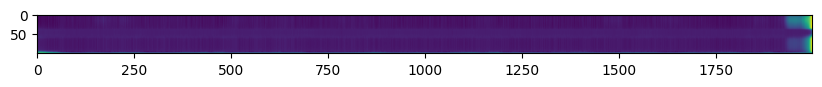

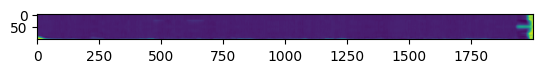

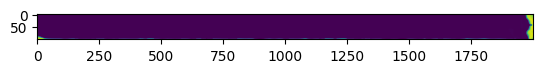

In [9]:
import matplotlib.pyplot as plt
plt.figure(figsize=(10, 20))
#x,y = next(iter(dataloader))
i=1
plt.imshow(x1[i, 113, :, :])
plt.show()
plt.imshow(x2[i, 113, :, :])
plt.show()
plt.imshow(y[i, 113, :, :])
plt.show()

In [11]:
len(h5_files)

61

In [7]:
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import DataLoader
import torch.nn.functional as F
from torch.utils.data import Dataset, DataLoader

class DoubleConv_down(nn.Module):
    
    """(convolution => [BN] => ReLU) * 2"""
    def __init__(self, in_channels, out_channels):
        super().__init__()
        self.double_conv = nn.Sequential(
            nn.Conv2d(in_channels, in_channels, kernel_size=1, padding=0),
            #nn.BatchNorm2d(in_channels),
            nn.ReLU(inplace=True),
            nn.Conv2d(in_channels, out_channels, kernel_size=1, padding=0),
            #nn.BatchNorm2d(200),
            nn.ReLU(inplace=True),
            #nn.Conv2d(200, out_channels, kernel_size=3, padding=1),
            #nn.BatchNorm2d(out_channels),
            #nn.ReLU(inplace=True)
        )

    def forward(self, x):
        return self.double_conv(x)

class DoubleConv_up(nn.Module):
    """(convolution => [BN] => ReLU) * 2"""
    def __init__(self, in_channels, out_channels):
        super().__init__()
        self.double_conv = nn.Sequential(
            nn.Conv2d(in_channels, 600, kernel_size=1, padding=0),
            #nn.BatchNorm2d(600),
            nn.ReLU(inplace=True),
            nn.Conv2d(600, 800, kernel_size=1, padding=0),
            #nn.BatchNorm2d(800),
            nn.ReLU(inplace=True),
            nn.Conv2d(800, out_channels, kernel_size=1, padding=0),
            #nn.BatchNorm2d(out_channels),
            nn.ReLU(inplace=True)
        )

    def forward(self, x):
        return self.double_conv(x)

class UNet(nn.Module):
    def __init__(self, n_channels, n_classes):
        super(UNet, self).__init__()
        self.n_channels = n_channels
        self.n_classes = n_classes

        #self.inc = DoubleConv_down(400, 256)
        self.up = DoubleConv_up(400, 1200)
        # Add more layers and upsampling layers to complete the U-Net structure

        #self.outc = nn.Conv2d(1200, 2000, kernel_size=1)

    def forward(self, x):
        x = x[0,:,:,:,:].permute(0,2,1,3)
        #x = self.inc(x)
        x = self.up(x)
        # Implement forward pass with upsampling and concatenations
        logits = self.outc(x)
        return logits


#class CustomDataset(Dataset):
#    def __init__(self, x, target):
#        """
#        Args:
#            data (numpy array): A numpy array of shape [N, 100, 200, 19] where N is the number of samples.
#        """
#        self.x = torch.tensor(x, dtype=torch.float32)
#        self.target = torch.tensor(target, dtype=torch.float32)#

#    def __len__(self):
#        return len(self.x)

 #   def __getitem__(self, idx):
 #       input = self.x[idx]
 #       target = self.target[idx]
 #       return input, target

In [8]:
import torch
import torch.nn as nn
import torch.nn.functional as F

class ChannelAttention(nn.Module):
    def __init__(self, num_channels, reduction_ratio=4):
        """
        Initializes the ChannelAttention module.
        
        :param num_channels: Number of input channels.
        :param reduction_ratio: Reduction ratio for the hidden layer in MLP.
        """
        super(ChannelAttention, self).__init__()
        self.num_channels = num_channels
        self.reduction_ratio = reduction_ratio

        # Define the MLP layers
        self.mlp = nn.Sequential(
            nn.Linear(num_channels, num_channels // reduction_ratio),
            nn.ReLU(),
            nn.Linear(num_channels // reduction_ratio, num_channels)
        )

    def forward(self, x):
        """
        Forward pass of the ChannelAttention module.
        
        :param x: Input tensor of shape (batch_size, num_channels, height, width).
        :return: Output tensor after applying channel attention.
        """
        # Global average pooling
        avg_pool = F.adaptive_avg_pool2d(x, (1, 1))
        avg_pool = avg_pool.view(avg_pool.shape[0], -1)

        # Channel attention
        attention = self.mlp(avg_pool)
        attention = torch.sigmoid(attention).view(attention.shape[0], attention.shape[1], 1, 1)

        # Scale the input by attention scores
        return x * attention

# Example of using the ChannelAttention module
# Assuming an input with 64 channels
#channel_att = ChannelAttention(num_channels=64)
#channel_att
### Import necessary packages
from torch import nn

### Squeeze and Excitation Class definition
class SE(nn.Module):
    def __init__(self, channel, reduction_ratio =2):
        super(SE, self).__init__()
        ### Global Average Pooling
        self.gap = nn.AdaptiveAvgPool2d(1)
        
        ### Fully Connected Multi-Layer Perceptron (FC-MLP)
        self.mlp = nn.Sequential(
            nn.Linear(channel, channel // reduction_ratio, bias=False),
            nn.ReLU(inplace=True),
            nn.Linear(channel // reduction_ratio, channel, bias=False),
            nn.Sigmoid()
        )

    def forward(self, x):
        b, c, _, _ = x.size()
        y = self.gap(x).view(b, c)
        y = self.mlp(y).view(b, c, 1, 1)
        return x * y.expand_as(x)

In [22]:
x.permute(0,1,3,2).permute(0,3,2,1).permute(0,3,1,2).shape

torch.Size([6, 114, 100, 400])

In [20]:
c = nn.Linear(400,6)
x2 = F.softmax(c(x), dim=2)
x2.shape

torch.Size([6, 114, 100, 6])

In [9]:
class UNet30(nn.Module):
    def __init__(self, inc, outc):
        super(UNet30, self).__init__()
        
        
        #self.fc1 = nn.Linear(2,1)
        #self.d1 = nn.Dropout(.6, inplace=True)
        self.fc2 = nn.Linear(2000,4000)
        #self.d2 = nn.Dropout(.4, inplace=True)
        self.fc3 = nn.Linear(4000,2000)
        self.fc4 = nn.Linear(2000,2000)
        self.fc5 = nn.Linear(2000,2000)
        self.fc6 = nn.Linear(2000,2000)
        
    def forward(self, x):
        #x = x.repeat_interleave(20, dim=3)
       # x = F.gelu(self.fc1(x))
        #x = self.d1(x)
        #x = x.squeeze()
        x = F.gelu(self.fc2(x))
        #x = self.d2(x)
        x = F.gelu(self.fc3(x))
        x = F.gelu(self.fc4(x))
        x = F.gelu(self.fc5(x))
        x = self.fc6(x)
        return x

class UNet3(nn.Module):
    def __init__(self, inc, outc):
        super(UNet3, self).__init__()
        
        
        self.fc1 = nn.Linear(8000,4000)
        self.fc2 = nn.Linear(4000,3000)
        self.fc3 = nn.Linear(3000,2000)
        self.fc4 = nn.Linear(2000,2000)
        #self.fc5 = nn.Linear(2000,2000)
        self.fc6 = nn.Linear(2000,2000)
        
    def forward(self, x):
        #mult_dim = 4000//x.shape[3]
        x = x.repeat_interleave(20, dim=3)
        x = F.gelu(self.fc1(x))
        #x = self.d1(x)
        #x = x.squeeze()
        x = F.gelu(self.fc2(x))
        #x = self.d2(x)
        x = F.gelu(self.fc3(x))
        #x = self.d3(x)
        x = F.gelu(self.fc4(x))
        #x = x*x0
        #x = F.gelu(self.fc5(x))
        x = self.fc6(x)
        return x

class UNet4(nn.Module):
    def __init__(self, inc, outc):
        super(UNet4, self).__init__()
        
        
        self.fc1 = nn.Linear(4000,2000)
        #self.d1 = nn.Dropout(.6, inplace=True)
        self.fc2 = nn.Linear(100,100)
        #self.d2 = nn.Dropout(.4, inplace=True)
        self.fc3 = nn.Linear(114,400)
        self.fc4 = nn.Linear(400,114)
        #self.fc5 = nn.Linear(2000,2000)
        #self.fc6 = nn.Linear(1000,2000)
        
    def forward(self, x):
        x = x.repeat_interleave(10, dim=3)
        x = F.gelu(self.fc1(x)).permute(0,1,3,2)
        #x = self.d1(x)
        #x = x.squeeze()
        x = F.gelu(self.fc2(x)).permute(0,3,2,1)
        #x = self.d2(x)
        x = F.gelu(self.fc3(x))
        x = (self.fc4(x)).permute(0,3,1,2)
        #x = F.gelu(self.fc5(x))
        #x = self.fc6(x)
        return x
        
class UNet1(nn.Module):
    def __init__(self, inc, outc):
        super(UNet1, self).__init__()
        
        
        self.fc1 = nn.Linear(400,4000)
        self.d1 = nn.Dropout(.4, inplace=True)
        #self.bn1 = nn.InstanceNorm2d(114)
        self.fc2 = nn.Linear(4000,4000)
        #self.bn2 = nn.BatchNorm2d(114)
        self.fc3 = nn.Linear(4000,1)
        
        #self.bn3 = nn.BatchNorm2d(114)
        #self.d3 = nn.Dropout(.2)
        self.fc4 = nn.Linear(100,1)
        #self.fc5 = nn.Linear(2000,2000)
        #self.fc6 = nn.Linear(2000,2000)
        #self.gap = nn.AvgPool2d( kernel_size=(100, 4000))

# Reshaping to get the final shape of [6, 114]
        #self.fc7 = nn.Linear(2000,2000)
        self.fc8 = nn.Linear(114,2000)
        self.fc9 = nn.Linear(2000,114)

    def forward(self, x):
        #x = x.repeat_interleave(10, dim=3)
        x = F.gelu(self.fc1(x))
        x = self.d1(x)
        #x = self.bn1(x)
        x = F.gelu(self.fc2(x))
        #x = self.bn2(x)
        #x = self.d2(x)
        x = F.gelu(self.fc3(x))
        #x = self.gap(x)
        x = x.squeeze()
        #x = self.bn3(x)
        #x = self.d3(x)
        x = F.gelu(self.fc4(x))
        x = x.squeeze()
        #x = F.gelu(self.fc5(x))
        #x = F.selu(self.fc6(x))
        #x = (self.fc7(x))
        x = F.gelu(self.fc8(x))
        x = self.fc9(x)


        return x
        
class UNet2(nn.Module):
    def __init__(self, inc, outc):
        super(UNet2, self).__init__()
        
        
        self.fc1 = nn.Linear(2000,2000)
        self.d1 = nn.Dropout(.6, inplace=True)
        #self.bn1 = nn.InstanceNorm2d(114)
        self.fc2 = nn.Linear(2000,2000)
        #self.bn2 = nn.BatchNorm2d(114)
        #self.d2 = nn.Dropout(.2, inplace=True)
        self.fc3 = nn.Linear(2000,4000)
        
        #self.bn3 = nn.BatchNorm2d(114)
        #self.d3 = nn.Dropout(.2)
        #self.fc4 = nn.Linear(2000,2000)
        #self.fc5 = nn.Linear(2000,2000)
        #self.fc6 = nn.Linear(2000,2000)
        self.gap = nn.AvgPool2d( kernel_size=(100, 4000))

# Reshaping to get the final shape of [6, 114]
        #self.fc7 = nn.Linear(2000,2000)
        self.fc8 = nn.Linear(114,2000)
        self.fc9 = nn.Linear(2000,114)

    def forward(self, x):
        x = x.repeat_interleave(5, dim=3)
        x = F.gelu(self.fc1(x))
        x = self.d1(x)
        #x = self.bn1(x)
        x = F.gelu(self.fc2(x))
        #x = self.bn2(x)
        #x = self.d2(x)
        x = F.gelu(self.fc3(x))
        x = (self.gap(x))
        x = x.squeeze()
        #x = self.bn3(x)
        #x = self.d3(x)
        #x = F.gelu(self.fc4(x))
        #x = F.gelu(self.fc5(x))
        #x = F.selu(self.fc6(x))
        #x = (self.fc7(x))
        x = F.gelu(self.fc8(x))
        x = self.fc9(x)


        return x

class UNet13(nn.Module):
    def __init__(self, inc, outc):
        super(UNet13, self).__init__()
        
        
        self.fc1 = nn.Linear(2000,2000)
        self.d1 = nn.Dropout(.6, inplace=True)
        #self.bn1 = nn.InstanceNorm2d(114)
        self.fc2 = nn.Linear(2000,2000)
        #self.bn2 = nn.BatchNorm2d(114)
        self.d2 = nn.Dropout(.2, inplace=True)
        self.fc3 = nn.Linear(2000,4000)
        
        #self.bn3 = nn.BatchNorm2d(114)
        #self.d3 = nn.Dropout(.2)
        #self.fc4 = nn.Linear(2000,2000)
        #self.fc5 = nn.Linear(2000,2000)
        #self.fc6 = nn.Linear(2000,2000)
        self.gap = nn.AvgPool2d( kernel_size=(100, 4000))

# Reshaping to get the final shape of [6, 114]
        #self.fc7 = nn.Linear(2000,2000)
        self.fc8 = nn.Linear(114,400)
        self.fc9 = nn.Linear(400,114)

    def forward(self, x):
        x = x.repeat_interleave(5, dim=3)
        x = F.gelu(self.fc1(x))
        x = self.d1(x)
        #x = self.bn1(x)
        x = F.gelu(self.fc2(x))
        #x = self.bn2(x)
        #x = self.d2(x)
        x = F.gelu(self.fc3(x))
        x = (self.gap(x))
        x = x.squeeze()
        #x = self.bn3(x)
        #x = self.d3(x)
        #x = F.gelu(self.fc4(x))
        #x = F.gelu(self.fc5(x))
        #x = F.selu(self.fc6(x))
        #x = (self.fc7(x))
        x = F.gelu(self.fc8(x))
        x = self.fc9(x)


        return x
        
class UNet10(nn.Module):
    def __init__(self, inc, outc):
        super(UNet10, self).__init__()
        
        #self.conv1 = nn.Conv2d(114, 228, (5, 5), stride=(1,1), padding=(2,2))
        self.fc1 = nn.Linear(2000,1000)
        self.d1 = nn.Dropout(.4)
        self.conv2 = nn.Conv2d(114, 228, (1, 1))
        self.fc2 = nn.Linear(1000,600)
        #self.bn1 = nn.BatchNorm2d(228)
        self.d2 = nn.Dropout(.2)
        self.conv3 = nn.Conv2d(228, 114, (3, 3), stride=(1,1), padding=(1,1))
        self.fc3 = nn.Linear(600,800)
        self.d3 = nn.Dropout(.1)
        self.fc4 = nn.Linear(800,1000)
        self.d4 = nn.Dropout(.08)
        self.fc5 = nn.Linear(1000,1200)
        self.d5 = nn.Dropout(.06)
        self.fc6 = nn.Linear(1200,1400)
        self.d6 = nn.Dropout(.04)
        self.fc7 = nn.Linear(1400,1600)
        self.d7 = nn.Dropout(.02)        
        self.fc8 = nn.Linear(1600,1800)
        
        self.fc9 = nn.Linear(1800,2000)
        


    def forward(self, x):
        x = x.repeat_interleave(5, dim=3)

        #x = F.gelu(self.conv1(x))
        x = F.silu(self.fc1(x))
        x = self.d1(x)
        x = F.silu(self.conv2(x))
        x = F.silu(self.fc2(x))
       # x = self.bn1(x)
        x = self.d2(x)
        x = F.silu(self.conv3(x))
        x = F.silu(self.fc3(x))
        x = self.d3(x)
        x = F.silu(self.fc4(x))
        x = self.d4(x)
        
        #x = F.gelu(self.conv2(x))
        x = F.silu(self.fc5(x))
        x = self.d5(x)
        x = F.silu(self.fc6(x))
        x = self.d6(x)
        x = F.silu(self.fc7(x))
        x = self.d7(x)
        x = F.silu(self.fc8(x))
        #x = F.gelu(self.conv3(x))
        #x = (self.conv4(x))
        #x = F.gelu(self.fc7(x))
        
        x = self.fc9(x)


        return x


class UNet11(nn.Module):
    def __init__(self, inc, outc):
        super(UNet11, self).__init__()
        
        
        #self.fc1 = nn.Linear(400,4000)
        #self.d1 = nn.Dropout(.6)
        #self.fc2 = nn.Linear(2000,4000)
        
        self.fc3 = nn.Linear(100,200)
        self.d2 = nn.Dropout(.4, inplace=True)
        #self.d3 = nn.Dropout(.2)
        self.fc4 = nn.Linear(90,180)
        self.d3 = nn.Dropout(.2)
        self.conv1 = nn.Conv2d(2000, 2000, (5, 5), stride=(2, 2), padding=(2, 2))

        self.fc5 = nn.Linear(2000,3000)
        self.fc6 = nn.Linear(3000,2000)
        #self.fc7 = nn.Linear(2000,2000)
        #self.fc8 = nn.Linear(2000,2000)


    def forward(self, x):
        #x = F.selu(self.fc1(x))
        #x = self.d1(x)
        #x = self.bn1(x)
        #x = F.selu(self.fc2(x))
        
        #x = x.permute(0,1,3,2)
        #x = F.selu(self.fc3(x))
        #x = self.d2(x)
        
        x = x.permute(0,3,2,1)
        #x = F.selu(self.fc4(x))
        #x = self.d3(x)
        
        x = F.selu(self.conv1(x))
        x = x.permute(0,3,2,1)
        x = F.selu(self.fc5(x))
        x = (self.fc6(x))
        #x = (self.fc7(x))
        #x = self.fc8(x)

        return x


class UNet12(nn.Module):
    def __init__(self, inc, outc):
        super(UNet12, self).__init__()
        
        self.fc1 = nn.Linear(2000,2000)
        self.d1 = nn.Dropout(.5)
        self.fc2 = nn.Linear(200,2000)
        self.d2 = nn.Dropout(.5)
        self.conv1 = nn.Conv2d(200,2000, kernel_size = 1)
        self.d3 = nn.Dropout(.5)
        #)
        #self.fc2 = nn.Linear(2000,2000)
       # self.d2 = nn.Dropout(.2)
        #self.fc3 = nn.Linear(2,1)
        #self.d3 = nn.Dropout(.05)
        self.fc4 = nn.Linear(2000,2000)
        #self.d4 = nn.Dropout(.3)
        self.fc5 = nn.Linear(2000,2000)
        #self.fc6 = nn.Linear(2000,2000)
        self.fc7 = nn.Linear(2000,2000)
        #self.fc8 = nn.Linear(2000,2000)


    def forward(self, x):
        x0 = x.repeat_interleave(10, dim=3)
        x0 = F.gelu(self.fc1(x0))
        x0 = self.d1(x0)
        x2 = F.gelu(self.fc2(x))
        x2 = self.d2(x2)
        x1 = F.gelu(self.conv1(x.permute(0,3,2,1))).permute(0,3,2,1)
        x1 = self.d3(x1)
        #print (x2.shape, x1.shape, x0.shape)
        x = F.scaled_dot_product_attention(x1, x2, x0)*x0
        #x0 = x0.unsqueeze(dim=4)
        #x = x.unsqueeze(dim=4)
        #x = torch.cat((x0,x),dim=4)
        #x = F.gelu(self.fc3(x))
        #x = x.squeeze(dim=4)
        x = F.silu(self.fc4(x))
        
        
       # 
        #x = self.bn1(x)
        #x = (self.fc2(x))
       # x = self.d2(x)
        #x = (self.fc3(x))
        #x = self.d4(x)
        #x = (self.fc4(x))
        x = F.gelu(self.fc5(x))
        #x = F.gelu(self.fc6(x))
        x = (self.fc7(x))


        return x

class UNet15(nn.Module):
    def __init__(self, inc, outc):
        super(UNet15, self).__init__()
        
        self.conv1 = nn.Conv2d(114, 10, (1, 1))
        self.fc1 = nn.Linear(400,20)
        self.d1 = nn.Dropout(.1)
        self.fc2 = nn.Linear(100,10)
        #self.d2 = nn.Dropout(.1)
        self.fc3 = nn.Linear(4*10*10*20,4*20*20*40)
        self.d3 = nn.Dropout(.25)
        self.conv2 = nn.Conv2d(20, 114, (1, 1))
        self.fc4 = nn.Linear(20,100)
        self.d4 = nn.Dropout(.1)
        self.fc5 = nn.Linear(40,600)
        self.d5 = nn.Dropout(.1)
        self.fc7 = nn.Linear(600,1600)
        #self.d7 = nn.Dropout(.25)        
        self.fc8 = nn.Linear(1600,1800)
        
        self.fc9 = nn.Linear(1800,2000)
        


    def forward(self, x):
        #x = x.repeat_interleave(5, dim=3)

        x = F.gelu(self.conv1(x))
        x = F.gelu(self.fc1(x))
        x = self.d1(x)
        x = x.permute(0,1,3,2)
        x = F.gelu(self.fc2(x))
        #x = self.d2(x)
        x  = torch.flatten(x)
        x = F.gelu(self.fc3(x))
        x = self.d3(x)
        x = torch.reshape(x, (4,20,40,20))
        x = F.gelu(self.conv2(x))
        x = F.gelu(self.fc4(x))
        x = self.d4(x)
        x = x.permute(0,1,3,2)
        x = F.gelu(self.fc5(x))
        x = self.d5(x)
        
        #x = F.gelu(self.conv2(x))

        x = F.gelu(self.fc7(x))
        #x = self.d7(x)
        x = F.gelu(self.fc8(x))
        #x = F.gelu(self.conv3(x))
        #x = (self.conv4(x))
        #x = F.gelu(self.fc7(x))
        
        x = self.fc9(x)


        return x

In [7]:
xtest

array(['/home/mbadhan/Desktop/mberghouse/PFLOTRAN/code/pt_files_bio/high_hanford_gain_14_10_2xscale.pt',
       '/home/mbadhan/Desktop/mberghouse/PFLOTRAN/code/pt_files_bio/high_hanford_gain_18_10_2xscale.pt',
       '/home/mbadhan/Desktop/mberghouse/PFLOTRAN/code/pt_files_bio/high_hanford_gain_24_17_2xscale.pt',
       '/home/mbadhan/Desktop/mberghouse/PFLOTRAN/code/pt_files_bio/high_hanford_gain_38_16_2xscale.pt',
       '/home/mbadhan/Desktop/mberghouse/PFLOTRAN/code/pt_files_bio/hanford_diff_lose_14_10_2xscale.pt',
       '/home/mbadhan/Desktop/mberghouse/PFLOTRAN/code/pt_files_bio/hanford_diff_lose_18_10_2xscale.pt',
       '/home/mbadhan/Desktop/mberghouse/PFLOTRAN/code/pt_files_bio/hanford_diff_lose_24_17_2xscale.pt',
       '/home/mbadhan/Desktop/mberghouse/PFLOTRAN/code/pt_files_bio/hanford_diff_lose_27_7_2xscale.pt',
       '/home/mbadhan/Desktop/mberghouse/PFLOTRAN/code/pt_files_bio/hanford_gain_14_10_2xscale.pt',
       '/home/mbadhan/Desktop/mberghouse/PFLOTRAN/code/pt_fil

In [43]:
4000//x.shape[3]

10

In [13]:
#xtest = ([h5_files_train[i] for i in range(len(h5_files_train)) if not i%5])
#ytest = ([h5_files[i] for i in range(len(h5_files)) if  not i%5])

test_dataset = VelDataset(xtest,ytest)
test_dataloader = DataLoader(test_dataset, batch_size=4, shuffle=False, drop_last=False, num_workers=0)
#model1.to(device)
#model1
len(ytest)

33

In [11]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model1 = UNet3(200, 2000).to(device)
#model1 = model1.to(torch.float16)

#model2 = UNet2(400, 800).to(device)

#model3 = UNet2(800, 1200).to(device)


#model4 = UNet2(1200, 1600).to(device)

#model5 = UNet2(1600, 2000).to(device)
model1

UNet3(
  (fc1): Linear(in_features=8000, out_features=4000, bias=True)
  (fc2): Linear(in_features=4000, out_features=3000, bias=True)
  (fc3): Linear(in_features=3000, out_features=2000, bias=True)
  (fc4): Linear(in_features=2000, out_features=2000, bias=True)
  (fc6): Linear(in_features=2000, out_features=2000, bias=True)
)

In [128]:
from torchmetrics import MeanSquaredLogError
MSLE = MeanSquaredLogError().to(device)
MSLE(outputs,labels)

tensor(0.0023, device='cuda:0', grad_fn=<SqueezeBackward0>)

array([ 0.10598613, -2.5306015 , -2.5126143 , -2.5216699 , -2.5845475 ,
       -2.6469173 , -2.582647  , -2.5341158 , -2.5038257 , -2.5110304 ,
       -2.530349  , -2.5745518 , -2.621638  , -2.5997891 , -2.603922  ,
       -2.5584881 , -2.4653914 , -2.4317133 , -2.4321246 , -2.4703925 ,
       -2.5365336 , -2.547555  , -2.554412  , -2.5542529 , -2.641001  ,
       -2.7465053 , -2.637411  , -2.6427324 , -2.6040897 , -2.597528  ,
       -2.5976977 , -2.6557662 , -2.7400613 , -2.8371694 , -2.81876   ,
       -2.9931016 , -3.0226097 , -2.8737981 , -2.7640827 , -2.770839  ,
       -2.7637827 , -2.7343826 , -2.8318636 , -2.8935046 , -2.834194  ,
       -2.8138437 , -2.802048  , -2.9300284 , -2.861051  , -2.8267844 ,
       -2.7821813 , -2.8000998 , -2.871986  , -2.944169  , -3.076169  ,
       -2.979424  , -2.8984568 , -2.9089196 , -3.0145776 , -2.9966977 ,
       -2.994381  , -2.9300253 , -2.9212043 , -3.0247374 , -3.0480237 ,
       -2.9748137 , -2.9275575 , -2.9626765 , -2.9553993 , -3.01

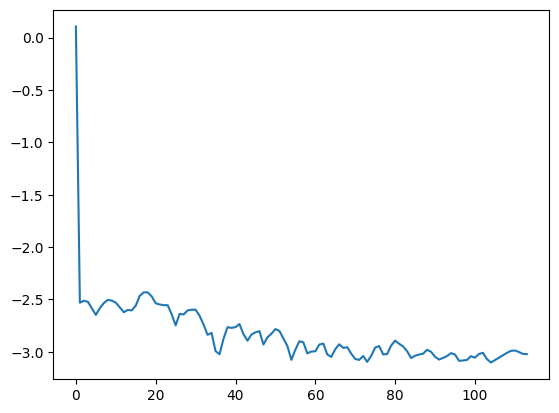

In [96]:
plt.plot(torch.mean(labels, dim=(2,3)).cpu().detach().numpy()[0])
torch.mean(labels, dim=(2,3)).cpu().detach().numpy()[0]

In [15]:
pool = nn.AvgPool2d( kernel_size=(1,4))
pool(inputs).shape

torch.Size([12, 114, 100, 100])

In [21]:
inputs.shape

torch.Size([2, 114, 100, 2000, 2])

In [38]:

np.random.choice(2, 1)[0]


1

In [12]:
import torch
from torch.utils.data import Dataset, DataLoader
from torch.optim.lr_scheduler import ExponentialLR
# from torchmetrics import MeanSquaredLogError
# MSLE = MeanSquaredLogError().to(device)
#class CustomDataset(Dataset):
#    def __init__(self, x, target):
#        """
#        Args:
#            data (numpy array): A numpy array of shape [N, 100, 200, 19] where N is the number of samples.
#        """
#        self.x = torch.tensor(x, dtype=torch.float32)
#        self.target = torch.tensor(target, dtype=torch.float32)#
#
#    def __len__(self):
#        return len(self.x)
#
#    def __getitem__(self, idx):
#        input = self.x[idx]
#        target = self.target[idx]
#        return input, target

#criterion3 = SmoothnessLoss(.1, .1)
#dataset = CustomDataset(x, y)
#dataloader = DataLoader(dataset, batch_size=1, shuffle=True)

# Model, loss, and optimizer
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
#criterion1 = DivLoss()
criterion2 = nn.MSELoss()
criterion3 = nn.HuberLoss()
criterion4 = nn.KLDivLoss()

optimizer1 = optim.Adam(model1.parameters(), lr=0.0002)

gamma = .999# The exponential decay factor (adjust as needed)
scheduler1 = ExponentialLR(optimizer1, gamma=gamma)

#import gc
n=2
# Training loop
num_epochs = 5000
for epoch in range(num_epochs):
    model1.train()
    count=0
    running_loss=0
    for batch in dataloader:
        
        inputs = batch[0].to(device)
        #inputs = inputs.repeat_interleave(10, dim=3)
        labels = batch[1].to(device)
        #labels = torch.mean(labels, dim=(2,3)).squeeze()
        optimizer1.zero_grad()
        outputs = model1(inputs)
        loss = criterion2(outputs, labels)
        #inputs = torch.mean(inputs, dim=(2,3)).squeeze()
        #max_loss = torch.abs(torch.max(outputs)-torch.max(labels))
        #min_loss = torch.abs(torch.min(outputs)-torch.min(labels))
        #for k in range(outputs.shape[0]):
        #    for i in range(outputs.shape[3]):
        #        out_ts.append(np.mean(outputs[k,:,:,i].cpu().detach().numpy()))
        
       # label_ts = []
       # for k in range(outputs.shape[0]):
        #out_ts = []
        #for k in range(outputs.shape[0]):
        #    for i in range(outputs.shape[1]):
        #        out_ts.append(np.mean(outputs[k,i,:,:].cpu().detach().numpy()))

        #label_ts = []
        #for k in range(outputs.shape[0]):
        #    for i in range(labels.shape[1]):
        #        label_ts.append(np.mean(labels[k,i,:,:].cpu().detach().numpy()))
        

        #loss = (loss1*4+loss2+loss3+loss4+loss5)/8

        #loss2 = criterion2(torch.tensor(out_ts), torch.tensor(label_ts))

        #loss3 = MSLE(outputs,labels)
        #if epoch<10:
        #    loss = (loss1+max_loss+loss2)/3
        #elif epoch<30:
        #    loss = loss1+.05*max_loss+.5*loss2
        #elif epoch<60:
        #    loss = loss1+.001*max_loss+.01*loss2
        #else:
        #    loss = loss1+.00001*max_loss+.0001*loss2
        #loss = loss1#+.001*max_loss
        loss.backward()
        optimizer1.step()
        scheduler1.step()
        count=count+1
        running_loss = running_loss+loss.item()
    # Model testing
    model1.eval()
    nn_errors=[]
    orig_errors=[]
    with torch.no_grad():
        for inputs2, labels2 in test_dataloader:
            inputs2 = inputs2.to(device)
            labels2= labels2.to(device)
            #lab = torch.mean(lab, dim=(2,3)).squeeze()
            
            outputs2 = model1(inputs2)          
            inputs2 = inputs2.repeat_interleave(5, dim=3)
            #inp = torch.mean(inp, dim=(2,3)).squeeze()
            nn_error = criterion2(outputs2, labels2)
            orig_error = criterion2(labels2, inputs2)
            nn_errors.append(nn_error.cpu().detach().numpy())
            orig_errors.append(orig_error.cpu().detach().numpy())
    print (np.mean(orig_errors), np.mean(nn_errors))
    current_lr = optimizer1.param_groups[0]['lr']
    print(f"Epoch {epoch+1}/{num_epochs}, Loss: {running_loss/count}, Learning Rate: {current_lr:.8f}")

1.3162047 0.55208665
Epoch 1/5000, Loss: 2.5293349160088434, Learning Rate: 0.00019821
1.2337543 0.5010066
Epoch 2/5000, Loss: 1.5570712486902873, Learning Rate: 0.00019643
1.1630028 0.39265898
Epoch 3/5000, Loss: 1.0645011564095814, Learning Rate: 0.00019467
1.2838656 0.39793733
Epoch 4/5000, Loss: 0.8882119490040673, Learning Rate: 0.00019292
1.2815995 0.38834378
Epoch 5/5000, Loss: 0.9130414989259508, Learning Rate: 0.00019120
1.2655065 0.39572787
Epoch 6/5000, Loss: 0.9279804163508945, Learning Rate: 0.00018948
1.2510549 0.353906
Epoch 7/5000, Loss: 0.8916358616616991, Learning Rate: 0.00018778
1.2238865 0.36341974
Epoch 8/5000, Loss: 0.8633255561192831, Learning Rate: 0.00018610
1.225876 0.37306276
Epoch 9/5000, Loss: 0.8497543103165097, Learning Rate: 0.00018443
1.2099234 0.3393022
Epoch 10/5000, Loss: 0.8320048219627805, Learning Rate: 0.00018278
1.2343137 0.34622565
Epoch 11/5000, Loss: 0.8965899844964346, Learning Rate: 0.00018114
1.3084539 0.38696596
Epoch 12/5000, Loss: 0.85

1.2209737 0.37162554
Epoch 95/5000, Loss: 0.2594609897997644, Learning Rate: 0.00008502
1.2212597 0.38474226
Epoch 96/5000, Loss: 0.2656283958090676, Learning Rate: 0.00008426
1.2077597 0.376574
Epoch 97/5000, Loss: 0.2689027239878972, Learning Rate: 0.00008350
1.2037627 0.36449656
Epoch 98/5000, Loss: 0.26236608293321395, Learning Rate: 0.00008275
1.2783786 0.38729867
Epoch 99/5000, Loss: 0.2630397594637341, Learning Rate: 0.00008201
1.2220076 0.3500642
Epoch 100/5000, Loss: 0.23679211073451573, Learning Rate: 0.00008128
1.248386 0.37371644
Epoch 101/5000, Loss: 0.23374674883153704, Learning Rate: 0.00008055
1.2165391 0.3824481
Epoch 102/5000, Loss: 0.22924165924390158, Learning Rate: 0.00007983
1.3665738 0.40750566
Epoch 103/5000, Loss: 0.22838351958327824, Learning Rate: 0.00007911
1.2735437 0.4151307
Epoch 104/5000, Loss: 0.21976533035437265, Learning Rate: 0.00007840
1.2156221 0.3688483
Epoch 105/5000, Loss: 0.21416472643613815, Learning Rate: 0.00007770
1.2308828 0.36129126
Epoch

KeyboardInterrupt: 

In [24]:
from earthformer.cuboid_transformer.cuboid_transformer import (
    CuboidTransformerModel,
)
model = CuboidTransformerModel([ 114, 100,  400,1], [ 114, 100,  2000,1], enc_depth=[1,1], dec_depth=[1,1])
model = model.to(device)
x,y = next(iter(dataloader))
model(x)

C:\Users\marcb\anaconda3\Lib\site-packages\torch\functional.py:507: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at C:\cb\pytorch_1000000000000\work\aten\src\ATen\native\TensorShape.cpp:3550.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]


In [26]:
model = model.to(device)
model(inputs)

ValueError: not enough values to unpack (expected 5, got 4)

In [15]:
dataloader = DataLoader(dataset, batch_size=8, shuffle=True,  num_workers=4, drop_last=False)
optimizer1 = optim.Adam(model1.parameters(), lr=0.0002)
gamma = .9999# The exponential decay factor (adjust as needed)
scheduler1 = ExponentialLR(optimizer1, gamma=gamma)
criterion3 = nn.L1Loss()
num_epochs = 100
for epoch in range(num_epochs):
    model1.train()
    count=0
    running_loss=0
    for batch in dataloader:
        inputs = batch[0].to(device)
        #inputs = inputs.repeat_interleave(10, dim=3)
        labels = batch[1].to(device)
        optimizer1.zero_grad()
        outputs = model1(inputs)
        loss = criterion2(outputs, labels)#[:,:,:,:, n])
        #loss2 = criterion3(outputs, labels)
        #max_loss = torch.abs(torch.max(outputs)-torch.max(labels))
        #loss = (loss1+loss2/8)/2
        loss.backward()
        optimizer1.step()
        scheduler1.step()
        count=count+1
        running_loss = running_loss+loss.item()
    model1.eval()
    nn_errors=[]
    orig_errors=[]
    with torch.no_grad():
        for inp, lab in test_dataloader:
            inp = inp.to(device)
            lab= lab.to(device)
            
            outp = model1(inp)
            inp = inp.repeat_interleave(10, dim=3)
            nn_error = criterion2(outp, lab)
            orig_error = criterion2(lab, inp)
            nn_errors.append(nn_error.cpu().detach().numpy())
            orig_errors.append(orig_error.cpu().detach().numpy())
    print (np.mean(orig_errors), np.mean(nn_errors))
    current_lr = optimizer1.param_groups[0]['lr']
    print(f"Epoch {epoch+1}/{num_epochs}, Loss: {running_loss/count}, Learning Rate: {current_lr:.8f}")

0.53690904 24.643707
Epoch 1/100, Loss: 7.51547257900238, Learning Rate: 0.00019990
0.53690904 114.48331
Epoch 2/100, Loss: 6.593371641635895, Learning Rate: 0.00019980
0.53690904 7.5248537
Epoch 3/100, Loss: 12.243613886833192, Learning Rate: 0.00019970
0.53690904 11.445052
Epoch 4/100, Loss: 3.566895627975464, Learning Rate: 0.00019960
0.53690904 1.5550746
Epoch 5/100, Loss: 3.1799699038267137, Learning Rate: 0.00019950
0.53690904 1.4047409
Epoch 6/100, Loss: 2.4055601328611376, Learning Rate: 0.00019940
0.53690904 3.8554616
Epoch 7/100, Loss: 2.6563375532627105, Learning Rate: 0.00019930
0.53690904 3.1588814
Epoch 8/100, Loss: 1.716558712720871, Learning Rate: 0.00019920
0.53690904 3.7061465
Epoch 9/100, Loss: 2.2098384737968444, Learning Rate: 0.00019910
0.53690904 2.1444054
Epoch 10/100, Loss: 2.3469573259353638, Learning Rate: 0.00019900
0.53690904 1.4676405
Epoch 11/100, Loss: 1.5381283402442931, Learning Rate: 0.00019890
0.53690904 0.8571886
Epoch 12/100, Loss: 1.59123072624206

KeyboardInterrupt: 

In [28]:
save_dataset = VelDataset(h5_files_train,h5_files)
save_dataloader = DataLoader(save_dataset, batch_size=4, shuffle=False,  num_workers=4, drop_last=False)


model1.eval()
outputs=torch.zeros((len(h5_files),114,100,2000))
count=0               
with torch.no_grad():
    for inp, lab in save_dataloader:
        inp = inp.to(device)
        #lab= lab.to(device)
        
        outp = model1(inp)
        outputs[count:count+4,:,:,:] = outp
        count = count+4

In [29]:



torch.save(outputs,'/home/mbadhan/Desktop/mberghouse/PFLOTRAN/code/full_1x.pt') 

ValueError: x and y can be no greater than 2D, but have shapes (105,) and (105, 100, 2000)

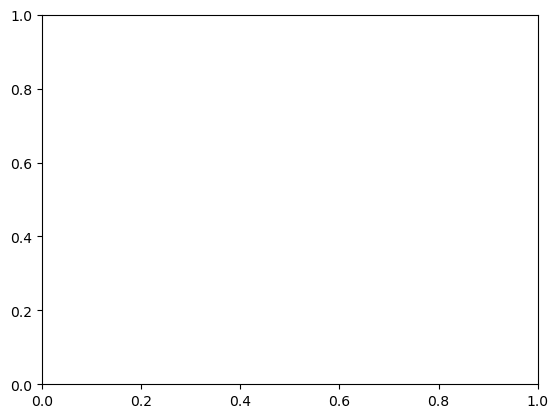

In [17]:
k=0
plt.plot(outputs.cpu().detach().numpy()[k])
plt.plot(labels.cpu().detach().numpy()[k])
plt.plot(inputs.cpu().detach().numpy()[k])

In [53]:
outp.shape
def moving_average(x, w):
    return np.convolve(x, np.ones(w), 'valid') / w

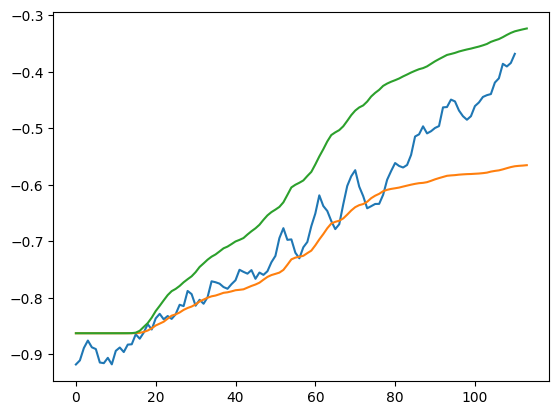

In [60]:
k=3
plt.plot(moving_average(outp.cpu().detach().numpy()[k], 4))
plt.plot(lab.cpu().detach().numpy()[k])
plt.plot(inp.cpu().detach().numpy()[k])

In [160]:
inputs.shape

torch.Size([8, 90, 100, 200])

In [14]:
torch.save(model1.state_dict(), 'weights_bio_overfit_big_fulltest_best_feb17')

In [70]:
import torch
device='cuda'
import torch.nn as nn
import torch.nn.functional as F
model_weights_path = 'C:/Users/marcb/OneDrive/Desktop/mberghouse/PFLOTRAN/code/weights_bio_overfit_big_fulltest_best_feb17'
class Upsample_small(nn.Module):
    def __init__(self, inc, outc):
        super(Upsample_small, self).__init__()
        
        
        
        self.fc1 = nn.Linear(8000,6000)

        #self.fc2 = nn.Conv2d(6, 114, kernel_size=(1,1))
        #self.fc2 = CuboidSelfAttentionLayer(4000, 20)
        self.fc2 = nn.Linear(6000,5000)
        self.fc3 = nn.Linear(5000,4000)
        self.fc4 = nn.Linear(4000,3000)
        self.fc5 = nn.Linear(3000,2000)
        self.fc6 = nn.Linear(2000,2000)
        
    def forward(self, x):
        #mult_dim = 4000//x.shape[3]
        x = x.repeat_interleave(20, dim=3)
        x = F.gelu(self.fc1(x))
        x = F.gelu(self.fc2(x))
        #x2 = x.unsqueeze(dim=0)
        #x2 = F.sigmoid(self.fc2(x2))
        #x = x*x2.squeeze()
        x = F.gelu(self.fc3(x))
        x = F.gelu(self.fc4(x))
        x = F.gelu(self.fc5(x))
        x = self.fc6(x)
        return x
model1 = Upsample_small(200, 2000).to(device)
model1.load_state_dict(torch.load(model_weights_path))
model1

Upsample_small(
  (fc1): Linear(in_features=16000, out_features=8000, bias=True)
  (fc3): Linear(in_features=8000, out_features=4000, bias=True)
  (fc8): Linear(in_features=4000, out_features=2000, bias=True)
  (fc10): Linear(in_features=2000, out_features=2000, bias=True)
)

In [2]:
import torch
import torch.nn as nn
import torch.optim as optim
import optuna
from torch.utils.data import DataLoader
import wandb

# Assuming 'dataloader' is already defined and loaded
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

class CustomModel(nn.Module):
    def __init__(self, layer_sizes, activation, dropout_rate):
        super(CustomModel, self).__init__()
        layers = []

        # First layer
        layers.append(nn.Linear(400, layer_sizes[0]))
        layers.append(self._get_activation(activation))
        layers.append(nn.Dropout(dropout_rate))

        # Middle layers
        for i in range(1, len(layer_sizes)):
            layers.append(nn.Linear(layer_sizes[i - 1], layer_sizes[i]))
            layers.append(self._get_activation(activation))
            if i < 2:
                layers.append(nn.Dropout(dropout_rate))

        # Last layer
        layers.append(nn.Linear(layer_sizes[-1], 2000))

        self.model = nn.Sequential(*layers)

    def _get_activation(self, activation):
        if activation == 'relu':
            return nn.ReLU()
        elif activation == 'rrelu':
            return nn.RReLU()
        elif activation == 'tanh':
            return nn.Tanh()

    def forward(self, x):
        return self.model(x)

def objective(trial):
    # Tunable parameters
    num_layers = trial.suggest_int("num_layers", 5, 10)
    layer_sizes = [trial.suggest_int(f"layer_size_{i}", 400, 2000) for i in range(num_layers - 2)]
    activation = trial.suggest_categorical("activation", ["relu", "rrelu", "tanh"])
    dropout_rate = trial.suggest_float("dropout_rate", 0.1, 0.6)
    optimizer_name = trial.suggest_categorical("optimizer", ["Adam", "AdamW"])
    lr = trial.suggest_float("lr", 6e-5, 6e-3)
    NUM_EPOCHS = 40
    wandb.init(project="optuna_pytorch_tuning", name=f"trial_{trial.number}")
    criterion = nn.MSELoss()


    model = CustomModel([400] + layer_sizes + [2000], activation, dropout_rate).to(device)
    optimizer = getattr(optim, optimizer_name)(model.parameters(), lr=lr)
    wandb.config.update({
        "num_layers": num_layers,
        "layer_sizes": layer_sizes,
        "activation": activation,
        "dropout_rate": dropout_rate,
        "optimizer": optimizer_name,
        "learning_rate": lr
    })

    for epoch in range(NUM_EPOCHS):  # Define NUM_EPOCHS as needed
        model.train()
        count=0
        running_loss=0
        for batch in dataloader:
            # Training loop (forward pass, loss calculation, backpropagation)           
        
            inputs = batch[0].to(device)
            inputs = inputs.float()
            labels = batch[1].to(device)
            labels = labels.float()
    
            optimizer.zero_grad()
            
            outputs = model(inputs)
           
            loss = criterion(outputs, labels)
            
            loss.backward()
            optimizer.step()
        
            #scheduler.step()
           
            count=count+1
            #running_loss = running_loss+loss.item()
        #print ("Train Loss: ", running_loss/(count*6))
        model.eval()
    # Iterate through the test data
        nn_errors=[]
        orig_errors=[]
        with torch.no_grad():
            for inputs, labels in test_dataloader:
                inputs = inputs.to(device)
                labels = labels.to(device)
                inputs = inputs.float()
                labels = labels.float()
                outputs = model(inputs)
                nn_error = criterion(outputs, labels)#[:,:,:,:,n])
                #inputs = inputs.repeat_interleave(5, dim=3)
                #orig_error = criterion2(labels, inputs)
                nn_errors.append(nn_error.cpu().detach().numpy())
                #orig_errors.append(orig_error.cpu().detach().numpy())
        wandb.log({"MSE": np.mean(nn_errors)})

    # Cleanup to save memory
    del model, optimizer
    torch.cuda.empty_cache()
    print(np.mean(nn_errors))
    wandb.finish()

    return  np.mean(nn_errors)  # Return the evaluation metric

pruner = optuna.pruners.MedianPruner(n_startup_trials=5, n_warmup_steps=10)

study = optuna.create_study(direction="minimize", pruner=pruner)
study.optimize(objective, n_trials=300)  # Define the number of trials

print("Best trial:")
trial = study.best_trial
print(f" Value: {trial.value}")
print(" Params: ")
for key, value in trial.params.items():
    print(f"    {key}: {value}")


ModuleNotFoundError: No module named 'optuna'

In [34]:
inputs.shape

torch.Size([10, 100, 100, 200])

In [22]:
inputs2.shape

torch.Size([4, 105, 100, 400])

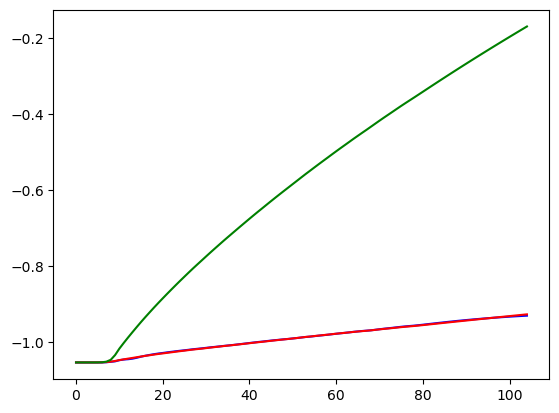

In [23]:
k=1
n=0

inputs.shape
out_ts = []
for i in range(outputs.shape[1]):
    out_ts.append(np.mean(outputs[k,i,:,:].cpu().detach().numpy()))

label_ts = []
for i in range(labels.shape[1]):
    label_ts.append(np.mean(labels[k,i,:,:].cpu().detach().numpy()))

inp_ts = []
for i in range(inputs.shape[1]):
    inp_ts.append(np.mean(inputs2[k,i,:,:].cpu().detach().numpy()))
    
#plt.yscale('log')
plt.plot(out_ts, c='b') 
plt.plot(label_ts, c='r')
plt.plot(inp_ts, c='g')

In [13]:
labels.shape

torch.Size([6, 114, 100, 2000])

In [12]:
k=0
inputs.shape
out_ts = []
for i in range(outputs.shape[3]):
    out_ts.append(np.mean(outputs[k,:,:,i].cpu().detach().numpy()))

label_ts = []
for i in range(labels.shape[3]):
    label_ts.append(np.mean(labels[k,:,:,i,1].cpu().detach().numpy()))

inp_ts = []
for i in range(inputs.shape[1]):
    inp_ts.append(np.mean(inputs[k,i,:,:,1].cpu().detach().numpy()))
    
plt.plot(out_ts, c='b') 
plt.plot(label_ts, c='r')
plt.plot(inp_ts, c='g')

IndexError: too many indices for tensor of dimension 4

In [46]:
torch.min(labels)

tensor(4.8552e-22, device='cuda:0')

In [39]:
x.shape
new_x=x.repeat_interleave(5, dim=3)

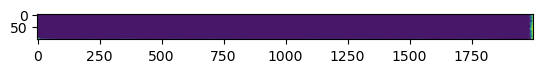

In [25]:
plt.imshow(outputs[0,89,:,:].cpu().detach().numpy())

In [19]:
torch.min(labels)
#labels
#outputs

tensor(1.4142e-25, device='cuda:0')

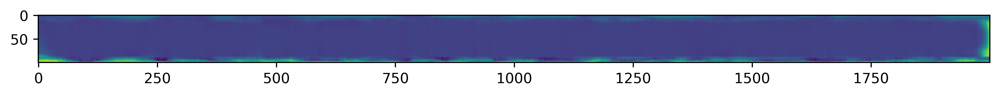

In [16]:
n=0
out = outp[0,104,:,:].cpu().detach().numpy()
#out[out<=0] = np.min(out[out>0])
import matplotlib.pyplot as plt
from matplotlib.colors import LogNorm
fig = plt.figure(figsize=(12,12), dpi=600)
plt.imshow(out)
#plt.imshow(inputs[0,100,:,:,n].cpu().detach().numpy())
#fig.savefig('label.png')  # Replace 'output.png' with your desired file path and format

#field_names[n]
#plt.colorbar()

#orig_error = np.abs(np.mean(inputs[0,:,:,:,n].cpu().detach().numpy()) - np.mean(labels[:,:,:,n].cpu().detach().numpy()))

#nn_error = np.abs(np.mean(outputs[:,:,:].cpu().detach().numpy()) - np.mean(labels[:,:,:,n].cpu().detach().numpy()))
#print (orig_error, nn_error)

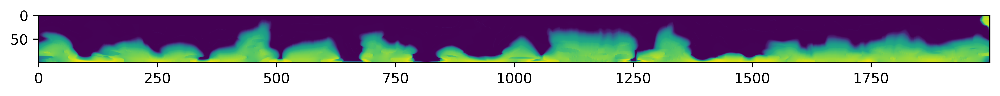

In [17]:
n=1
out = labels[0,110,:,:].cpu().detach().numpy()
#out[out<=0] = np.min(out[out>0])
import matplotlib.pyplot as plt
from matplotlib.colors import LogNorm
fig = plt.figure(figsize=(12,12), dpi=600)
plt.imshow(out)
#plt.imshow(inputs[0,100,:,:,n].cpu().detach().numpy())
#fig.savefig('label.png')  # Replace 'output.png' with your desired file path and format

#field_names[n]
#plt.colorbar()

#orig_error = np.abs(np.mean(inputs[0,:,:,:,n].cpu().detach().numpy()) - np.mean(labels[:,:,:,n].cpu().detach().numpy()))

#nn_error = np.abs(np.mean(outputs[:,:,:].cpu().detach().numpy()) - np.mean(labels[:,:,:,n].cpu().detach().numpy()))
#print (orig_error, nn_error)

In [ ]:
### test_dataset = VelDataset(h5_files_train[41:], h5_files[41:])
test_dataloader = DataLoader(test_dataset, batch_size=2, shuffle=False,  num_workers=0)

In [1]:
features=[#'Chubbite_Rate [mol_m^3_sec]',
  #'Chubbite_VF [m^3 mnrl_m^3 bulk]',
  'Liquid X-Velocity [m_per_h]',
  'Liquid Y-Velocity [m_per_h]',
  #'Liquid Z-Velocity [m_per_h]',
  'Liquid_Pressure [Pa]',
  #'Liquid_Saturation',
  #'Material_ID',
  #'Permeability_X [m^2]',
  'Porosity',
  'Temperature [C]',
  #'Total_CO2 [M]',
  'Total_Cr(VI) [M]',
  #'Total_O2 [M]',
  #'Total_biocide [M]',
  #'Total_ethanol [M]',
  'Total_molasses [M]',
  'biomass [mol_m^3]',
  'molasses_im [mol_m^3]',
]
features[7]

'biomass [mol_m^3]'

In [5]:
len(h5_files_train_1x)

0

## Model Testing/Retraining

In [1]:
import sklearn
import matplotlib.pyplot as plt
import os
import numpy as np
import h5py
#import cv2
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import DataLoader
import torch.nn.functional as F
from torch.utils.data import Dataset, DataLoader

base_dir = 'C:/Users/marcb/OneDrive/Desktop/mberghouse/PFLOTRAN/code/pt_files_bio/'
f_dir = os.listdir(base_dir)
h5_files = []
h5_files_train = []
h5_files_train_1x = []
# Iterate over all files in the directory
for filename in f_dir:
    if (filename.endswith(".pt")) & ((("2x" in filename))):
        h5_files_train.append(base_dir+filename)
    if (filename.endswith(".pt")) & ((("1x" in filename))):
        h5_files_train_1x.append(base_dir+filename)
#     if (filename.endswith(".h5")) & (("8x" in filename)):
#         if (("10_5" not in filename) & ("20_20" not in filename)):
#             h5_files_train.append(base_dir+filename)
    if (filename.endswith(".pt")) & ((("10x" in filename))):
#         if (("10_5" in filename) | ("20_20" in filename)):
        h5_files.append(base_dir+filename)
# Run the processing in parallel


#h5_files = h5_files[0:6]
#h5_files_train = h5_files_train[0:6]
from torch.utils.data import Dataset

h5_files = np.sort(h5_files)
h5_files_train=np.sort(h5_files_train)
h5_files_train_1x=np.sort(h5_files_train_1x)
import albumentations as A

num_time_steps = 80
num_features = 6  # As observed from the dataset

import torch
import torch.nn.functional as F

def coarse_dropout(x,size=(50, 50), fill_value=0):
    """
    Applies Coarse Dropout to the input tensor.
    
    Parameters:
        x (torch.Tensor): Input tensor (C x H x W).
        p (float): Probability of dropout.
        size (tuple): Size of the dropout regions.
        fill_value (int): Value to fill in the dropped regions.
        
    Returns:
        torch.Tensor: Tensor after applying coarse dropout.
    """
    c, h, w = x.size()
    mask = torch.ones(size, dtype=torch.float32, device=x.device)
    mask = F.pad(mask, (0, w - size[1], 0, h - size[0]), "constant", 0)
    mask = mask.unsqueeze(0).repeat(c, 1, 1)  # Repeat for each channel
    x = x * mask + (1 - mask) * fill_value
    return x

import torch

def pixel_dropout_with_position(input_tensor, label_tensor, p=0.01, x_extension=9, label_x_multiplier=10, fill_value=0):
    """
    Applies Pixel Dropout to the input tensor and a modified dropout to the label tensor.
    
    Parameters:
        input_tensor (torch.Tensor): Input tensor (C x H x W).
        label_tensor (torch.Tensor): Label tensor (C x H x W'), where W' is 10x W of input_tensor.
        p (float): Probability of dropping a pixel.
        x_extension (int): Number of pixels to extend in the x dimension for dropped pixels in the input tensor.
        label_x_multiplier (int): Factor by which the label tensor's width is larger than the input tensor's width.
        fill_value (int): Value to fill in the dropped pixels.
        
    Returns:
        torch.Tensor: Tensor after applying pixel dropout to input.
        torch.Tensor: Tensor after applying modified pixel dropout to label.
    """
    # Create dropout mask for input tensor
    input_mask = torch.bernoulli(torch.ones_like(input_tensor) * (1 - p))
    
    # Apply mask to input tensor
    input_dropped = input_tensor * input_mask + (1 - input_mask) * fill_value
    
    # Prepare to adjust mask for label tensor with extended width
    label_mask = input_mask.repeat_interleave(label_x_multiplier, dim=2)
    
    # Adjust mask for label tensor based on recorded dropout positions, considering label's width
#     for y, x in zip(*input_mask.nonzero(as_tuple=True)[1:]):  # Skipping channel dimension
#         start_x = max(x * label_x_multiplier - x_extension, 0)
#         end_x = min((x + 1) * label_x_multiplier + x_extension, label_tensor.size(2))
#         label_mask[:, y, start_x:end_x] = 0
    
    # Apply adjusted mask to label tensor
    label_dropped = label_tensor * label_mask + (1 - label_mask) * fill_value
    
    return input_dropped, label_dropped





# input_dropped and label_dropped now have the specified dropout applied, with positions recorded and adjusted as described.




def custom_augment(input_tensor, label_tensor):
    
    
    """
    Apply custom augmentations to the input and label tensors with specified probabilities.
    
    Args:
        input_tensor (torch.Tensor): The input tensor with shape [B, T, W, H] where H=400.
        label_tensor (torch.Tensor): The label tensor with shape [B, T, W, H] where H=2000.
    
    Returns:
        Tuple[torch.Tensor, torch.Tensor]: The augmented input and label tensors.
    """
    # Scale augmentation with a 25% chance
    if random.random() < 0.5:
        scale_factor = random.uniform(.99, 1.01)
        input_tensor *= scale_factor
        label_tensor *= scale_factor
    #if random.random() < 1:
#     _, H, W = input_tensor.shape

#     top = random.randint(5, H - 6)
#     left = random.randint(5, W - 11)
#     input_tensor[:, top:top+5, left:left+10] = 0


   # label_tensor[:, top:-1, left:left+W] = label_tensor[:, top:-1, left-j:left-j+W]
    # # Flip across the vertical axis (W dimension) with a 50% chance
    if random.random() < 0.5:
        input_tensor = input_tensor.flip(dims=[-2])  # Assuming W=50 is the middle axis for flipping
        label_tensor = label_tensor.flip(dims=[-2])

    # # Flip across the horizontal axis (H dimension) for input and label with a 50% chance
#     if random.random() < 0.5:
#         # # For input, assuming H=200 is the middle
#         input_tensor = input_tensor.flip(dims=[-1])  # Flipping the last dimension (H)
#         # # For label, assuming H=1000 is the middle
#         label_tensor = label_tensor.flip(dims=[-1])
    if random.random() < 0.5:
        # # For input, assuming H=200 is the middle
        input_tensor = input_tensor.flip(dims=[-3])  # Flipping the last dimension (H)
        # # For label, assuming H=1000 is the middle
        label_tensor = label_tensor.flip(dims=[-3])
#     if random.random() < 0.5:
#         # Assuming `x` is your input tensor of shape (C, H, W)
#         label_tensor = coarse_dropout(label_tensor, size=(50, 50), fill_value=0)
    if random.random() < 0.5:
        input_tensor, label_tensor = pixel_dropout_with_position(input_tensor, label_tensor, p=0.02, 
                                                                  x_extension=9, label_x_multiplier=10, fill_value=0)

    # if random.random()<.75:
        # input_tensor = rlvm1(input_tensor)  # Flipping the last dimension (H)
        # # For label, assuming H=1000 is the middle
        # label_tensor = rlvm2(label_tensor)
    return input_tensor, label_tensor

class VelDataset_aug(Dataset):
    def __init__(self, x_fname, target_fname):
        self.x_fname = x_fname
        self.target_fname = target_fname

    def __len__(self):
        return len(self.x_fname)

    def __getitem__(self, idx):
        file1 = self.x_fname[idx]
        file2 = self.target_fname[idx]
        low_scale = torch.load(file1)[:,:,:,0].float()
        high_scale = torch.load(file2)[:,:,:,0].float()
        #low_scale = (low_scale-torch.min(low_scale))/(torch.max(low_scale)-torch.min(low_scale))
#         high_scale = (high_scale-torch.min(high_scale))/(torch.max(high_scale)-torch.min(high_scale))
        low_scale, high_scale = custom_augment(low_scale, high_scale)
        
        
        return low_scale, high_scale

class VelDataset(Dataset):
    def __init__(self, x_fname, target_fname):
        self.x_fname = x_fname
        self.target_fname = target_fname

    def __len__(self):
        return len(self.x_fname)

    def __getitem__(self, idx):
        file1 = self.x_fname[idx]
        file2 = self.target_fname[idx]
        low_scale = torch.load(file1)[:,:,:,0].float()
        high_scale = torch.load(file2)[:,:,:,0].float()
        
        return low_scale, high_scale
    
class PorDataset(Dataset):
    def __init__(self, x_fname, target_fname):
        self.x_fname = x_fname
        self.target_fname = target_fname

    def __len__(self):
        return len(self.x_fname)

    def __getitem__(self, idx):
        file1 = self.x_fname[idx]
        file2 = self.target_fname[idx]
        low_scale = torch.load(file1)[113,:,:,0].float()
        high_scale = torch.load(file2)[113,:,:,0].float()

        return low_scale, high_scale
		
arr = h5_files
contains_hanford = np.array(['hanford' in item for item in arr])

# Alphabetical sorting key
alphabetical_order = np.argsort(arr)

# Prioritize "hanford" and then sort alphabetically within each group
sorted_indices = np.lexsort((alphabetical_order, ~contains_hanford))

# Use sorted indices to reorder the array
sorted_arr = arr[sorted_indices]
sorted_arr

sorted_arr2 = h5_files_train_1x[sorted_indices]
xtest = sorted_arr2[0:36]
xtrain = sorted_arr2[36:]#np.concatenate([sorted_arr2[33:50:3], sorted_arr2[50:]])


ytest = sorted_arr[0:36]
ytrain = sorted_arr[36:]#np.concatenate([sorted_arr[33:50:3], sorted_arr[50:]])
print(ytrain)


#xtrain = ([h5_files_train[i] for i in range(len(h5_files_train)) if i%5])
#ytrain = ([h5_files[i] for i in range(len(h5_files)) if  i%5])

import random


['C:/Users/marcb/OneDrive/Desktop/mberghouse/PFLOTRAN/code/pt_files_bio/gaining_17_22_10xscale.pt'
 'C:/Users/marcb/OneDrive/Desktop/mberghouse/PFLOTRAN/code/pt_files_bio/gaining_22_16_10xscale.pt'
 'C:/Users/marcb/OneDrive/Desktop/mberghouse/PFLOTRAN/code/pt_files_bio/gaining_25_15_10xscale.pt'
 'C:/Users/marcb/OneDrive/Desktop/mberghouse/PFLOTRAN/code/pt_files_bio/gaining_27_7_10xscale.pt'
 'C:/Users/marcb/OneDrive/Desktop/mberghouse/PFLOTRAN/code/pt_files_bio/gaining_30_15_10xscale.pt'
 'C:/Users/marcb/OneDrive/Desktop/mberghouse/PFLOTRAN/code/pt_files_bio/gaining_33_24_10xscale.pt'
 'C:/Users/marcb/OneDrive/Desktop/mberghouse/PFLOTRAN/code/pt_files_bio/gaining_34_6_10xscale.pt'
 'C:/Users/marcb/OneDrive/Desktop/mberghouse/PFLOTRAN/code/pt_files_bio/gaining_36_11_10xscale.pt'
 'C:/Users/marcb/OneDrive/Desktop/mberghouse/PFLOTRAN/code/pt_files_bio/gaining_38_16_10xscale.pt'
 'C:/Users/marcb/OneDrive/Desktop/mberghouse/PFLOTRAN/code/pt_files_bio/gaining_40_17_10xscale.pt'
 'C:/Users/m

In [2]:

# ytrain2 = [element for element in ytrain if '8' not in str(element)]

# xtrain2 = [element for element in xtrain if '8' not in str(element)]
# ytest2 = [element for element in ytest if '8' in str(element)]
# xtest2 = [element for element in xtest if '8' in str(element)]

dataset = VelDataset_aug(xtrain,ytrain)
dataloader = DataLoader(dataset, batch_size=8, shuffle=True,  num_workers=0, drop_last=False)


dataset = VelDataset(xtest,ytest)
test_dataloader = DataLoader(dataset, batch_size=8, shuffle=False,  num_workers=0, drop_last=False)

ytrain

array(['C:/Users/marcb/OneDrive/Desktop/mberghouse/PFLOTRAN/code/pt_files_bio/gaining_17_22_10xscale.pt',
       'C:/Users/marcb/OneDrive/Desktop/mberghouse/PFLOTRAN/code/pt_files_bio/gaining_22_16_10xscale.pt',
       'C:/Users/marcb/OneDrive/Desktop/mberghouse/PFLOTRAN/code/pt_files_bio/gaining_25_15_10xscale.pt',
       'C:/Users/marcb/OneDrive/Desktop/mberghouse/PFLOTRAN/code/pt_files_bio/gaining_27_7_10xscale.pt',
       'C:/Users/marcb/OneDrive/Desktop/mberghouse/PFLOTRAN/code/pt_files_bio/gaining_30_15_10xscale.pt',
       'C:/Users/marcb/OneDrive/Desktop/mberghouse/PFLOTRAN/code/pt_files_bio/gaining_33_24_10xscale.pt',
       'C:/Users/marcb/OneDrive/Desktop/mberghouse/PFLOTRAN/code/pt_files_bio/gaining_34_6_10xscale.pt',
       'C:/Users/marcb/OneDrive/Desktop/mberghouse/PFLOTRAN/code/pt_files_bio/gaining_36_11_10xscale.pt',
       'C:/Users/marcb/OneDrive/Desktop/mberghouse/PFLOTRAN/code/pt_files_bio/gaining_38_16_10xscale.pt',
       'C:/Users/marcb/OneDrive/Desktop/mberghou

In [3]:
x,y = next(iter(dataloader))

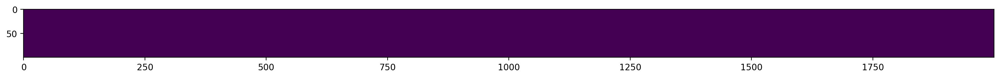

In [4]:
import matplotlib.pyplot as plt
plt.figure(figsize=(20,20), dpi=200)
plt.imshow(y[0,113,:,:])

In [5]:
torch.max(x[1,110,:,:])

tensor(0.)

In [6]:
import torch
import torch.nn as nn
import torch.nn.functional as F

In [7]:
# import torchvision
# model_swin=torchvision.models.video.swin3d_s()#weights='KINETICS400_V1')
# model = nn.Sequential(model_swin, nn.Linear(400, 15*100*2000), nn.GELU(inplace=True))
# model

In [8]:
# device='cuda'
# shape_of_input = [4,3,20,100,400]   # [batch_size, channels, frames, height, width]
# dummy_video = torch.rand(shape_of_input).to(device)
# model = model.to(device)
# output = model(dummy_video)
# output = output.view(4, 20, 100, 2000)

# print(output.shape)

In [9]:
import torch
device='cuda'
import torch.nn as nn
import torch.nn.functional as F
# model_weights_path = 'C:/Users/marcb/OneDrive/Desktop/weights_bio_2_21_aug'
# class SE(nn.Module):
#     def __init__(self, channel, reduction_ratio =2):
#         super(SE, self).__init__()
#         ### Global Average Pooling
#         self.gap = nn.AdaptiveAvgPool2d(1)
        
#         ### Fully Connected Multi-Layer Perceptron (FC-MLP)
#         self.mlp = nn.Sequential(
#             nn.Linear(channel, channel // reduction_ratio, bias=False),
#             nn.ReLU(inplace=True),
#             nn.Linear(channel // reduction_ratio, channel, bias=False),
#             nn.Sigmoid()
#         )

#     def forward(self, x):
#         b, _, _, h = x.size()
#         x = x.permute(0,3,2,1)
#         y = self.gap(x).view(b, h)
#         y = self.mlp(y).view(b, 1, 1, h)
#         x = x.permute(0,3,2,1)
#         return x * y.expand_as(x)

# import torch
# import torch.nn as nn
# import torch.nn.functional as F

# class SE100(nn.Module):
#     def __init__(self, channel, reduction_ratio =2):
#         super(SE100, self).__init__()
#         ### Global Average Pooling
#         self.gap = nn.AdaptiveAvgPool2d(1)
        
#         ### Fully Connected Multi-Layer Perceptron (FC-MLP)
#         self.mlp = nn.Sequential(
#             nn.Linear(channel, channel // reduction_ratio, bias=False),
#             nn.ReLU(inplace=True),
#             nn.Linear(channel // reduction_ratio, channel, bias=False),
#             nn.Sigmoid()
#         )

#     def forward(self, x):
#         b, _, w, _ = x.size()
#         x = x.permute(0,2,1,3)
#         y = self.gap(x).view(b, w)
#         y = self.mlp(y).view(b, 1, w, 1)
#         x = x.permute(0,2,1,3)
#         return x * y.expand_as(x)
        
# class Upsample_small(nn.Module):
#     def __init__(self, inc, outc):
#         super(Upsample_small, self).__init__()
        
        
#         #self.fc1 = nn.Conv2d(114, 5, (5, 5), stride=(2, 2), padding=(2, 2), dilation=(1, 1))
#         self.fc1 = nn.Linear(16000,8000)
#         #self.fc2 = nn.Linear(12000,8000)
#         self.fc3 = nn.Linear(8000,4000)

#         self.fc8 = nn.Linear(4000,2000)
#         #self.fc9 = nn.Linear(3000,2000)
#         self.fc10 = nn.Linear(2000,2000)
        
#     def forward(self, x):
#         #mult_dim = 4000//x.shape[3]
#         x = x.repeat_interleave(40, dim=3)
#         #x=x.expand(-1,-1,-1,400)
#         x = F.relu(self.fc1(x), inplace=True)
#         #x = F.rrelu(self.fc2(x), inplace=True)

#         x = F.relu(self.fc3(x), inplace=True)

#         x = F.relu(self.fc8(x), inplace=True)
#         #x = F.rrelu(self.fc9(x), inplace=True)
#         x = self.fc10(x)
#        # print(x.shape)
#         return x


import torch
device='cuda'
import torch.nn as nn
import torch.nn.functional as F

model_weights_path1 = 'C:/Users/marcb/OneDrive/Desktop/mberghouse/PFLOTRAN/code/weights_bio2_small_fulltest_best_feb4'
model_weights_path2 = 'C:/Users/marcb/OneDrive/Desktop/mberghouse/PFLOTRAN/code/weights_bio_small'
model_weights_path3 = 'C:/Users/marcb/OneDrive/Desktop/mberghouse/PFLOTRAN/code/weights_bio2_small_fulltest_best_feb4_3'

class Upsample_small1(nn.Module):
    def __init__(self, inc, outc):
        super(Upsample_small1, self).__init__()
        
        
        
        self.fc1 = nn.Linear(2000,2000)
#         self.d1 = nn.Dropout(.5)

        #self.fc2 = nn.Conv2d(6, 114, kernel_size=(1,1))
        #self.fc2 = CuboidSelfAttentionLayer(4000, 20)
        self.fc2 = nn.Linear(2000,2000)
        self.fc3 = nn.Linear(2000,2000)
        self.fc4 = nn.Linear(2000,2000)
        #self.fc5 = nn.Linear(3000,2000)
        self.fc8 = nn.Linear(2000,2000)
        
    def forward(self, x):
        #mult_dim = 4000//x.shape[3]
        x = x.repeat_interleave(10, dim=3)
        x = F.gelu(self.fc1(x))
#         x = self.d1(x)
        x = F.gelu(self.fc2(x))
        #x2 = x.unsqueeze(dim=0)
        #x2 = F.sigmoid(self.fc2(x2))
        #x = x*x2.squeeze()
        x = F.gelu(self.fc3(x))
        x = F.gelu(self.fc4(x))
        #x = F.gelu(self.fc5(x))
        x = (self.fc8(x))
        return x

class Upsample_small2(nn.Module):
    def __init__(self, inc, outc):
        super(Upsample_small2, self).__init__()
        
        
        
        self.fc1 = nn.Linear(2000,4000)
#         self.d1 = nn.Dropout(.5)

        #self.fc2 = nn.Conv2d(6, 114, kernel_size=(1,1))
        #self.fc2 = CuboidSelfAttentionLayer(4000, 20)
        self.fc2 = nn.Linear(4000,3000)
        self.fc3 = nn.Linear(3000,2000)
        #self.fc4 = nn.Linear(4000,3000)
        #self.fc5 = nn.Linear(3000,2000)
        self.fc6 = nn.Linear(2000,2000)
        
    def forward(self, x):
        #mult_dim = 4000//x.shape[3]
        x = x.repeat_interleave(10, dim=3)
        x = F.gelu(self.fc1(x))
#         x = self.d1(x)
        x = F.gelu(self.fc2(x))
        #x2 = x.unsqueeze(dim=0)
        #x2 = F.sigmoid(self.fc2(x2))
        #x = x*x2.squeeze()
        x = F.gelu(self.fc3(x))
        #x = F.gelu(self.fc4(x))
        #x = F.gelu(self.fc5(x))
        x = (self.fc6(x))
        return x
    
class Upsample_small(nn.Module):
    def __init__(self, inc, outc):
        super(Upsample_small, self).__init__()
        
        
        
        self.fc1 = nn.Linear(2000,6000)
#         self.d1 = nn.Dropout(.5)

        #self.fc2 = nn.Conv2d(6, 114, kernel_size=(1,1))
        #self.fc2 = CuboidSelfAttentionLayer(4000, 20)
        self.fc2 = nn.Linear(3000,4000)
        self.fc3 = nn.Linear(2000,4000)
        #self.fc4 = nn.Linear(4000,3000)
        self.fc5 = nn.Linear(2000,4000)
        self.fc6 = nn.Linear(2000,4000)
        self.fc7 = nn.Linear(2000,2000)
        
    def forward(self, x):
        #mult_dim = 4000//x.shape[3]
        
        x = x.repeat_interleave(10, dim=3)
        x = F.glu(self.fc1(x))
#         x = self.d1(x)
        x = F.glu(self.fc2(x))
        #x2 = x.unsqueeze(dim=0)
        #x2 = F.sigmoid(self.fc2(x2))
        #x = x*x2.squeeze()
        x = F.glu(self.fc3(x))
        #x = F.gelu(self.fc4(x))
        x = F.glu(self.fc5(x))
        x = F.glu(self.fc6(x))
        x = self.fc7(x)
        return x

class Upsample_new(nn.Module):
    def __init__(self,  model_seq):
        super(Upsample_new, self).__init__()
        
        
        self.fc0 = nn.Linear(200,60)
        self.fc1 = model_seq
#         self.d1 = nn.Dropout(.5)

        #self.fc2 = nn.Conv2d(6, 114, kernel_size=(1,1))
        #self.fc2 = CuboidSelfAttentionLayer(4000, 20)
        self.fc2 = nn.Linear(60,200)
        self.fc4 = nn.Linear(200,1000)
        self.fc3 = nn.Linear(1000,2000)
        
        #self.fc5 = nn.Linear(3000,2000)
#         self.fc6 = nn.Linear(2000,2000)
#         self.fc7 = nn.Linear(2000,2000)
        
    def forward(self, x):
        #mult_dim = 4000//x.shape[3]
        #x = x.repeat_interleave(10, dim=3)
        x = F.gelu(self.fc0(x))
        x=x.unsqueeze(1).repeat(1,3,1,1,1)
        x = self.fc1(x)
        x = torch.reshape(x, [5, 114, 100, 60])
        #x = F.gelu(self.fc1(x))
#         x = self.d1(x)
        x = F.gelu(self.fc2(x))
        #x2 = x.unsqueeze(dim=0)
        x = F.gelu(self.fc4(x))
        #x = x*x2.squeeze()
        x = (self.fc3(x))
        #x = F.gelu(self.fc4(x))
        #x = F.gelu(self.fc5(x))
#         x = F.rrelu(self.fc6(x))
#         x = self.fc7(x)
        return x

model = Upsample_small(200, 2000).to(device)

# model2 = Upsample_small1(200, 2000).to(device)
# model3 = Upsample_small(200, 2000).to(device)
# # model4 = Upsample_small(200, 2000).to(device)
# # model5 = Upsample_small(200, 2000).to(device)
#model.load_state_dict(torch.load(model_weights_path3))
# model2.load_state_dict(torch.load(model_weights_path2))
# model3.load_state_dict(torch.load(model_weights_path3))
# # model4.load_state_dict(torch.load(model_weights_path4))
# # model5.load_state_dict(torch.load(model_weights_path5))
# #model3 = torch.compile(model3, mode="reduce-overhead")
# model3

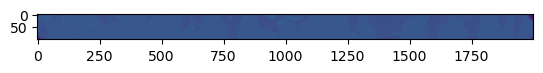

In [10]:
x,y = next(iter(dataloader))
import matplotlib.pyplot as plt
plt.imshow(y[0,100,:,:])

tensor([[[[ 1.7981e+00, -6.2487e-01, -4.1972e-01,  ...,  6.5847e+00,
            5.0304e+00,  2.8082e+00],
          [ 2.8013e-01, -3.2689e-01, -3.5651e-01,  ...,  7.0265e+00,
            6.0158e+00,  5.0356e+00],
          [ 2.4500e-01, -6.7088e-02,  1.1670e-01,  ...,  7.6344e+00,
            7.0378e+00,  6.6028e+00],
          ...,
          [-1.7792e-01, -3.4821e-02,  1.8927e-01,  ...,  1.3314e+01,
            1.3085e+01,  1.2785e+01],
          [-5.9677e-01, -3.4596e-01, -3.2709e-02,  ...,  1.3246e+01,
            1.2821e+01,  1.2099e+01],
          [-1.0284e+00, -5.9591e-01, -1.7463e-01,  ...,  1.3243e+01,
            1.2311e+01,  6.8606e+00]],

         [[ 1.7840e+00, -6.2536e-01, -4.2021e-01,  ...,  6.5745e+00,
            5.0263e+00,  2.8079e+00],
          [ 2.7381e-01, -3.2689e-01, -3.5651e-01,  ...,  7.0140e+00,
            6.0081e+00,  5.0314e+00],
          [ 2.3920e-01, -6.7087e-02,  1.1670e-01,  ...,  7.6185e+00,
            7.0252e+00,  6.5923e+00],
          ...,
     

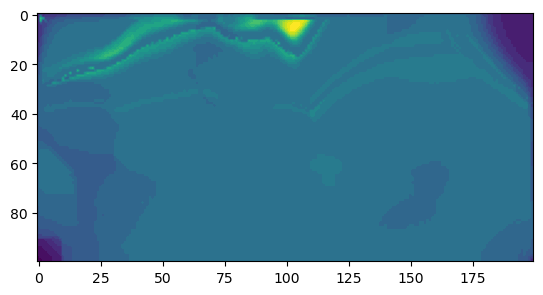

In [11]:
plt.imshow(x[0,100,:,:])
x

## Train

In [12]:
from torchmetrics.image import PeakSignalNoiseRatio
#criterion = PeakSignalNoiseRatio().to(device)
class SmoothnessLoss(nn.Module):
    def __init__(self, dx, dy):
        super(SmoothnessLoss, self).__init__()
        self.dx = dx
        self.dy = dy

    def forward(self, v, l):
        # Check for NaN values in input tensors
        if torch.isnan(v).any() or torch.isnan(l).any():
            return torch.tensor(0.0001)
        else:

            # Calculate horizontal and vertical differences
            horizontal_diff_v = torch.diff(v, dim=3)
            vertical_diff_v = torch.diff(v, dim=2) 
            #vertical_diff_v = torch.diff(v, dim=2)
            loss_v = vertical_diff_v[:, :, :99, :1999]+ horizontal_diff_v[:, :, :99, :1999]
            
            horizontal_diff_l = torch.diff(l, dim=3) 
            vertical_diff_l = torch.diff(l, dim=2) 
            loss_l = vertical_diff_l[:, :, :99, :1999]+ horizontal_diff_l[:, :, :99, :1999]

            # Calculate the absolute difference between the losses and take the mean
            loss = torch.nanmean(torch.abs(loss_v - loss_l))
            #loss = torch.clamp(loss, min=0, max=2)
            return loss
# criterion3 = SmoothnessLoss(1,1).to(device)

In [13]:
x,y = next(iter(dataloader))
x.shape

torch.Size([8, 114, 100, 200])

In [14]:
x[:,0:114:8,:,:].shape

torch.Size([8, 15, 100, 200])

In [15]:
criterion2 =nn.MSELoss()

device='cuda'
import torchvision
# model_swin=torchvision.models.video.swin3d_s(weights='KINETICS400_V1')
# model_seq = nn.Sequential(model_swin, nn.Linear(400, 114*100*60), nn.ReLU(inplace=True))
# model = Upsample_new(model_seq)
#model = Upsample_small()
#model.to(device)
from torch.optim.lr_scheduler import ExponentialLR, CosineAnnealingWarmRestarts
optimizer1 = optim.AdamW(model.parameters(), lr=0.00004)
#gamma = .99992# The exponential decay factor (adjust as needed)
scheduler1 = CosineAnnealingWarmRestarts(optimizer1, 300, 2)
#scheduler1 = ExponentialLR(optimizer1, gamma=gamma)

#40,80,160,320,640

# from dilate.loss.dilate_loss import dilate_loss
# from tslearn.metrics import dtw, dtw_path
# #sigma = 0.01
# gamma = 0.001
# #Lambda=1
# alpha=0.5
#import gc

num_epochs = 2000
iters=len(dataloader)
for epoch in range(num_epochs):
    model.train()

    count=0
    running_loss=0
    for batch in dataloader:
        inputs = batch[0].to(device)
        labels = batch[1].to(device)
#         labels = labels[:,50:58,:,:]
#         inputs=inputs[:,50:58,:,:].unsqueeze(1).repeat(1,3,1,1,1)
        optimizer1.zero_grad()
        #outputs = model0(inputs[:,:,:,:,0])
        #inputs=batch[0][:,0::10,:,:,:].to('cpu')
#         out2 = model(inputs)       
#         inputs=out2.squeeze()
        outputs = model(inputs)
#         outputs = torch.reshape(outputs, [3, 8, 100, 2000])
        #inputs = inputs.to('cpu')
        #outputs = outputs.to('cpu')
        #t_labels = torch.mean(labels, dim=(-2, -1)).unsqueeze(dim=2).to('cpu')
        #t_outputs = torch.mean(outputs, dim=(-2, -1)).unsqueeze(dim=2).to('cpu')
        
        #loss_dilate, loss_shape, loss_temporal = dilate_loss(t_labels,t_outputs,alpha, gamma, 'cpu') 
        #loss_norm = criterion1(outputs, labels)
        #print(loss_norm)
        #loss_end = criterion2(outputs[:,113,:,:], labels[:,113,:,:])
        
#         m = torch.distributions.normal.Normal(torch.mean(outputs.flatten()), torch.std(outputs.flatten()))
#         m1 = torch.distributions.normal.Normal(torch.mean(labels.flatten()), torch.std(labels.flatten()))
#         loss_kl=torch.distributions.kl.kl_divergence(m, m1)
    
        #loss = criterion2(m,m1)
        loss = criterion2(outputs, labels)
        #loss_MAE = criterion3(outputs[0,-1,:,:], labels[0,-1,:,:])
        #loss_smooth = 0#criterion4(outputs, labels)
        # if torch.isnan(loss_smooth):
            # loss_smooth = torch.tensor(0.00001)
        #loss = loss+loss_end*2#*.01#(.5*loss_MSE+5*loss_MAE)/3
        #loss = (loss_mse)#+.01*loss_kl)
        loss.backward()
        optimizer1.step()
        scheduler1.step()
        #scheduler1.step(epoch + count / iters)

        count=count+1
        running_loss = running_loss+loss.item()
        #print (loss.item())
    # Model testing
    #print('epoch ', epoch, ' loss ', loss.item(),' loss dilate',loss_dilate.item(),' loss shape ',loss_shape.item(),' loss temporal ',loss_temporal.item())
    model.eval()
    nn_errors=[]
    orig_errors=[]
    with torch.no_grad():
        for inputs, labels in test_dataloader:
            inputs = inputs.to(device)
            labels= labels.to(device)
#             labels = labels[:,50:58,:,:]
#             inputs=inputs[:,50:58,:,:].unsqueeze(1).repeat(1,3,1,1,1)
            #lab = torch.mean(lab, dim=(2,3)).squeeze()
            
            outputs = model(inputs)  
#             outputs = torch.reshape(outputs, [3, 8, 100, 2000])
#             inputs = inputs[:,0,:,:,:].squeeze()
            inputs = inputs.repeat_interleave(10, dim=3)
            #inp = torch.mean(inp, dim=(2,3)).squeeze()
            nn_error = criterion2(outputs, labels)
            orig_error = criterion2(labels, inputs)
            nn_errors.append(nn_error.cpu().detach().numpy())
            orig_errors.append(orig_error.cpu().detach().numpy())
    print (np.mean(orig_errors), np.mean(nn_errors))
    current_lr = optimizer1.param_groups[0]['lr']
    print(f"Epoch {epoch+1}/{num_epochs}, Loss: {running_loss/count}, Learning Rate: {current_lr:.8f}")
    #print(f"Epoch {epoch+1}/{num_epochs}, Loss: {running_loss/count}, Le

1.778931 1.7384542
Epoch 1/2000, Loss: 4.386019680235121, Learning Rate: 0.00003991
1.778931 1.4365579
Epoch 2/2000, Loss: 2.6418300204806857, Learning Rate: 0.00003965
1.778931 1.2212309
Epoch 3/2000, Loss: 1.62183764245775, Learning Rate: 0.00003921
1.778931 0.96794236
Epoch 4/2000, Loss: 1.2195199065738254, Learning Rate: 0.00003860
1.778931 0.80724895
Epoch 5/2000, Loss: 1.056312660376231, Learning Rate: 0.00003782
1.778931 0.70470953
Epoch 6/2000, Loss: 1.0284694764349196, Learning Rate: 0.00003689
1.778931 0.83068067
Epoch 7/2000, Loss: 1.0267346103986104, Learning Rate: 0.00003580
1.778931 0.6867813
Epoch 8/2000, Loss: 1.0938551094796922, Learning Rate: 0.00003458
1.778931 0.80334675
Epoch 9/2000, Loss: 0.9169092443254259, Learning Rate: 0.00003323
1.778931 0.67926973
Epoch 10/2000, Loss: 0.9334701399008433, Learning Rate: 0.00003176
1.778931 0.7577034
Epoch 11/2000, Loss: 0.9747402568658193, Learning Rate: 0.00003018
1.778931 0.723734
Epoch 12/2000, Loss: 0.9119817515214285, Le

1.778931 0.6992599
Epoch 97/2000, Loss: 0.7411486009756724, Learning Rate: 0.00000020
1.778931 0.69910765
Epoch 98/2000, Loss: 0.756960991356108, Learning Rate: 0.00000009
1.778931 0.6991703
Epoch 99/2000, Loss: 0.7492953820361031, Learning Rate: 0.00000002
1.778931 0.69915664
Epoch 100/2000, Loss: 0.764712929725647, Learning Rate: 0.00004000
1.778931 0.6342901
Epoch 101/2000, Loss: 0.7745486497879028, Learning Rate: 0.00003999
1.778931 0.6014074
Epoch 102/2000, Loss: 0.8210059967305925, Learning Rate: 0.00003998
1.778931 0.63301814
Epoch 103/2000, Loss: 0.9169665310117934, Learning Rate: 0.00003995
1.778931 0.8187359
Epoch 104/2000, Loss: 0.9272319111559126, Learning Rate: 0.00003991
1.778931 0.7913641
Epoch 105/2000, Loss: 0.8351671530140771, Learning Rate: 0.00003986
1.778931 0.6615271
Epoch 106/2000, Loss: 0.8084496590826247, Learning Rate: 0.00003980
1.778931 0.6655872
Epoch 107/2000, Loss: 0.7948083248403337, Learning Rate: 0.00003973
1.778931 0.69656044
Epoch 108/2000, Loss: 0.7

KeyboardInterrupt: 

In [22]:
m = torch.distributions.normal.Normal(torch.mean(outputs.flatten()), torch.std(outputs.flatten()))
m1 = torch.distributions.normal.Normal(torch.mean(labels.flatten()), torch.std(labels.flatten()))
loss_kl=torch.distributions.kl.kl_divergence(m, m1)

In [23]:
loss_kl

tensor(4.0982, device='cuda:0', grad_fn=<MulBackward0>)

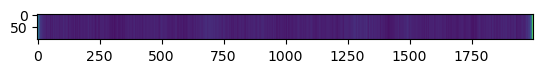

In [14]:
plt.imshow(outputs[2,9,:,:].cpu().detach().numpy())

## Test

In [12]:
criterion2 = nn.MSELoss()  # Replace with your loss function if needed
device='cuda'
# Lists to store predictions and true labels
all_predictions = []
all_inputs = []
all_labels = []
inp_loss = []
outp_loss = []
n=5
model.eval()
# model1.eval()
# model2.eval()
# model3.eval()
# model4.eval()
# model5.eval()
# Iterate through the test data
with torch.no_grad():
    for inputs, labels in test_dataloader:
        inputs = inputs.to(device)
        labels = labels.to(device)
        inputs = inputs.float()
        labels = labels.float()
        #inputs = inputs.repeat_interleave(10, dim=3)
        #labels = labels[0,:,:,:,:].permute(0,2,1,3)
        # Forward pass
        outputs1 = model(inputs)
#         outputs2 = model2(inputs)
#         outputs3 = model3(inputs)
#         outputs = model4(inputs)
#         outputs5 = model5(inputs)
        #outputs = (outputs3+outputs2+outputs1)/3
#         outputs = (outputs1+outputs3+outputs2+outputs)/4
        all_predictions.append(outputs1.cpu().detach().numpy())
        all_labels.append(labels.cpu().detach().numpy())
        
        inputs = inputs.repeat_interleave(10, dim=3)
        print (criterion2(labels, inputs))
        outp_loss.append(criterion2(labels, outputs))
        inp_loss.append(criterion2(labels, inputs))
        all_inputs.append(inputs.cpu().detach().numpy())
        # If you have a loss function, compute the loss (optional)
        #orig_error = np.abs(np.mean(inputs.cpu().detach().numpy()) - np.mean(labels.cpu().detach().numpy()))

        #nn_error = np.abs(np.mean(outputs.cpu().detach().numpy()) - np.mean(labels.cpu().detach().numpy()))
        #print (orig_error, nn_error)

tensor(2.8432, device='cuda:0')
tensor(1.8706, device='cuda:0')
tensor(1.3472, device='cuda:0')
tensor(1.6928, device='cuda:0')
tensor(1.1409, device='cuda:0')


C:\Users\marcb\anaconda3\Lib\site-packages\torch\nn\modules\loss.py:535: UserWarning: Using a target size (torch.Size([8, 114, 100, 2000])) that is different to the input size (torch.Size([4, 114, 100, 2000])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


RuntimeError: The size of tensor a (4) must match the size of tensor b (8) at non-singleton dimension 0

In [13]:
np.mean(torch.tensor(inp_loss).cpu().detach().numpy())

1.9384336

In [9]:
torch.save(model3.state_dict(),'weights_bio2_small_fulltest_best_feb4_3')


In [30]:
all_predictions[i].shape
#len(all_predictions)

(2, 114, 100, 2000)

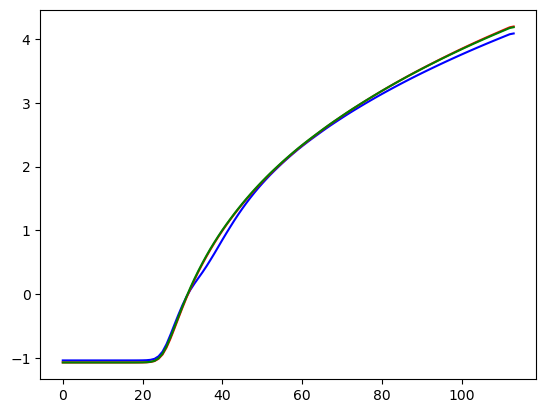

C:/Users/marcb/OneDrive/Desktop/mberghouse/PFLOTRAN/code/pt_files_bio/hanford_diff_lose_14_10_1xscale.pt


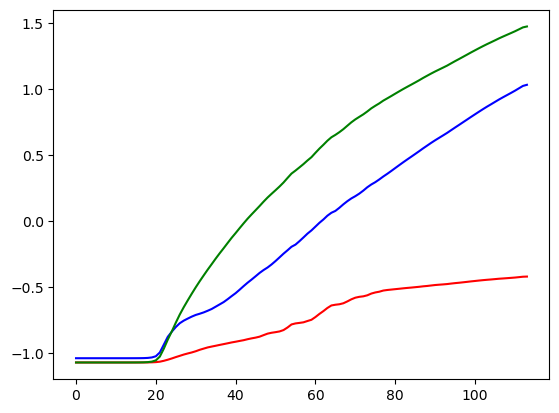

C:/Users/marcb/OneDrive/Desktop/mberghouse/PFLOTRAN/code/pt_files_bio/hanford_diff_lose_18_10_1xscale.pt


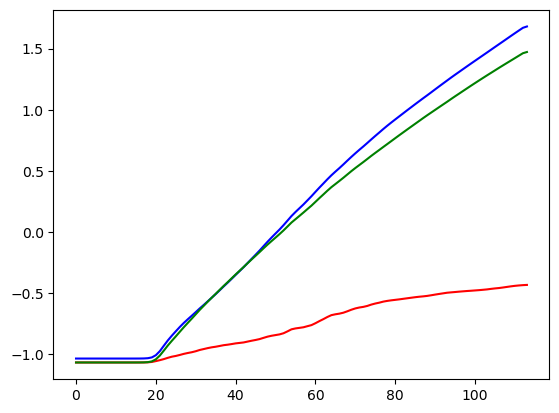

C:/Users/marcb/OneDrive/Desktop/mberghouse/PFLOTRAN/code/pt_files_bio/hanford_diff_lose_24_17_1xscale.pt


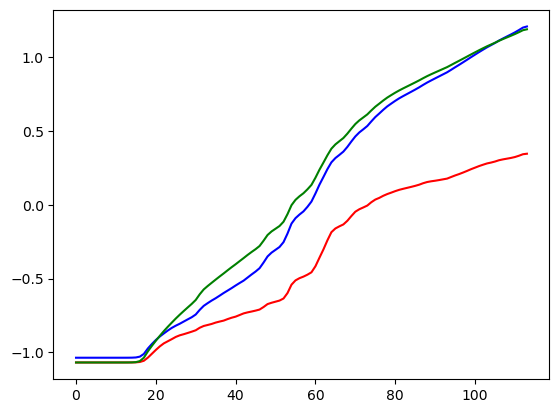

C:/Users/marcb/OneDrive/Desktop/mberghouse/PFLOTRAN/code/pt_files_bio/hanford_diff_lose_27_7_1xscale.pt


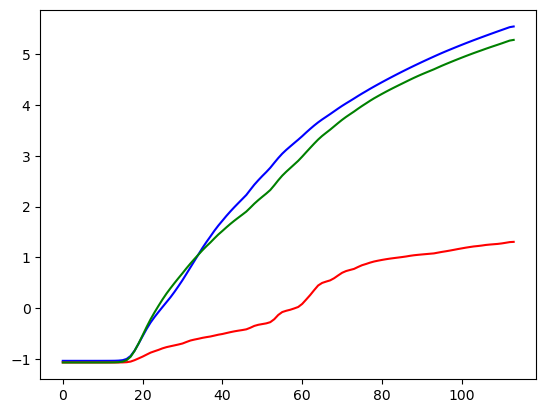

C:/Users/marcb/OneDrive/Desktop/mberghouse/PFLOTRAN/code/pt_files_bio/hanford_diff_lose_30_15_1xscale.pt


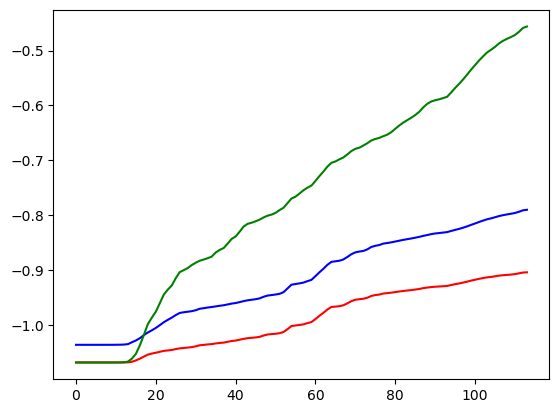

C:/Users/marcb/OneDrive/Desktop/mberghouse/PFLOTRAN/code/pt_files_bio/hanford_diff_lose_31_7_1xscale.pt


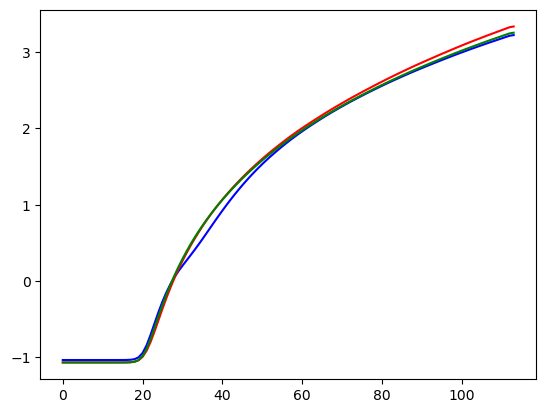

C:/Users/marcb/OneDrive/Desktop/mberghouse/PFLOTRAN/code/pt_files_bio/hanford_diff_lose_34_15_1xscale.pt


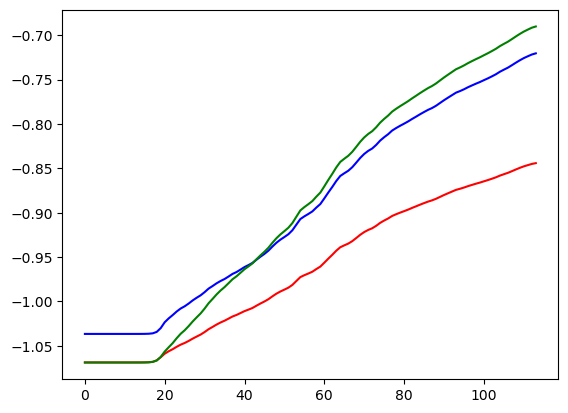

C:/Users/marcb/OneDrive/Desktop/mberghouse/PFLOTRAN/code/pt_files_bio/hanford_diff_lose_41_12_1xscale.pt


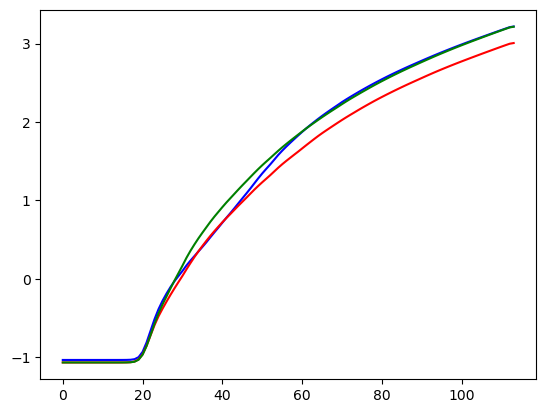

C:/Users/marcb/OneDrive/Desktop/mberghouse/PFLOTRAN/code/pt_files_bio/hanford_diff_lose_57_8_1xscale.pt


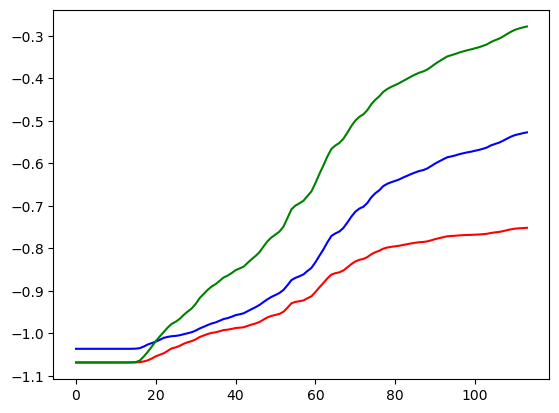

C:/Users/marcb/OneDrive/Desktop/mberghouse/PFLOTRAN/code/pt_files_bio/hanford_gain_14_10_1xscale.pt


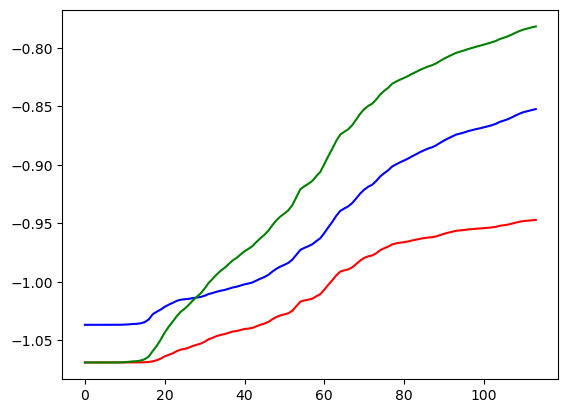

C:/Users/marcb/OneDrive/Desktop/mberghouse/PFLOTRAN/code/pt_files_bio/hanford_gain_24_17_1xscale.pt


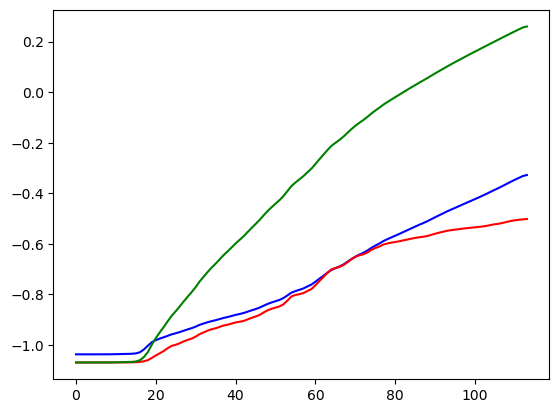

C:/Users/marcb/OneDrive/Desktop/mberghouse/PFLOTRAN/code/pt_files_bio/hanford_gain_27_14_1xscale.pt


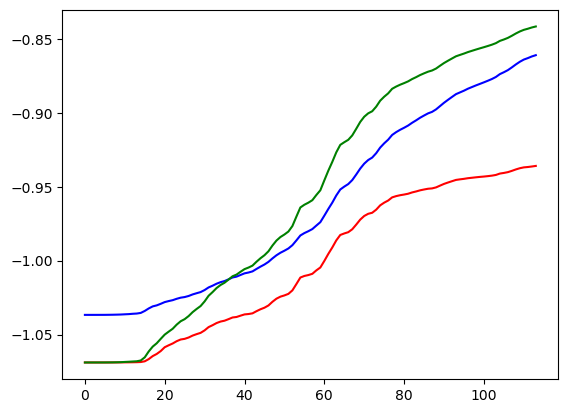

C:/Users/marcb/OneDrive/Desktop/mberghouse/PFLOTRAN/code/pt_files_bio/hanford_gain_31_7_1xscale.pt


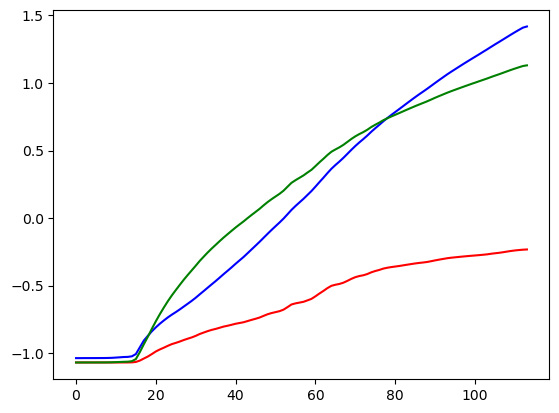

C:/Users/marcb/OneDrive/Desktop/mberghouse/PFLOTRAN/code/pt_files_bio/hanford_gain_35_23_1xscale.pt


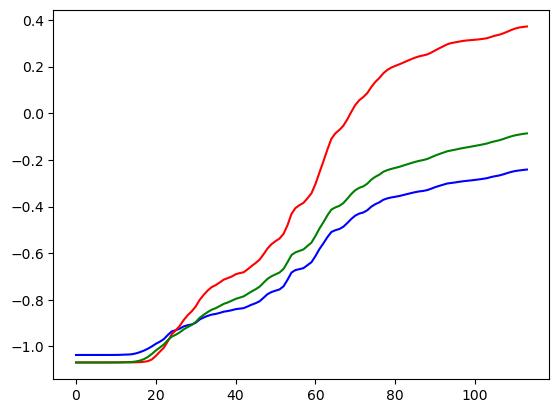

C:/Users/marcb/OneDrive/Desktop/mberghouse/PFLOTRAN/code/pt_files_bio/hanford_gain_37_9_1xscale.pt


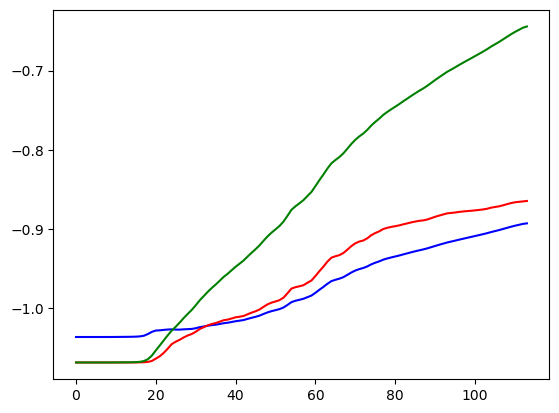

C:/Users/marcb/OneDrive/Desktop/mberghouse/PFLOTRAN/code/pt_files_bio/hanford_gain_45_19_1xscale.pt


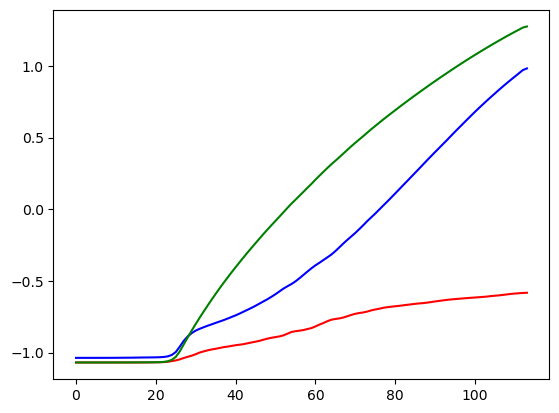

C:/Users/marcb/OneDrive/Desktop/mberghouse/PFLOTRAN/code/pt_files_bio/hanford_lose_14_10_1xscale.pt


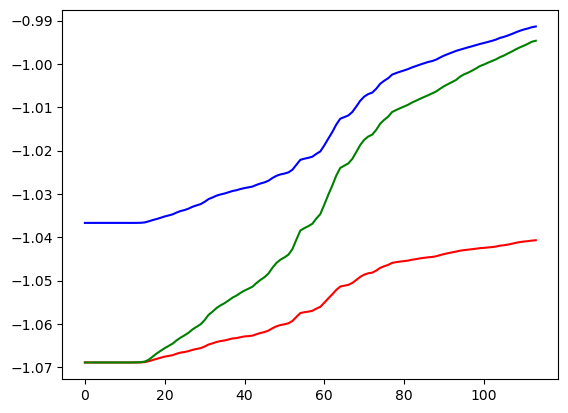

C:/Users/marcb/OneDrive/Desktop/mberghouse/PFLOTRAN/code/pt_files_bio/hanford_lose_18_19_1xscale.pt


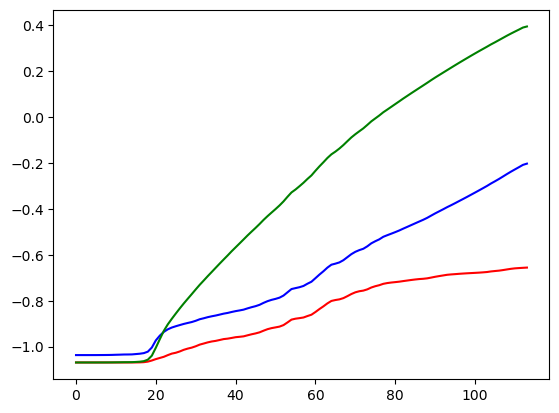

C:/Users/marcb/OneDrive/Desktop/mberghouse/PFLOTRAN/code/pt_files_bio/hanford_lose_24_17_1xscale.pt


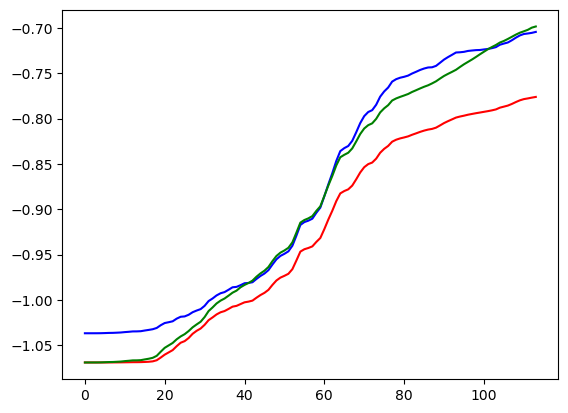

C:/Users/marcb/OneDrive/Desktop/mberghouse/PFLOTRAN/code/pt_files_bio/hanford_lose_27_14_1xscale.pt


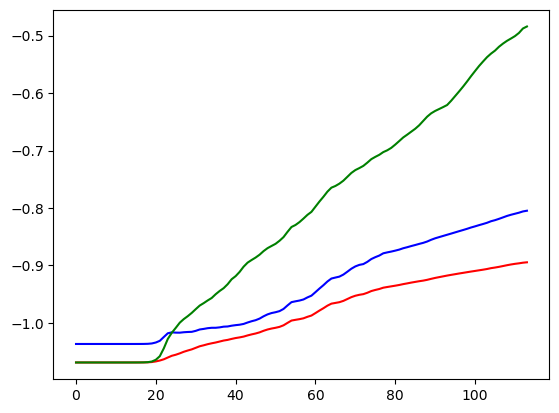

C:/Users/marcb/OneDrive/Desktop/mberghouse/PFLOTRAN/code/pt_files_bio/hanford_lose_33_24_1xscale.pt


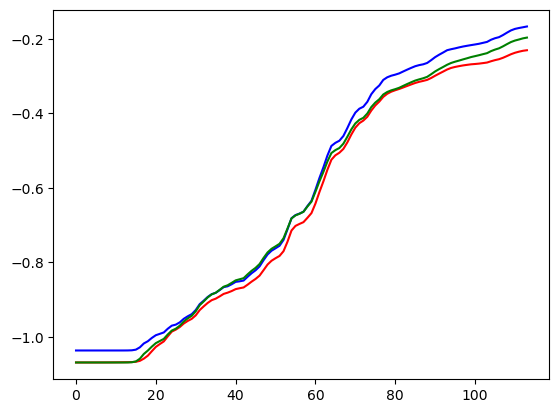

C:/Users/marcb/OneDrive/Desktop/mberghouse/PFLOTRAN/code/pt_files_bio/hanford_lose_35_23_1xscale.pt


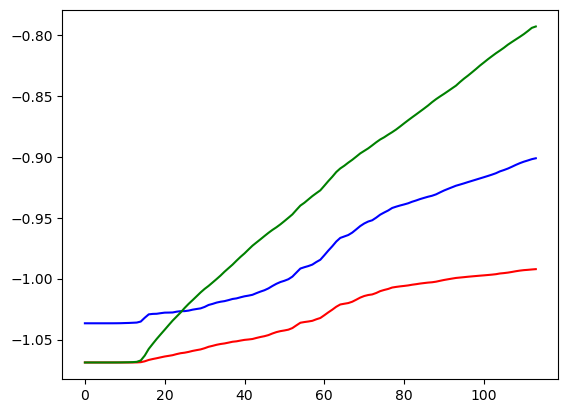

C:/Users/marcb/OneDrive/Desktop/mberghouse/PFLOTRAN/code/pt_files_bio/hanford_lose_36_11_1xscale.pt


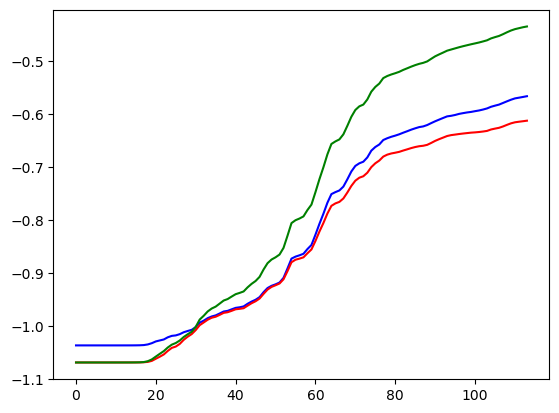

C:/Users/marcb/OneDrive/Desktop/mberghouse/PFLOTRAN/code/pt_files_bio/hanford_lose_40_17_1xscale.pt


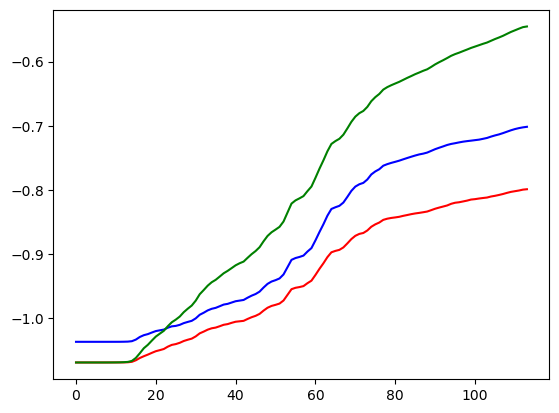

C:/Users/marcb/OneDrive/Desktop/mberghouse/PFLOTRAN/code/pt_files_bio/hanford_lose_42_11_1xscale.pt


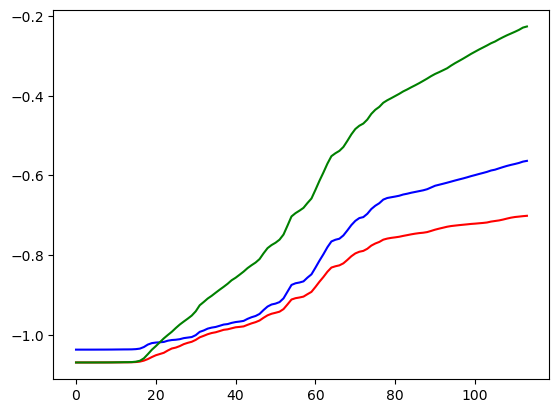

C:/Users/marcb/OneDrive/Desktop/mberghouse/PFLOTRAN/code/pt_files_bio/hanford_lose_50_25_1xscale.pt


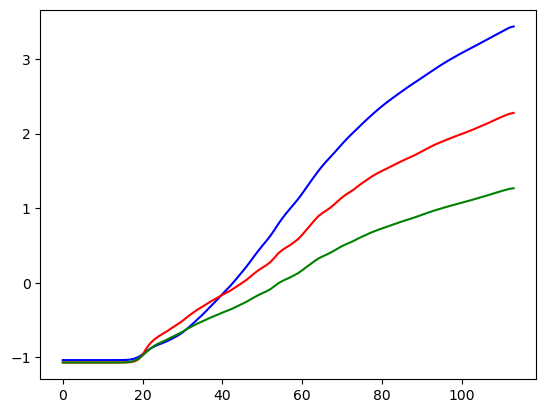

C:/Users/marcb/OneDrive/Desktop/mberghouse/PFLOTRAN/code/pt_files_bio/high_hanford_gain_14_10_1xscale.pt


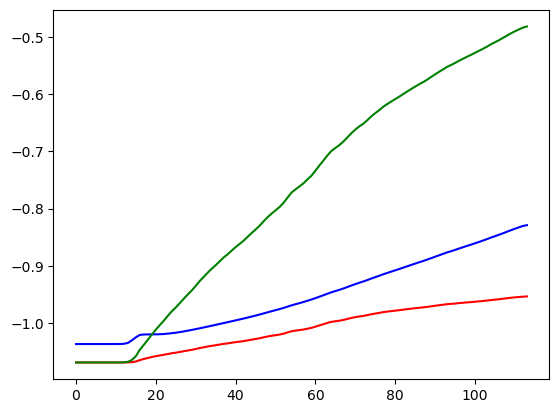

C:/Users/marcb/OneDrive/Desktop/mberghouse/PFLOTRAN/code/pt_files_bio/high_hanford_gain_18_10_1xscale.pt


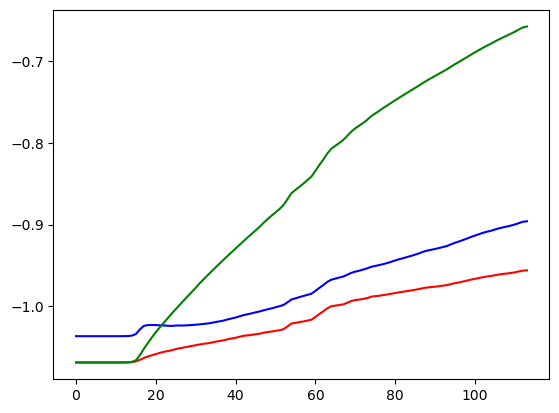

C:/Users/marcb/OneDrive/Desktop/mberghouse/PFLOTRAN/code/pt_files_bio/high_hanford_gain_24_17_1xscale.pt


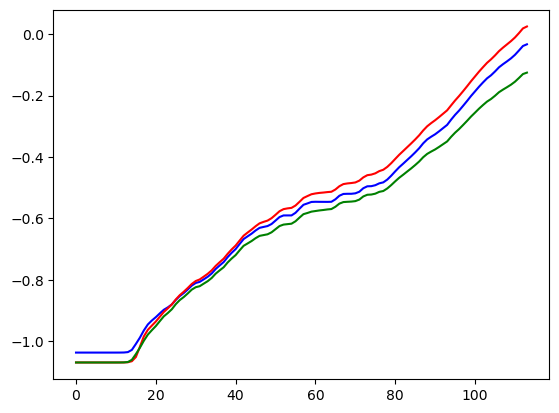

C:/Users/marcb/OneDrive/Desktop/mberghouse/PFLOTRAN/code/pt_files_bio/high_hanford_gain_27_14_1xscale.pt


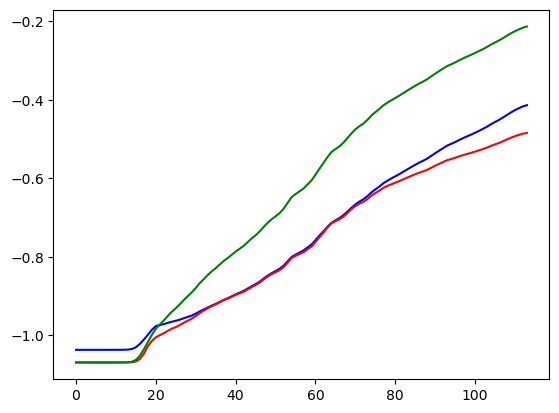

C:/Users/marcb/OneDrive/Desktop/mberghouse/PFLOTRAN/code/pt_files_bio/high_hanford_gain_31_7_1xscale.pt


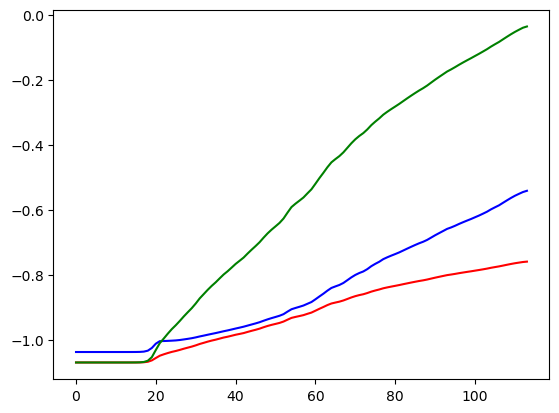

C:/Users/marcb/OneDrive/Desktop/mberghouse/PFLOTRAN/code/pt_files_bio/high_hanford_gain_35_23_1xscale.pt


IndexError: list index out of range

In [14]:
all_pred=np.zeros([len(xtest), 114])
all_lab=np.zeros([len(xtest), 114])
all_inp=np.zeros([len(xtest), 114])
count=0
#x_std=40.89437899
#x_mean = 43

for i in range(len(all_predictions)):
    for j in range(len(all_predictions[i])):
        out_ts = []
        out = all_predictions[i][j,:,:,:]
        for k in range(out.shape[0]):
            out_ts.append(np.mean(out[k,:,:]))
        all_pred[count, :] = out_ts

        label_ts = []
        lab = all_labels[i][j,:,:,:]
        for k in range(lab.shape[0]):
            label_ts.append(np.mean(lab[k,:,:]))
        all_lab[count, :] = label_ts
        
        inp_ts = []
        inp = all_inputs[i][j,:,:,:]
        for k in range(inp.shape[0]):
            inp_ts.append(np.mean(inp[k,:,:]))
        all_inp[count, :] = inp_ts
        
        plt.plot(np.array(out_ts), c='b') #*x_std+x_mean, c='b') 
        plt.plot(np.array(label_ts), c='r') #*x_std+x_mean, c='r')
        plt.plot(np.array(inp_ts), c='g') #*x_std+x_mean, c='g')
        plt.show()
        print(xtest[count])
        count=count+1

tensor(96.9343, dtype=torch.float64)
tensor(180.1364, dtype=torch.float64)


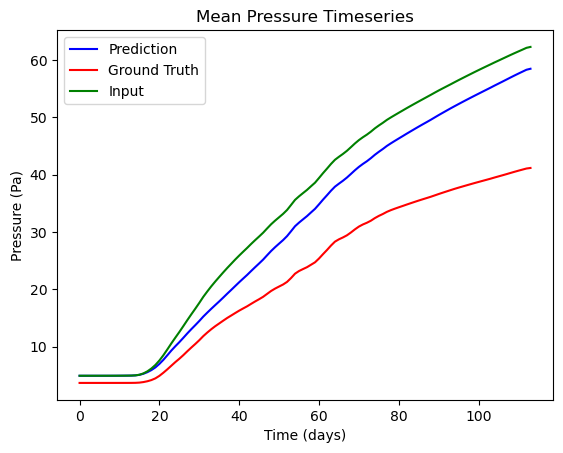

In [15]:
x_std=42.15564908#40.89437899
x_mean = 45#43
xout = np.mean(all_pred, 0)*x_std+x_mean
xlab = np.mean(all_lab, 0)*x_std+x_mean
xinp = np.mean(all_inp, 0)*x_std+x_mean
plt.plot(xout, c='b')
plt.plot(xlab, c='r')
#plt.plot(np.mean(all_inp, 0)*x_std+x_mean, c='g')
plt.plot(xinp, c='g')
plt.title('Mean Pressure Timeseries')
plt.xlabel('Time (days)')
plt.ylabel('Pressure (Pa)')
plt.legend(['Prediction', 'Ground Truth', 'Input'])
#all_lab
#plt.savefig('bio_molass_improved.png')
print (criterion2(torch.tensor(xout), torch.tensor(xlab)))
print (criterion2(torch.tensor(xinp), torch.tensor(xlab)))
#coefficient for pressure 1.0291

array([-7.77135745, -5.39479325, -5.01797933, -4.7350712 , -4.80649953,
       -4.89971346, -5.18162079, -4.92165513, -4.59885553, -4.89197154,
       -4.65815475, -4.77681537, -4.85583971, -4.92150501, -4.71517197,
       -4.63362307, -4.51590344, -5.11661379, -4.70376185, -4.76736037,
       -4.89225307, -4.87868109, -4.75309382, -4.68275396, -4.87406763,
       -4.98354222, -4.6599175 , -4.70907273, -4.80090268, -4.85909938,
       -4.23715306, -4.49867211, -4.74942448, -4.66536665, -4.92513566,
       -4.87143607, -4.80813172, -4.66513894, -5.20751062, -4.80997156,
       -5.0456586 , -5.16779104, -4.69002275, -4.67514202, -4.79463711,
       -4.95466705, -4.54578604, -4.32896545, -4.63163496, -4.76660941,
       -5.07955226, -4.8260781 , -3.94696525, -3.64716362, -3.98153395,
       -5.13755366, -5.12087662, -4.78661436, -4.47131656, -4.49527095,
       -3.88595386, -4.0325735 , -3.85547323, -3.7973124 , -4.32693879,
       -4.95426573, -4.84750872, -4.41865803, -4.25594505, -4.27

In [31]:
mean_pred=np.zeros([114,100,2000])
for i in range(len(all_predictions)):
    mean_pred = mean_pred+np.mean(all_predictions[i],0)
mean_pred.shape

mean_inp=np.zeros([114,100,2000])
for i in range(len(all_inputs)):
    mean_inp = mean_inp+np.mean(all_inputs[i],0)

mean_lab=np.zeros([114,100,2000])
for i in range(len(all_labels)):
    mean_lab = mean_lab+np.mean(all_labels[i],0)

In [33]:
np.min(mean_lab[9,:,:])

-11.235230464488268

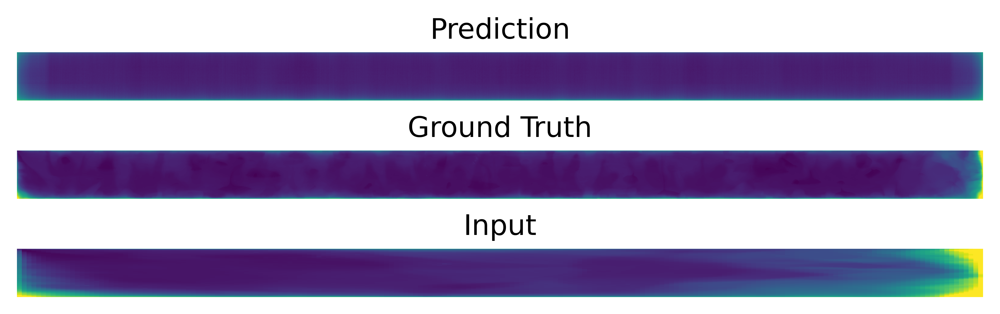

In [35]:
import matplotlib.pyplot as plt

# Assuming mean_pred, mean_lab, and mean_inp are defined earlier in your code

# Create a figure to hold the subplots
plt.figure(figsize=(6,2), dpi=600)  # Adjust the figsize for vertical arrangement

# Plot Prediction
plt.subplot(3, 1, 1)  # 3x1 grid, first plot
plt.imshow(mean_pred[113,:,0:],vmin=-4, vmax=20)
plt.title('Prediction')
plt.axis('off')  # Optional: Removes the axis for a cleaner look

# Plot Ground Truth
plt.subplot(3, 1, 2)  # 3x1 grid, second plot
plt.imshow(mean_lab[113,:,0:],vmin=-4, vmax=20)
plt.title('Ground Truth')
plt.axis('off')  # Optional

# Plot Input
plt.subplot(3, 1, 3)  # 3x1 grid, third plot
plt.imshow(mean_inp[113,:,0:]*1.025,vmin=-4, vmax=20)
plt.title('Input')
plt.axis('off')  # Optional

# Adjust layout to prevent overlap
plt.tight_layout()
#plt.savefig('bio_improved_spatial.png')
# Display the figure
plt.show()




In [ ]:
plt.plot(out_ts, c='b') 
plt.plot(label_ts, c='r')
plt.plot(inp_ts, c='g')

C:\Users\marcb\AppData\Local\Temp\ipykernel_11056\1068216512.py:16: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig = plt.figure(figsize=(6,6), dpi=600)


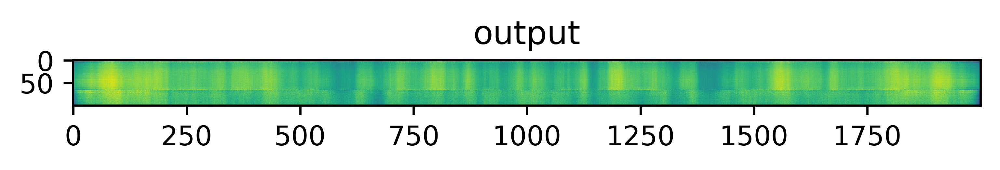

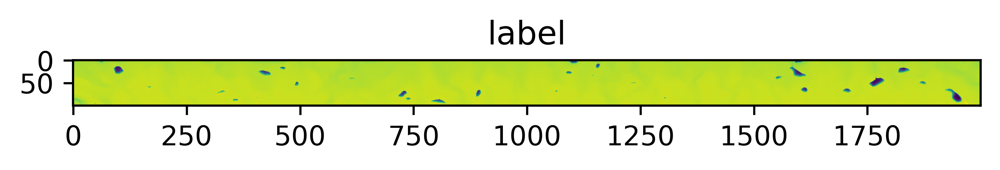

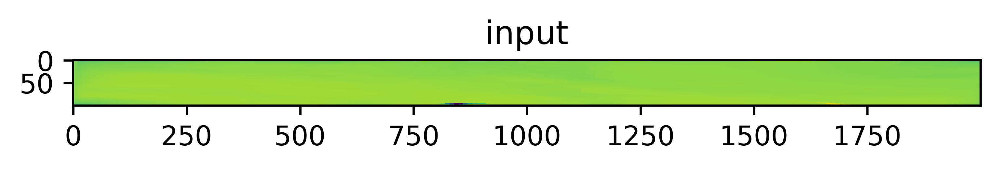

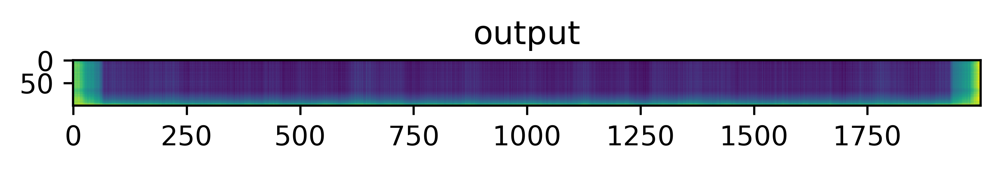

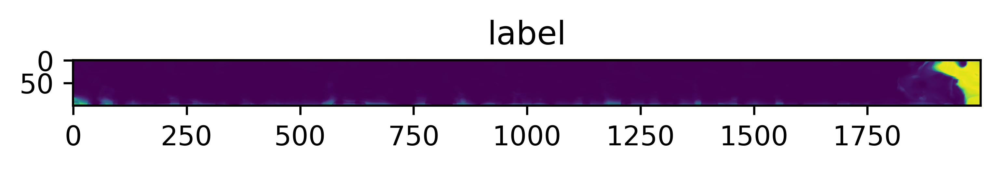

...

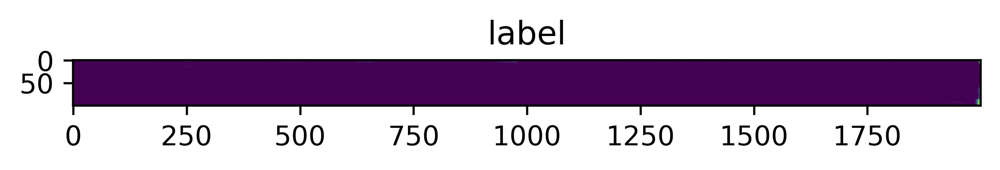

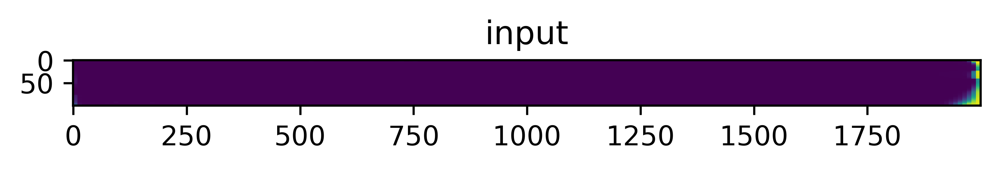

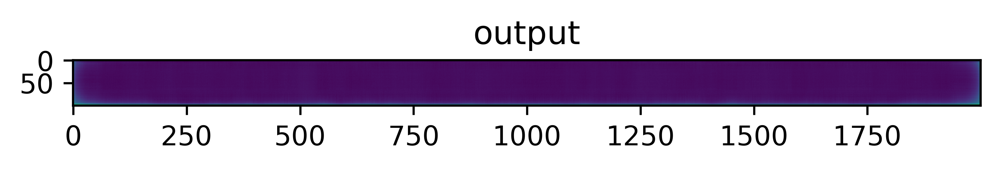

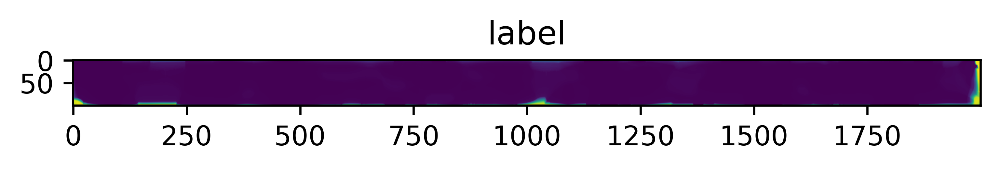

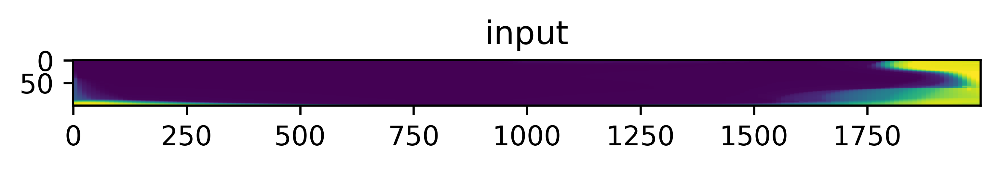

In [36]:
n=4
for i in range(len(all_predictions)):
    for j in range(len(all_predictions[i])):
        out = all_predictions[i][j,110,:,:]
        out2 = all_labels[i][j,110,:,:]
        out3 = all_inputs[i][j,110,:,:]
        #out[out<=0] = np.min(out[out>0])
        import matplotlib.pyplot as plt
        from matplotlib.colors import LogNorm
        fig = plt.figure(figsize=(6,6), dpi=600)
        plt.imshow(out)
        plt.title('output')
        fig = plt.figure(figsize=(6,6), dpi=600)
        plt.imshow(out2)
        plt.title('label')
        fig = plt.figure(figsize=(6,6), dpi=600)
        plt.imshow(out3)
        plt.title('input')
        #plt.imshow(inputs[0,100,:,:,n].cpu().detach().numpy())
        #fig.savefig('label.png')  # Replace 'output.png' with your desired file path and format

        #field_names[n]
        #plt.colorbar()



In [42]:
all_pred

array([[-1.04655933, -1.04655933, -1.04655933, ...,  4.33343935,
         4.36066341,  4.37395859],
       [-1.04237521, -1.04237521, -1.04237521, ...,  0.11576451,
         0.1231581 ,  0.12614551],
       [-1.05395937, -1.05395937, -1.05395842, ...,  0.37356156,
         0.38221607,  0.38774332],
       ...,
       [-1.05433762, -1.05433762, -1.05433762, ..., -0.53368318,
        -0.52659756, -0.52419019],
       [-1.04481709, -1.04481685, -1.04481637, ..., -0.98451662,
        -0.98411673, -0.98401046],
       [-1.05140388, -1.05140388, -1.05140388, ..., -0.5191021 ,
        -0.51229763, -0.51014817]])

In [14]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model1 = UNet3(400, 2000).to(device)
model2 = UNet3(400, 2000).to(device)
model3 = UNet3(400, 2000).to(device)
model4 = UNet3(400, 2000).to(device)
model5 = UNet5(400, 2000).to(device)
model6 = UNet5(400, 2000).to(device)


#model2 = UNet2(400, 800).to(device)

#model3 = UNet2(800, 1200).to(device)

#model4 = UNet2(1200, 1600).to(device)

#model5 = UNet2(1600, 2000).to(device)
model1

UNet3(
  (up1): Conv2d(400, 800, kernel_size=(1, 1), stride=(1, 1))
  (fc1): Linear(in_features=6, out_features=12, bias=True)
  (d1): Dropout(p=0.1, inplace=False)
  (up2): Conv2d(800, 1200, kernel_size=(1, 1), stride=(1, 1))
  (fc2): Linear(in_features=12, out_features=1, bias=True)
  (up4): Conv2d(1200, 2000, kernel_size=(1, 1), stride=(1, 1))
)

In [15]:
model_weights_path = 'weights_vel2'
model1.load_state_dict(torch.load(model_weights_path))
model_weights_path = 'weights_press2'
model2.load_state_dict(torch.load(model_weights_path))
model_weights_path = 'weights_por2'
model3.load_state_dict(torch.load(model_weights_path))
model_weights_path = 'weights_crv2'
model4.load_state_dict(torch.load(model_weights_path))
model_weights_path = 'weights_molass2'
model5.load_state_dict(torch.load(model_weights_path))
model_weights_path = 'weights_bio2'
model6.load_state_dict(torch.load(model_weights_path))
model6

UNet5(
  (up1): Conv2d(400, 800, kernel_size=(1, 1), stride=(1, 1))
  (fc1): Linear(in_features=6, out_features=24, bias=True)
  (d1): Dropout(p=0.1, inplace=False)
  (up2): Conv2d(800, 1200, kernel_size=(1, 1), stride=(1, 1))
  (fc2): Linear(in_features=24, out_features=6, bias=True)
  (up4): Conv2d(1200, 2000, kernel_size=(1, 1), stride=(1, 1))
  (fc3): Linear(in_features=6, out_features=1, bias=True)
)

In [24]:
model7 = UNet4(400, 2000).to(device)
model7

UNet4(
  (fc1): Linear(in_features=6, out_features=6, bias=True)
)

In [25]:
import torch
from torch.utils.data import Dataset, DataLoader
from torch.optim.lr_scheduler import ExponentialLR


#class CustomDataset(Dataset):
#    def __init__(self, x, target):
#        """
#        Args:
#            data (numpy array): A numpy array of shape [N, 100, 200, 19] where N is the number of samples.
#        """
#        self.x = torch.tensor(x, dtype=torch.float32)
#        self.target = torch.tensor(target, dtype=torch.float32)#
#
#    def __len__(self):
#        return len(self.x)
#
#    def __getitem__(self, idx):
#        input = self.x[idx]
#        target = self.target[idx]
#        return input, target

#criterion3 = SmoothnessLoss(.1, .1)
#dataset = CustomDataset(x, y)
#dataloader = DataLoader(dataset, batch_size=1, shuffle=True)

# Model, loss, and optimizer
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
#criterion1 = DivLoss()
criterion2 = nn.MSELoss()
optimizer1 = optim.Adam(model1.parameters(), lr=0.001)
optimizer2 = optim.Adam(model2.parameters(), lr=0.0002)
optimizer3 = optim.Adam(model3.parameters(), lr=0.0002)
optimizer4 = optim.Adam(model4.parameters(), lr=0.0002)
optimizer5 = optim.Adam(model5.parameters(), lr=0.0002)
optimizer6 = optim.Adam(model5.parameters(), lr=0.0002)
optimizer7 = optim.Adam(model5.parameters(), lr=0.0002)


gamma = .9999  # The exponential decay factor (adjust as needed)
scheduler1 = ExponentialLR(optimizer1, gamma=gamma)
scheduler2 = ExponentialLR(optimizer2, gamma=gamma)
scheduler3 = ExponentialLR(optimizer3, gamma=gamma)
scheduler4 = ExponentialLR(optimizer4, gamma=gamma)
scheduler5 = ExponentialLR(optimizer5, gamma=gamma)
scheduler6 = ExponentialLR(optimizer6, gamma=gamma)
scheduler7 = ExponentialLR(optimizer7, gamma=gamma)

optimizers = [optimizer1,optimizer2,optimizer3,optimizer4,optimizer5,optimizer6,optimizer7]
schedulers = [scheduler1,scheduler2,scheduler3,scheduler4,scheduler5,scheduler6,scheduler7]
#import gc
model1.eval()
model2.eval()
model3.eval()
model4.eval()
model5.eval()
model6.eval()
model = [model1,model2,model3,model4,model5,model6]
model7.train()
# Training loop
num_epochs = 200
for epoch in range(num_epochs):
    
    count=0
    running_loss=0
    for batch in dataloader:
        inputs = batch[0].to(device)
        inputs = inputs.float()
        labels = batch[1].to(device)
        labels = labels.float()
        #labels = labels[0,:,:,:,4].permute(2,1,0)
        labels = labels[0,:,:,:,:].permute(0,2,1,3)
        outputs = torch.zeros((80,2000,100,6)).to(device)
        for k in range(labels.shape[3]):
            #with torch.no_grad():
            outputs[:,:,:,k] = model[k](inputs)

        #labels1 = labels[:,0:400,:,:]
        #labels2 = labels[:,0:800,:,:]
        #labels3 = labels[:,0:1200,:,:]
        #labels4 = labels[:,0:1600,:,:]
        optimizer1.zero_grad()
        #optimizer2.zero_grad()
        #optimizer3.zero_grad()
        #optimizer4.zero_grad()
        #optimizer5.zero_grad()
        #outputs1 = model1(inputs)
        #outputs2 = model2(outputs1)
        #outputs3 = model3(outputs2)
        #outputs4 = model4(outputs3)
        outputs = model7(outputs)
        #outputs2 = outputs2[:,400:800,:,:]
        #outputs3 = outputs3[:,800:1200,:,:]
        #outputs4 = outputs4[:,1200:1600,:,:]
        
        #loss1 = criterion2(outputs1, labels1)
        #loss2 = criterion2(outputs2, labels2)
        #loss3 = criterion2(outputs3, labels3)
        #loss4 = criterion2(outputs4, labels4)
        loss = criterion2(outputs, labels)

        #loss = (loss1*4+loss2+loss3+loss4+loss5)/8

        loss.backward()
        optimizer1.step()
        #optimizer2.step()
        #optimizer3.step()
        #optimizer4.step()
        #optimizer5.step()
        scheduler1.step()
        ##scheduler2.step()
        #scheduler3.step()
        #scheduler4.step()
        #scheduler5.step()
        count=count+1
        running_loss = running_loss+loss.item()
    #model7.eval()
# Iterate through the test data
    #nn_errors=[]
    #orig_errors=[]
    #with torch.no_grad():
    #    for inputs, labels in test_dataloader:
    #        inputs = inputs.to(device)
    #        labels = labels.to(device)
    #        inputs = inputs.float()
    #        labels = labels.float()
    #        labels = labels[0,:,:,:,:].permute(0,2,1,3)
    #        # Forward pass
    #        outputs = model1(inputs)
    #        #all_predictions.append(outputs.cpu().detach().numpy())
    #        #all_labels.append(labels.cpu().detach().numpy())
    #        # If you have a loss function, compute the loss (optional)
    #        n=0
    #        orig_error = np.abs(np.mean(inputs[0,:,:,:,n].cpu().detach().numpy()) - np.mean(labels[:,:,:,n].cpu().detach().numpy()))
    
    #        nn_error = np.abs(np.mean(outputs[:,:,:].cpu().detach().numpy()) - np.mean(labels[:,:,:,n].cpu().detach().numpy()))
    #        nn_errors.append(nn_error)
    #        orig_errors.append(orig_error)
    #print (np.mean(orig_errors), np.mean(nn_errors))
    current_lr = optimizer1.param_groups[0]['lr']
    print(f"Epoch {epoch+1}/{num_epochs}, Loss: {running_loss/count}, Learning Rate: {current_lr:.8f}")

Epoch 1/200, Loss: 159.88739277124404, Learning Rate: 0.00099601
Epoch 2/200, Loss: 153.98396366238595, Learning Rate: 0.00099203
Epoch 3/200, Loss: 153.21422865986824, Learning Rate: 0.00098807
Epoch 4/200, Loss: 152.37736921310426, Learning Rate: 0.00098413
Epoch 5/200, Loss: 151.97827052175998, Learning Rate: 0.00098020
Epoch 6/200, Loss: 151.8371748328209, Learning Rate: 0.00097628
Epoch 7/200, Loss: 151.63196961581707, Learning Rate: 0.00097239
Epoch 8/200, Loss: 151.5796983897686, Learning Rate: 0.00096851
Epoch 9/200, Loss: 151.64396729171276, Learning Rate: 0.00096464
Epoch 10/200, Loss: 151.4676573753357, Learning Rate: 0.00096079
Epoch 11/200, Loss: 151.48888604044913, Learning Rate: 0.00095695
Epoch 12/200, Loss: 151.32529764473438, Learning Rate: 0.00095313
Epoch 13/200, Loss: 151.35672963261604, Learning Rate: 0.00094933
Epoch 14/200, Loss: 151.29406080842017, Learning Rate: 0.00094554
Epoch 15/200, Loss: 151.2871945589781, Learning Rate: 0.00094176
Epoch 16/200, Loss: 151

KeyboardInterrupt: 

In [35]:
criterion = nn.MSELoss()  # Replace with your loss function if needed

# Lists to store predictions and true labels
all_predictions = []
all_labels = []

model7.eval()
# Iterate through the test data
with torch.no_grad():
    for inputs, labels in test_dataloader:
        inputs = inputs.to(device)
        labels = labels.to(device)
        inputs = inputs.float()
        labels = labels.float()
        labels = labels[0,:,:,:,:].permute(0,2,1,3)
        outputs = torch.zeros((80,2000,100,6)).to(device)
        for k in range(labels.shape[3]):
            #with torch.no_grad():
            outputs[:,:,:,k] = model[k](inputs)
        # Forward pass
        #outputs = model7(outputs)
        all_predictions.append(outputs.cpu().detach().numpy())
        all_labels.append(labels.cpu().detach().numpy())
        loss = criterion(outputs,labels)
        print ("Loss: ", loss.item())
        # If you have a loss function, compute the loss (optional)
        orig_error = np.abs(np.mean(inputs[0,:,:,:,:].cpu().detach().numpy()) - np.mean(labels[:,:,:,:].cpu().detach().numpy()))

        nn_error = np.abs(np.mean(outputs[:,:,:].cpu().detach().numpy()) - np.mean(labels[:,:,:,:].cpu().detach().numpy()))
        print (orig_error, nn_error)

Loss:  2.6761043071746826
0.09839177 0.5566623
Loss:  2.659982442855835
0.12734497 0.61660105
Loss:  2.929009437561035
0.1413343 0.091187716
Loss:  3.2276692390441895
0.026858568 0.7345431
Loss:  2.6161303520202637
0.050297737 0.16991472
Loss:  1.6953140497207642
0.022475481 0.3268901


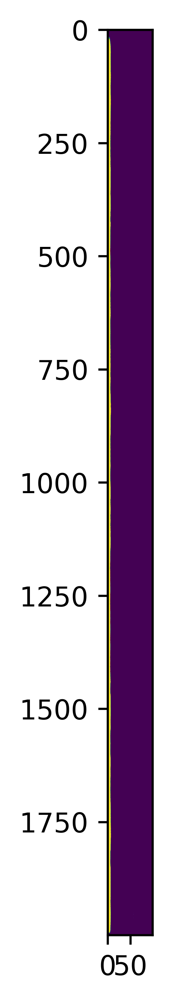

In [62]:
n=0
out = all_predictions[4][70,:,:,n]#.cpu().detach().numpy()
#out[out<=0] = np.min(out[out>0])
import matplotlib.pyplot as plt
from matplotlib.colors import LogNorm
fig = plt.figure(figsize=(6,6), dpi=600)
plt.imshow(out, vmin = -.5, vmax=.5)

In [ ]:
import torch
import torch.nn as nn

def aggregate_horizontal_means(tensor):
    """
    Aggregate horizontal means for every 10 rows along the 100-length dimension.
    Args:
        tensor (torch.Tensor): Tensor of shape [batch_size, 100, 2000, 19].
    Returns:
        torch.Tensor: Tensor of shape [batch_size, 10, 19].
    """
    batch_size, _, width, channels = tensor.shape
    aggregated_means = []

    for start_row in range(0, 100, 10):
        # Extract 10-row block and compute mean
        block = tensor[:, start_row:start_row + 10, :, :]
        block_mean = torch.mean(block, dim=2)  # Mean along the width (2000)
        block_mean = torch.mean(block_mean, dim=1)  # Mean along the 10 rows
        aggregated_means.append(block_mean)

    # Combine the means into a single tensor
    aggregated_means_tensor = torch.stack(aggregated_means, dim=1)
    return aggregated_means_tensor

class CustomMSELoss(nn.Module):
    def __init__(self):
        super(CustomMSELoss, self).__init__()
        self.mse_loss = nn.MSELoss()

    def forward(self, y_pred, y_true):
        # Aggregate horizontal means
        y_pred_agg = aggregate_horizontal_means(y_pred)
        y_true_agg = aggregate_horizontal_means(y_true)

        # Calculate MSE between the aggregated tensors
        return self.mse_loss(y_pred_agg, y_true_agg)



# Example usage
# Assuming y_pred and y_true are your model's output and ground truth tensors respectively
# with shape [batch_size, 100, 2000, 19]
custom_loss = CustomMSELoss()
#loss = custom_loss(y_pred, y_true)

import torch
import torch.nn as nn
import torch.nn.functional as F


class SmoothnessLoss(nn.Module):
    def __init__(self, dx, dy):
        """

        """
        super(SmoothnessLoss, self).__init__()
        self.dx = dx
        self.dy = dy

    def forward(self, v):
        v1 = v[:,:,:,0].permute(0,2,1)
        v2 = v[:,:,:,1].permute(0,2,1)

        # Calculate horizontal and vertical differences
        horizontal_diff = torch.abs(torch.diff(v1, dim=2) / self.dx)
        vertical_diff = torch.abs(torch.diff(v2, dim=1) / self.dy)

        # Calculate the squared differences (L2 norm)
        horizontal_loss = torch.sum(horizontal_diff)
        vertical_loss = torch.sum(vertical_diff)

        # Total loss
        loss = horizontal_loss + vertical_loss
        #if loss > .001:

        return loss

# Example usage with dummy data
# Create sample velocity fields as PyTorch tensors



def calculate_divergence(vx, vy, dx, dy):
    # Use PyTorch's built-in functions for gradient computation
    dvx_dx = torch.diff(vx, dim=1) / dx
    dvy_dy = torch.diff(vy, dim=2) / dy


    # Pad the last dimension to match the original size
    #dvx_dx = F.pad(dvx_dx, (0, 1), "constant", 0)
    #dvy_dy = F.pad(dvy_dy, (0, 0, 0, 1), "constant", 0)

    return dvx_dx[:,:,0:1999] + dvy_dy[:,0:99,:]

class DivLoss(nn.Module):
    def __init__(self):
        super(DivLoss, self).__init__()
        self.mse_loss = nn.MSELoss()

    def forward(self, y_pred, y_true):
        dx = .1
        dy = dx
        
        ypred_vx = y_pred[:,:,:,0].permute(0,2,1)
        ypred_vy = y_pred[:,:,:,1].permute(0,2,1)
    
        ytrue_vx = y_true[:,:,:,0].permute(0,2,1)
        ytrue_vy = y_true[:,:,:,1].permute(0,2,1)
        
        y_pred_div = calculate_divergence(ypred_vx, ypred_vy, dx, dy)
        y_true_div = calculate_divergence(ytrue_vx, ytrue_vy, dx, dy)

        return torch.mean(torch.abs(torch.abs(y_pred_div)-torch.abs(y_true_div)))

class NormLoss(nn.Module):
    def __init__(self):
        super(NormLoss, self).__init__()
        self.mse_loss = nn.MSELoss()

    def forward(self, y_pred, y_true):
        true_means=[]
        pred_means=[]
        for i in y_pred.shape[3]:
            ypred_flat = torch.flatten(y_pred[:,:,:,i])
            ypred_mean = torch.mean(ypred_flat)
            ypred_std = torch.std(ypred_flat)
            pred_means.append([ypred_mean, ypred_std])

            ytrue_flat = torch.flatten(y_true[:,:,:,i])
            ytrue_mean = torch.mean(ytrue_flat)
            ytrue_std = torch.std(ytrue_flat)
            true_means.append([ytrue_mean, ytrue_std])

        return self.mse_loss(pred_means, true_means)
# Example usage (assuming y_pred and y_true are PyTorch tensors with appropriate dimensions)
# loss_fn = DivLoss()
# loss = loss_fn(y_pred, y_true)



#divergence = calculate_divergence(vx, vy, dx, dy)


In [64]:
!pip install pysal
import numpy as np
import matplotlib.pyplot as plt
from pysal.lib import weights
from pysal.explore import esda

# Generate sample 2D array data (position data)
# For demonstration purposes, let's generate a random 10x10 array
np.random.seed(123)
data = np.random.rand(10, 10)

# Assuming you have a variable of interest associated with each position in the array
# For demonstration, let's create a random variable array of the same shape
variable = np.random.rand(10, 10)

# Create spatial weights matrix (using distance-based weights, e.g., KNN)
w = weights.KNN.from_array(data, k=4)

# Moran's I calculation
mi = esda.Moran(variable.flatten(), w)

# LISA calculation
lisa = esda.Moran_Local(variable.flatten(), w)

# Reshape LISA results to match the shape of the original array
lisa_clusters = lisa.q.reshape(data.shape)

# Plot LISA cluster map
plt.imshow(lisa_clusters, cmap='coolwarm', interpolation='none')
plt.colorbar(label='LISA Cluster')
plt.title('LISA Cluster Map')
plt.show()

  Obtaining dependency information for pysal from https://files.pythonhosted.org/packages/5d/7d/2eb9e1250446a62649bd0b8efe44a7da9587b09e609681b29d0ef637fc8c/pysal-24.1-py3-none-any.whl.metadata
  Obtaining dependency information for libpysal>=4.6.2 from https://files.pythonhosted.org/packages/f9/06/76f7581c3b161842b936f44e14bb25b3ff6787e50b7a24cd189f04d510ac/libpysal-4.9.2-py3-none-any.whl.metadata
  Obtaining dependency information for access>=1.1.8 from https://files.pythonhosted.org/packages/5d/e0/be59a75ad3d0b0fea7f8c6c55439772c4bb791406f3653aa25880ec68d7f/access-1.1.9-py3-none-any.whl.metadata
  Obtaining dependency information for esda>=2.4.1 from https://files.pythonhosted.org/packages/ea/e1/6000a61d9a964dbb592db8271232693ef2e341d088c7bdf9393a9a34b658/esda-2.5.1-py3-none-any.whl.metadata
  Obtaining dependency information for giddy>=2.3.3 from https://files.pythonhosted.org/packages/a2/19/9125c0ec03be4e4345b95c8a8490d4552fb224cb86ed27e0ef2d37d09e06/giddy-2.3.5-py3-none-any.whl.m

ValueError: dimension mismatch

In [71]:
import numpy as np
from pysal.lib import weights
from pysal.explore import esda
import matplotlib.pyplot as plt

# Generate random 2D array data (position data)
np.random.seed(123)
data = np.random.rand(10, 10)

# Assuming you have a variable of interest associated with each position in the array
# Generate random variable array of the same shape as the position data
variable = np.random.rand(10, 10)

# Create spatial weights matrix (using distance-based weights, e.g., KNN)
w = weights.KNN.from_array(data, k=4)

# Convert the spatial weights matrix to a dense array
w_array = w.full()[0]

# Compute spatial lag of the variable
spatial_lag = np.dot(w_array, variable.flatten())

# Reshape the spatial lag to match the shape of the original array
spatial_lag = spatial_lag.reshape(variable.shape)

# Calculate Moran's Local statistic for autocovariance
spatial_autocovariance = esda.Moran_Local(spatial_lag.flatten(), w)

# Reshape the result to match the shape of the original array
spatial_autocovariance_values = spatial_autocovariance.Is.reshape(variable.shape)

# Print or visualize the spatial autocovariance values
print("Spatial Autocovariance Values:")
print(spatial_autocovariance_values)

# Visualize the spatial autocovariance values
plt.imshow(spatial_autocovariance_values, cmap='viridis', interpolation='none')
plt.colorbar(label='Spatial Autocovariance')
plt.title('Spatial Autocovariance Map')
plt.show()







ValueError: shapes (10,10) and (100,) not aligned: 10 (dim 1) != 100 (dim 0)

In [ ]:
vx = torch.rand(114, 100, 2000)  # Assuming the shape [batch_size, height, width]
vy = torch.rand(114, 100, 2000)

# Assume uniform grid spacing
dx = 0.1  # x-spacing
dy = 0.1  # y-spacing

# Create an instance of the SmoothnessLoss class
smoothness_loss_fn = SmoothnessLoss(dx, dy)

# Calculate smoothness loss for vx and vy
smoothness_loss_vx = smoothness_loss_fn(vx)
smoothness_loss_vy = smoothness_loss_fn(vy)

(smoothness_loss_vx.item(), smoothness_loss_vy.item())

In [ ]:
dx = .1
dy = dx

ypred_vx = outputs[:,:,:,0].permute(0,2,1)
ypred_vy = outputs[:,:,:,1].permute(0,2,1)

ytrue_vx = labels[:,:,:,0].permute(0,2,1)
ytrue_vy = labels[:,:,:,1].permute(0,2,1)

y_pred_div = calculate_divergence(ypred_vx, ypred_vy, dx, dy)
y_true_div = calculate_divergence(ytrue_vx, ytrue_vy, dx, dy)
plt.figure(figsize=(12,12))
plt.imshow(np.abs(y_pred_div.cpu().detach().numpy()[50,:,:]), norm=LogNorm())
plt.colorbar()

In [ ]:
# Assuming you have a CustomDataset class
import torch
from torch.utils.data import Dataset, DataLoader
from torch.optim.lr_scheduler import ExponentialLR


class CustomDataset(Dataset):
    def __init__(self, x, target):
        """
        Args:
            data (numpy array): A numpy array of shape [N, 100, 200, 19] where N is the number of samples.
        """
        self.x = torch.tensor(x, dtype=torch.float32)
        self.target = torch.tensor(target, dtype=torch.float32)

    def __len__(self):
        return len(self.x)

    def __getitem__(self, idx):
        input = self.x[idx]
        target = self.target[idx]
        return input, target

from sklearn.preprocessing import StandardScaler

#scalerx = StandardScaler()
#scalery = StandardScaler()

#x_scaled = scalerx.fit_transform(x.reshape(1, -1))
#y_scaled = scalery.fit_transform(y.reshape(1 -1))

criterion3 = SmoothnessLoss(.1, .1)
dataset = CustomDataset(x, y)
dataloader = DataLoader(dataset, batch_size=1, shuffle=True)

# Model, loss, and optimizer
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model = UNet(n_channels=100, n_classes=9).to(device)
criterion1 = DivLoss()
criterion2 = nn.MSELoss()
optimizer = optim.Adam(model.parameters(), lr=0.002)
gamma = 0.99998  # The exponential decay factor (adjust as needed)
scheduler = ExponentialLR(optimizer, gamma=gamma)
#import gc

# Training loop
num_epochs = 40000
for epoch in range(num_epochs):
    model.train()
    for batch in dataloader:
        inputs = batch[0].to(device)
        labels = batch[1].to(device)
        labels = labels[0,:,:,:,:].permute(0,2,1,3)
        optimizer.zero_grad()
        outputs = model(inputs)
         # Assuming you want to compare against the input
        loss2 = criterion2(outputs, labels)
        if epoch < 3000:
            loss1 = criterion1(outputs, labels) 
            loss3 = criterion3(outputs)
            loss = (.2*loss1+loss2*2 + .000000002*loss3)/3
        else:
            loss1 = criterion1(outputs, labels) 
            loss = loss2+.001*loss1
        loss.backward()
        optimizer.step()
        scheduler.step()
    current_lr = optimizer.param_groups[0]['lr']
    print(f"Epoch {epoch+1}/{num_epochs}, Loss: {loss.item()}, Learning Rate: {current_lr:.6f}")



In [ ]:
optimizer = optim.Adam(model.parameters(), lr=0.0015)
gamma = 0.99994  # The exponential decay factor (adjust as needed)
scheduler = ExponentialLR(optimizer, gamma=gamma)
#import gc

# Training loop
num_epochs = 30000
for epoch in range(num_epochs):
    model.train()
    for batch in dataloader:
        inputs = batch[0].to(device)
        labels = batch[1].to(device)
        labels = labels[0,:,:,:,:].permute(0,2,1,3)
        optimizer.zero_grad()
        outputs = model(inputs)
        loss1 = criterion1(outputs, labels)  # Assuming you want to compare against the input
        loss2 = criterion2(outputs, labels)
        loss3 = criterion3(outputs)
        loss = (loss1*.1+loss2*2 + .000000001*loss3)/3
        loss.backward()
        optimizer.step()
        scheduler.step()
    current_lr = optimizer.param_groups[0]['lr']
    print(f"Epoch {epoch+1}/{num_epochs}, Loss: {loss.item()}, Learning Rate: {current_lr:.6f}")

In [ ]:
criterion = DivLoss()#nn.MSELoss()

criterion(outputs, labels)

In [ ]:
labels[10,:,:,1]

In [ ]:
num_epochs = 30000

dataset = CustomDataset(x, y)
dataloader = DataLoader(dataset, batch_size=1, shuffle=True)
from torch.optim.lr_scheduler import ExponentialLR

# Model, loss, and optimizer

criterion = nn.MSELoss()
optimizer = optim.Adam(model.parameters(), lr=0.0012)
gamma = 0.99995  # The exponential decay factor (adjust as needed)
scheduler = ExponentialLR(optimizer, gamma=gamma)

for epoch in range(num_epochs):
    model.train()
    for batch in dataloader:
        inputs = batch[0].to(device)
        labels = batch[1].to(device)
        labels = labels[0,:,:,:,:].permute(0,2,1,3)
        optimizer.zero_grad()
        outputs = model(inputs)
        loss = criterion(outputs, labels)  # Assuming you want to compare against the input
        loss.backward()
        optimizer.step()
        scheduler.step()
    current_lr = optimizer.param_groups[0]['lr']

    # Print the current learning rate    
    print(f"Epoch {epoch+1}/{num_epochs}, Loss: {loss.item()}, Learning Rate: {current_lr:.6f}")


In [ ]:
with h5py.File(h5_files[0], 'r') as file:
    for name in file:
        #if isinstance(file[name], h5py.Group):
        print(file[name])

In [ ]:
torch.save(model1.state_dict(), 'weights_att')

3.9034523e-05 0.006597762


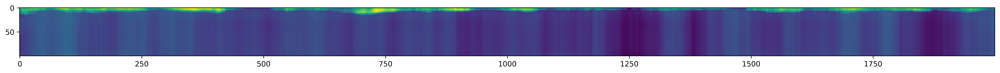

In [18]:
n=6
out = outputs[100,:,:,n].permute(1,0).cpu().detach().numpy()
out[out<=0] = np.min(out[out>0])
import matplotlib.pyplot as plt
from matplotlib.colors import LogNorm
fig = plt.figure(figsize=(24,24), dpi=600)
plt.imshow(out)#, norm=LogNorm(.0001,.5))
#plt.imshow(inputs[0,100,:,:,n].cpu().detach().numpy())
#fig.savefig('label.png')  # Replace 'output.png' with your desired file path and format

#field_names[n]
#plt.colorbar()

orig_error = np.abs(np.mean(inputs[0,:,:,:,n].cpu().detach().numpy()) - np.mean(labels[:,:,:,n].cpu().detach().numpy()))

nn_error = np.abs(np.mean(outputs[:,:,:,n].cpu().detach().numpy()) - np.mean(labels[:,:,:,n].cpu().detach().numpy()))
print (orig_error, nn_error)

In [ ]:
np.max(out)

In [ ]:
# Number of time steps and features to extract
#file_path = '/mnt/data/high_losing_42_11_1xscale.h5'
import h5py
import cv2
import numpy as np
import pandas as pd
import os
import sklearn
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
from sklearn.pipeline import make_pipeline
from sklearn.preprocessing import StandardScaler
from sklearn.ensemble import RandomForestRegressor

base_dir = '/home/mbadhan/Desktop/mberghouse/PFLOTRAN/one_deeper/input_files/'
f_dir = os.listdir(base_dir)
h5_files = []
h5_files_train = []

# Iterate over all files in the directory
for filename in f_dir:
    if (filename.endswith(".h5")) & ((("2x" in filename))):
        h5_files_train.append(base_dir+filename)
#     if (filename.endswith(".h5")) & (("8x" in filename)):
#         if (("10_5" not in filename) & ("20_20" not in filename)):
#             h5_files_train.append(base_dir+filename)
    if (filename.endswith(".h5")) & ((("10x" in filename))):
#         if (("10_5" in filename) | ("20_20" in filename)):
        h5_files.append(base_dir+filename)
# Run the processing in parallel
h5_files_train =  sorted(
    h5_files_train,
    key=lambda x: tuple(map(int, x.split('high_losing_')[1].split('_')[:2]))
)
h5_files =  sorted(
    h5_files,
    key=lambda x: tuple(map(int, x.split('high_losing_')[1].split('_')[:2]))
)

h5_files_test = h5_files[20:21]
h5_files_train_test = h5_files_train[20:21]
hdf5_file = h5py.File(h5_files_test[0], 'r')
# Fetching the first five time steps
time_steps = sorted(list(hdf5_file.keys()))

# Inspecting the features present in each of these time steps
features_per_time_step = {time_step: list(hdf5_file[time_step].keys()) for time_step in time_steps}


num_time_steps = 115
num_features = 9  # As observed from the dataset

# Initialize the final array with the desired shape [5, 100, 200, 19]
y_test = np.zeros((len(h5_files_test),num_time_steps-1, 100, 2000, num_features))

# Extracting and reshaping data from the first five time steps
for i in range(len(h5_files_test)):
    hdf5_file = h5py.File(h5_files_test[i], 'r')
    for t_idx, time_step in enumerate(time_steps[2:]):  # Skipping the first two non-time-step groups
        count=0
        for f_idx, feature in enumerate(features_per_time_step[time_step]):
            if ('O2' not in feature)& ('Perm' not in feature)& ('Material' not in feature)& ('Sat' not in feature)& ('Z' not in feature)& ('biocide' not in feature)& ('ethanol' not in feature)& ('Chubbite' not in feature):
                dataset = hdf5_file[time_step][feature]
                y_test[i, t_idx, :, :, count] = dataset[:, :, 0]#cv2.resize(dataset[:, :, 0], [500,50])  # Reshape and assign
                count = count+1

# Checking the shape of the extracted data array


x_test = np.zeros((len(h5_files_train_test),num_time_steps-1, 100, 400, num_features))

# Extracting and reshaping data from the first five time steps
for i in range(len(h5_files_train_test)):
    hdf5_file = h5py.File(h5_files_train_test[i], 'r')
    for t_idx, time_step in enumerate(time_steps[2:]):  # Skipping the first two non-time-step groups
        count=0
        for f_idx, feature in enumerate(features_per_time_step[time_step]):
            if ('O2' not in feature)& ('Perm' not in feature)& ('Material' not in feature)& ('Sat' not in feature)& ('Z' not in feature)& ('biocide' not in feature)& ('ethanol' not in feature)& ('Chubbite' not in feature):
                dataset = hdf5_file[time_step][feature]
                x_test[i, t_idx, :, :, count] = dataset[:, :, 0]#cv2.resize(dataset[:, :, 0], [500,50])  # Reshape and assign
                count = count+1

In [ ]:
#torch.save(model, 'model')
#torch.save(model.state_dict(), 'model_weights2')
x_test.shape


In [ ]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

model = UNet(n_channels=100, n_classes=9).to(device)


In [ ]:
model_weights_path = 'weights_att'

# Load the model's state dictionary (weights)
model1.load_state_dict(torch.load(model_weights_path))
model1

In [ ]:
scales=[[-3.8411125549317013, 597.4671440974266],
 [-615.1042997637863, 357.84820748247256],
 [0.0, 6822.169871757096],
 [0.0001, 0.6],
 [7.788525219135888, 15.024872883573318],
 [9.998195511764697e-21, 0.0021615209557147423],
 [9.992418077905442e-21, 0.00019222389277486797],
 [1e-10, 353.88041919640534],
 [9.999999999999992e-21, 4.945182939521276]]

for i in range(x_test.shape[4]):
    xmin = scales[i][0]
    xmax = scales[i][1]
    x_test[:,:,:,:,i] = (x_test[:,:,:,:,i] - xmin)/(xmax-xmin)
    y_test[:,:,:,:,i] = (y_test[:,:,:,:,i] - xmin)/(xmax-xmin)
scales

In [ ]:
for i in range(x_test.shape[4]):
    xmin = scales[i][0]
    xmax = scales[i][1]
    x_test[:,:,:,:,i] = (x_test[:,:,:,:,i] - xmin)/(xmax-xmin)
    y_test[:,:,:,:,i] = (y_test[:,:,:,:,i] - xmin)/(xmax-xmin)
    #scales.append([xmin,xmax])
y_test[0,100,0,:,7]

In [ ]:
test_dataset = CustomDataset(x_test, y_test)
test_loader = DataLoader(test_dataset, batch_size=1, shuffle=False)  # Adjust batch size as needed

# Define a loss function if needed (e.g., for validation)
criterion = nn.MSELoss()  # Replace with your loss function if needed

# Lists to store predictions and true labels
all_predictions = []
all_true_labels = []

model1.eval()
# Iterate through the test data
with torch.no_grad():
    for inputs, labels in test_loader:
        inputs = inputs.to(device)
        labels = labels.to(device)
        labels = labels[0,:,:,:,:].permute(0,2,1,3)
        # Forward pass
        outputs = model1(inputs)
        all_predictions.append(output.cpu().detach().numpy())
        all_labels.append(labels.cpu().detach().numpy())
        # If you have a loss function, compute the loss (optional)
        loss = criterion(outputs, labels)
        print (loss)


# Calculate accuracy (or other evaluation metrics)


In [ ]:
n=7
import matplotlib.pyplot as plt
from matplotlib.colors import LogNorm
fig = plt.figure(figsize=(24,24), dpi=600)
val = outputs[100,:,:,n].permute(1,0).cpu().detach().numpy()
plt.imshow(val)
#plt.imshow(inputs[0,100,:,:,n].cpu().detach().numpy())
#fig.savefig('label_test.png')  # Replace 'output.png' with your desired file path and format

field_names[n]

In [ ]:
n=7

orig_error = np.abs(np.mean(inputs[0,:,:,:,n].cpu().detach().numpy()) - np.mean(labels[:,:,:,n].cpu().detach().numpy()))

nn_error = np.abs(np.mean(outputs[:,:,:,n].cpu().detach().numpy()) - np.mean(labels[:,:,:,n].cpu().detach().numpy()))
print (orig_error, nn_error)

In [ ]:
print (orig_error, nn_error)

In [ ]:
scales=[[-3.8411125549317013, 597.4671440974266],
 [-615.1042997637863, 357.84820748247256],
 [0.0, 6822.169871757096],
 [0.0001, 0.6],
 [7.788525219135888, 15.024872883573318],
 [9.998195511764697e-21, 0.0021615209557147423],
 [9.992418077905442e-21, 0.00019222389277486797],
 [1e-10, 353.88041919640534],
 [9.999999999999992e-21, 4.945182939521276]]
scales

In [ ]:
import numpy as np

def calculate_divergence(vx, vy, dx, dy):
    """
    Calculate the divergence of a 2D velocity field using a forward-looking finite difference scheme.
    
    Parameters:
    vx: 2D array of velocity in the x-direction
    vy: 2D array of velocity in the y-direction
    dx: Grid spacing in the x-direction
    dy: Grid spacing in the y-direction
    
    Returns:
    divergence: 2D array of divergence values
    """
    # Get the dimensions of the velocity field
    rows, cols = vx.shape

    # Initialize an array to store divergence
    divergence = np.zeros((rows, cols))

    # Calculate divergence using forward differences
    # For the edges, we use backward differences to avoid index out of range
    for i in range(rows):
        for j in range(cols):
            dvx_dx = (vx[i, min(j+1, cols-1)] - vx[i, j]) / dx
            dvy_dy = (vy[min(i+1, rows-1), j] - vy[i, j]) / dy
            divergence[i, j] = dvx_dx + dvy_dy

    return divergence

# Example usage with dummy data
# Create sample velocity fields
#vx = outputs[100,:,:,0].permute(1,0).cpu().detach().numpy()

#vy = outputs[100,:,:,1].permute(1,0).cpu().detach().numpy()


# Assume uniform grid spacing
#dx = 1  # x-spacing
#dy = 1  # y-spacing

# Calculate divergence
#divergence = calculate_divergence(vx, vy, dx, dy)
#divergence


In [ ]:
mse=nn.MSELoss()

In [ ]:
mse(1,1)

In [ ]:
scales_train=[]
for i in h5_files_train:
    if 'high_gaining' in i:
        scales_train.append(i.split('_')[7][0])
    else:
        scales_train.append(i.split('_')[6][0])
    
scales=[]
for i in h5_files:
    if 'high_gaining' in i:
        scales.append(i.split('_')[7][0])
    else:
        scales.append(i.split('_')[6][0])
scales

In [ ]:
import h5py
import cv2

base_dir = '/home/mbadhan/Desktop/mberghouse/PFLOTRAN/one_deeper/input_files/'
f_dir = os.listdir(base_dir)
h5_files = []
h5_files_train = []

# Iterate over all files in the directory
for filename in f_dir:
    if (filename.endswith(".h5")) & ((("2x" in filename))):
        h5_files_train.append(base_dir+filename)
#     if (filename.endswith(".h5")) & (("8x" in filename)):
#         if (("10_5" not in filename) & ("20_20" not in filename)):
#             h5_files_train.append(base_dir+filename)
    if (filename.endswith(".h5")) & ((("10x" in filename))):
#         if (("10_5" in filename) | ("20_20" in filename)):
        h5_files.append(base_dir+filename)
# Run the processing in parallel
h5_files_train =  sorted(
    h5_files_train,
    key=lambda x: tuple(map(int, x.split('high_losing_')[1].split('_')[:2]))
)
h5_files =  sorted(
    h5_files,
    key=lambda x: tuple(map(int, x.split('high_losing_')[1].split('_')[:2]))
)

perm_covar=[]
for i in h5_files_train:
    if 'high_gaining' in i:
        perm_covar.append(int(i.split('_')[5])/int(i.split('_')[6]))
    else:
        perm_covar.append(int(i.split('_')[4])/int(i.split('_')[5]))
perm_covar    

In [ ]:
perm_covar=[]
for i in h5_files_train:
    if 'high_gaining' in i:
        perm_covar.append(int(i.split('_')[5])/int(i.split('_')[6]))
    else:
        perm_covar.append(int(i.split('_')[4])/int(i.split('_')[5]))
perm_covar   

max_l=[]
for i in h5_files_train:
    if 'high_gaining' in i:
        max_l.append(np.max([int(i.split('_')[5]),int(i.split('_')[6])]))
    else:
        max_l.append(np.max([int(i.split('_')[4]),int(i.split('_')[5])]))
max_l

growth_rates=[]
rate_c=[]
rate_d=[]
exp_b = []
for i in range(len(h5_files)):
    file_path = h5_files[i][:-3]+'.in'
    #print (file_path)
    with open(file_path, 'r') as file:
        lines = file.readlines()
    gr = float(lines[79].split()[1].replace('d', 'e'))
    c = float(lines[81].split()[1].replace('d', 'e'))
    d = float(lines[94].split()[1].replace('d', 'e'))
    b = float(lines[65].split()[1])
    growth_rates.append(gr)
    rate_c.append(c)
    rate_d.append(d)
    exp_b.append(b)


tags =[rate_c, rate_d, exp_b, max_l, perm_covar, growth_rates]
count=0
tag_scales = []
for i in tags:
    xmax = np.max(i)
    xmin = np.min(i)
    tags[count] = (i-xmin)/(xmax-xmin)
    tag_scales.append([xmin, xmax])
    count = count+1

tags_small = np.zeros([6,114,100,400,1)
for i in range(len(h5_files)):
    tags_small[i,:,0:16, :, :] = torch.full((1,114,16,400,1),tags[0][i])
    tags_small[i,:,16:32, :, :] = torch.full((1,114,16,400,1),tags[1][i])
    tags_small[i,:,32:48, :, :] = torch.full((1,114,16,400,1),tags[2][i])
    tags_small[i,:,48:64, :, :] = torch.full((1,114,16,400,1),tags[3][i])
    tags_small[i,:,64:80, :, :] = torch.full((1,114,16,400,1),tags[4][i])
    tags_small[i,:,80:, :, :] = torch.full((1,114,20,400,1),tags[5][i])

tags_big = torch.copy(tags_small)

In [ ]:


tags =[rate_c, rate_d, exp_b, max_l, perm_covar, growth_rates]
count=0
tag_scales = []
for i in tags:
    xmax = np.max(i)
    xmin = np.min(i)
    tags[count] = (i-xmin)/(xmax-xmin)
    tag_scales.append([xmin, xmax])
    count = count+1


In [ ]:
tags_small = np.zeros([6,114,100,400,1)
for i in range(len(h5_files)):
    tags_small[i,:,0:16, :, :] = torch.full((1,114,16,400,1),tags[0][i])
    tags_small[i,:,16:32, :, :] = torch.full((1,114,16,400,1),tags[1][i])
    tags_small[i,:,32:48, :, :] = torch.full((1,114,16,400,1),tags[2][i])
    tags_small[i,:,48:64, :, :] = torch.full((1,114,16,400,1),tags[3][i])
    tags_small[i,:,64:80, :, :] = torch.full((1,114,16,400,1),tags[4][i])
    tags_small[i,:,80:, :, :] = torch.full((1,114,20,400,1),tags[5][i])

tags_big = torch.copy(tags_small)
#torch.concat(x,tags_small)

In [ ]:
for i in range(len(dfs)):
    print (i,len(dfs_train[i]))

In [ ]:
h5_files

In [ ]:
import numpy as np
for i in range(len(dfs)):
    #rate b_1 (growth rate)
    #rate_c
    #exp_b
    #rate d_1 (carbon reuse)
    dfs[i]['sim_id']=i
    #dfs[i]['scale']=scales[i]
   # if 'gaining' in h5_files[i]:
   #     dfs[i]['type_id']=0
   # if 'high_gaining' in h5_files[i]:
   #     dfs[i]['type_id']=1
   # if 'losing' in h5_files[i]:
   #     dfs[i]['type_id']=2
   # if 'highlosing' in h5_files[i]:
   #     dfs[i]['type_id']=3
    dfs[i]['perm_covar']=perm_covar[i]
    dfs[i]['max_l']=max_l[i]
    perm_values = dfs[i]["Permeability_X [m^2]"].values
    if perm_covar[i]>1:
        k_eff =np.mean(perm_values.size / np.sum(1.0 / perm_values))
    else:
        k_eff = np.mean(perm_values)

    #dfs[i]['k_eff']=k_eff
    dfs[i]['growth_rates']=growth_rates[i]
    dfs[i]['rate_c']=rate_c[i]
    dfs[i]['rate_d']=rate_d[i]
    dfs[i]['exp_b']=exp_b[i]

for i in range(len(dfs_train)):
    dfs_train[i]['sim_id']=i
    #dfs_train[i]['scale']=scales_train[i]
    #if 'gaining' in h5_files[i]:
    #    dfs_train[i]['type_id']=0
    #if 'high_gaining' in h5_files[i]:
        #print (i[1].fname)
    #    dfs_train[i]['type_id']=1
    #if 'losing' in h5_files[i]:
    #    dfs_train[i]['type_id']=2
    #if 'highlosing' in h5_files[i]:
    #    dfs_train[i]['type_id']=3
#     if i >= 33:
#         dfs[i]['sim_id']=4
#     dfs[i]['sim_id2']=i
    
    dfs_train[i]['perm_covar']=perm_covar[i]
#     dfs[i]['gaining']=gaining[i]
#     dfs[i]['losing']=losing[i]
    dfs_train[i]['max_l']=max_l[i]
    #dfs[i]['NL']=NL[i]
    perm_values = dfs_train[i]["Permeability_X [m^2]"].values
    #if perm_covar[i]>1:
    #    k_eff =np.mean(perm_values.size / np.sum(1.0 / perm_values))
    #else:
    #    k_eff = np.mean(perm_values)

    #dfs_train[i]['k_eff']=k_eff
    #dfs_train[i]['k_eff']=k_eff
    dfs_train[i]['growth_rates']=growth_rates[i]
    dfs_train[i]['rate_c']=rate_c[i]
    dfs_train[i]['rate_d']=rate_d[i]
    dfs_train[i]['exp_b']=exp_b[i]
    

combined_df = pd.concat(dfs)
combined_df_train = pd.concat(dfs_train)
combined_df
final_data = np.array(combined_df)
final_data_train = np.array(combined_df_train)
x = np.delete(final_data_train, [1,2,5,7,8,15,16], 1)
target = np.delete(final_data, [1,2,5,7,8,15,16], 1)
 
#x_test = np.delete(final_data_train, [1,2,5,7,8,14,15,16,19], 1)
# #target = np.delete(final_data, [1,2,5,7,8,14,15,16,19], 1)
# #x = np.delete(final_data, [3, 5, 6, 11, 12, 13, 16,17,18,19], 1)
# y_train = final_data_train[:, 13]
# y_test = final_data[:, 13]
print (x.shape, target.shape)

In [ ]:
dfs_train[0].iloc[1,9:]


In [ ]:
dfs_train[0]

In [31]:
import torch
import torch.nn as nn

def dtw_distance(seq1, seq2):
    """
    Compute the dynamic time warping distance between two sequences.
    
    Args:
    - seq1: First sequence of shape (T1, W, H)
    - seq2: Second sequence of shape (T2, W, H)
    
    Returns:
    - dtw_dist: Dynamic time warping distance
    """
    T1, T2 = seq1.size(0), seq2.size(0)
    W, H = seq1.size(1), seq1.size(2)
    
    # Initialize DP table
    dp = torch.zeros((T1 + 1, T2 + 1)) + float('inf')
    dp[0, 0] = 0
    
    # Dynamic programming
    for i in range(1, T1 + 1):
        for j in range(1, T2 + 1):
            cost = torch.norm(seq1[i - 1] - seq2[j - 1])
            dp[i, j] = cost + torch.min(dp[i - 1, j], dp[i, j - 1], dp[i - 1, j - 1])
    
    dtw_dist = dp[T1, T2]  # Final DTW distance
    
    return dtw_dist

class DTWLoss(nn.Module):
    def __init__(self):
        super(DTWLoss, self).__init__()

    def forward(self, input, target):
        """
        Compute the DTW loss between the input and target sequences.
        
        Args:
        - input: Input sequence of shape (B, T, W, H)
        - target: Target sequence of shape (B, T, W, H)
        
        Returns:
        - loss: DTW loss
        """
        batch_size, seq_len, _, _ = input.size()
        total_loss = 0
        
        for i in range(batch_size):
            input_seq = input[i]
            target_seq = target[i]
            dtw_dist = dtw_distance(input_seq, target_seq)
            total_loss += dtw_dist
        
        loss = total_loss / batch_size
        
        return loss

# Example usage:
# Assuming input_data and target_data are your spatio-temporal time series data
# input_data.shape = (batch_size, sequence_length, width, height)
# target_data.shape = (batch_size, sequence_length, width, height)

# Instantiate the DTW loss
criterion = DTWLoss()

# Generate example input and target data
input_data = torch.randn(10, 114, 100, 400)  # Example input data
target_data = torch.randn(10, 114, 100, 400)  # Example target data

# Calculate the loss
loss = criterion(input_data, target_data)

# Use the loss to update your neural network
# optimizer.zero_grad()
# loss.backward()
# optimizer.step()


TypeError: min() received an invalid combination of arguments - got (Tensor, Tensor, Tensor), but expected one of:
 * (Tensor input, *, Tensor out)
      didn't match because some of the arguments have invalid types: (Tensor, !Tensor!, Tensor)
 * (Tensor input, Tensor other, *, Tensor out)
 * (Tensor input, int dim, bool keepdim, *, tuple of Tensors out)
 * (Tensor input, name dim, bool keepdim, *, tuple of Tensors out)


In [33]:
import torch
import torch.nn as nn

def dtw_distance(seq1, seq2):
    """
    Compute the dynamic time warping distance between two sequences.
    
    Args:
    - seq1: First sequence of shape (T1, W, H)
    - seq2: Second sequence of shape (T2, W, H)
    
    Returns:
    - dtw_dist: Dynamic time warping distance
    """
    T1, T2 = seq1.size(0), seq2.size(0)
    W, H = seq1.size(1), seq1.size(2)
    
    # Initialize DP table
    dp = torch.zeros((T1 + 1, T2 + 1)) + float('inf')
    dp[0, 0] = 0
    
    # Dynamic programming
    for i in range(1, T1 + 1):
        for j in range(1, T2 + 1):
            cost = torch.norm(seq1[i - 1] - seq2[j - 1], p=2)  # Euclidean distance
            dp[i, j] = cost + torch.min(torch.stack([dp[i - 1, j], dp[i, j - 1], dp[i - 1, j - 1]]))
    
    dtw_dist = dp[T1, T2]  # Final DTW distance
    
    return dtw_dist

class DTWLoss(nn.Module):
    def __init__(self):
        super(DTWLoss, self).__init__()

    def forward(self, input, target):
        """
        Compute the DTW loss between the input and target sequences.
        
        Args:
        - input: Input sequence of shape (B, T, W, H)
        - target: Target sequence of shape (B, T, W, H)
        
        Returns:
        - loss: DTW loss
        """
        batch_size, seq_len, _, _ = input.size()
        total_loss = 0
        
        for i in range(batch_size):
            input_seq = input[i]
            target_seq = target[i]
            dtw_dist = dtw_distance(input_seq, target_seq)
            total_loss += dtw_dist
        
        loss = total_loss / batch_size
        
        return loss

# Example usage:
# Assuming input_data and target_data are your spatio-temporal time series data
# input_data.shape = (batch_size, sequence_length, width, height)
# target_data.shape = (batch_size, sequence_length, width, height)

# Instantiate the DTW loss
criterion = DTWLoss()

# Generate example input and target data
input_data = torch.randn(10, 114, 100, 400)  # Example input data
target_data = torch.randn(10, 114, 100, 400)  # Example target data

# Calculate the loss
loss = criterion(input_data, target_data)

# Use the loss to update your neural network
# optimizer.zero_grad()
# loss.backward()
# optimizer.step()


In [34]:
loss

tensor(32242.4688)

In [14]:
import geopandas as gpd
from shapely.geometry import Point
from pysal.explore import esda
import numpy as np

# Define the number of rows and columns
n_rows = 100
n_cols = 2000

# Create a list to hold the Point geometries and random values for the variable of interest
points = []
variable_values = []

# Create Point objects and generate random values for the variable of interest
for y in range(n_rows):
    for x in range(n_cols):
        point = Point(x, y)  # Assuming dx = dy = 1
        points.append(point)
        value = np.random.rand()  # Generate a random value for the variable of interest
        variable_values.append(value)

# Create a GeoDataFrame from the list of Point geometries and variable values
gdf = gpd.GeoDataFrame(geometry=points)
gdf['variable'] = variable_values  # Add a new column for the variable of interest

# Save the GeoDataFrame as a shapefile
gdf.to_file("positions.shp")


data = gpd.read_file("positions.shp")

# Assuming you have a variable of interest, let's call it 'variable'
variable = data['variable']

# Create a spatial weights matrix
w = esda.weights.KNN.from_dataframe(data, k=4)

# Moran's I calculation
mi = esda.Moran(variable, w)

# LISA calculation
lisa = esda.Moran_Local(variable, w)

# Plot LISA cluster map
gpd.GeoDataFrame(
    {'LISA Cluster': lisa.q, 'p-value': lisa.p_sim},
    geometry=data.geometry
).plot(column='LISA Cluster', cmap='coolwarm', legend=True)

plt.title('LISA Cluster Map')
plt.show()

C:\Users\marcb\anaconda3\Lib\site-packages\spaghetti\network.py:42: FutureWarning: The next major release of pysal/spaghetti (2.0.0) will drop support for all ``libpysal.cg`` geometries. This change is a first step in refactoring ``spaghetti`` that is expected to result in dramatically reduced runtimes for network instantiation and operations. Users currently requiring network and point pattern input as ``libpysal.cg`` geometries should prepare for this simply by converting to ``shapely`` geometries.
  warnings.warn(dep_msg, FutureWarning, stacklevel=1)


AttributeError: module 'esda' has no attribute 'weights'

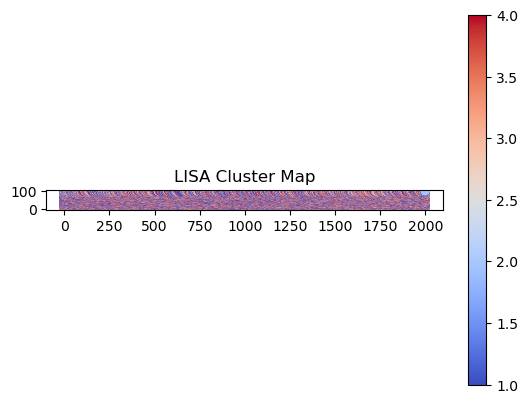

In [19]:
import libpysal as lps
w =lps.weights.KNN.from_shapefile("positions.shp", k=4)

# Moran's I calculation
mi = esda.Moran(variable, w)

# LISA calculation
lisa = esda.Moran_Local(variable, w)

# Plot LISA cluster map
gpd.GeoDataFrame(
    {'LISA Cluster': lisa.q, 'p-value': lisa.p_sim},
    geometry=data.geometry
).plot(column='LISA Cluster', cmap='coolwarm', legend=True)

plt.title('LISA Cluster Map')
plt.show()